<font size="6"> <div class="alert alert-block alert-info"> **A2Z Insurance** </div> </font> 

  <font size="6"> Group AB </font>

|      |     Student Name     |     Student ID     | 
|---   |         ---          |           ---          |
| 1    |      Carolina Mira        |       20220553         | 
| 2    |      Catarina Alves        |       20220680         |
| 3    |      Rita Silva        |       20220544         | 


# Import Libraries ##

In [345]:
#!pip install sas7bdat

In [4]:
from os.path import join
import pandas as pd
import numpy as np
from sas7bdat import SAS7BDAT
from pandas_profiling import ProfileReport
import seaborn as sns
import matplotlib.pyplot as plt
from math import ceil
from sklearn.impute import KNNImputer
import os
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder
from factor_analyzer import FactorAnalyzer
from factor_analyzer.factor_analyzer import calculate_bartlett_sphericity
from factor_analyzer.factor_analyzer import calculate_kmo
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import pairwise_distances
from scipy.cluster.hierarchy import dendrogram
import matplotlib.cm as cm
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.cluster import KMeans
from sklearn.base import clone

#For Pandas Profiling
#!pip install jupyter_contrib_nbextensions

#import sompy
#from sompy.visualization.mapview import View2D
#from sompy.visualization.bmuhits import BmuHitsView
#from sompy.visualization.hitmap import HitMapView

from sklearn.mixture import GaussianMixture
from sklearn.cluster import MeanShift, DBSCAN, estimate_bandwidth
from sklearn.neighbors import NearestNeighbors

from matplotlib import __version__ as mplver


from sklearn.manifold import TSNE
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.model_selection import train_test_split
import graphviz


In [5]:
pd.set_option('display.max_rows',15000)

# Read Dataset ##

In [348]:
#read dataset from SAS7BDAT
with SAS7BDAT('a2z_insurance.sas7bdat', skip_header = False) as reader:
    df = reader.to_data_frame()

In [349]:
df.head()

,CustID,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
0,1.0,1985.0,1982.0,2 - High School,2177.0,1.0,1.0,380.97,0.39,375.85,79.45,146.36,47.01,16.89
1,2.0,1981.0,1995.0,2 - High School,677.0,4.0,1.0,-131.13,1.12,77.46,416.20,116.69,194.48,106.13
2,3.0,1991.0,1970.0,1 - Basic,2277.0,3.0,0.0,504.67,0.28,206.15,224.50,124.58,86.35,99.02
3,4.0,1990.0,1981.0,3 - BSc/MSc,1099.0,4.0,1.0,-16.99,0.99,182.48,43.35,311.17,35.34,28.34
4,5.0,1986.0,1973.0,3 - BSc/MSc,1763.0,4.0,1.0,35.23,0.90,338.62,47.80,182.59,18.78,41.45


# Data Exploration ##

## Explore Dataset

In [350]:
#check df shape: 10296 rows and 14 columns
df.shape

(10296, 14)

In [351]:
#check df columns
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10296 entries, 0 to 10295
Data columns (total 14 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   CustID         10296 non-null  float64
 1   FirstPolYear   10266 non-null  float64
 2   BirthYear      10279 non-null  float64
 3   EducDeg        10296 non-null  object 
 4   MonthSal       10260 non-null  float64
 5   GeoLivArea     10295 non-null  float64
 6   Children       10275 non-null  float64
 7   CustMonVal     10296 non-null  float64
 8   ClaimsRate     10296 non-null  float64
 9   PremMotor      10262 non-null  float64
 10  PremHousehold  10296 non-null  float64
 11  PremHealth     10253 non-null  float64
 12  PremLife       10192 non-null  float64
 13  PremWork       10210 non-null  float64
dtypes: float64(13), object(1)
memory usage: 1.1+ MB


## Descriptive Statistics

In [352]:
#check summary statistics for numerical variables
df.describe().T

,count,mean,std,min,25%,50%,75%,max
CustID,10296.0,5148.500000,2972.343520,1.00,2574.75,5148.50,7722.2500,10296.00
FirstPolYear,10266.0,1991.062634,511.267913,1974.00,1980.00,1986.00,1992.0000,53784.00
BirthYear,10279.0,1968.007783,19.709476,1028.00,1953.00,1968.00,1983.0000,2001.00
MonthSal,10260.0,2506.667057,1157.449634,333.00,1706.00,2501.50,3290.2500,55215.00
GeoLivArea,10295.0,2.709859,1.266291,1.00,1.00,3.00,4.0000,4.00
Children,10275.0,0.706764,0.455268,0.00,0.00,1.00,1.0000,1.00
CustMonVal,10296.0,177.892605,1945.811505,-165680.42,-9.44,186.87,399.7775,11875.89
ClaimsRate,10296.0,0.742772,2.916964,0.00,0.39,0.72,0.9800,256.20
PremMotor,10262.0,300.470252,211.914997,-4.11,190.59,298.61,408.3000,11604.42
PremHousehold,10296.0,210.431192,352.595984,-75.00,49.45,132.80,290.0500,25048.80


In [353]:
#check summary statistics for categorical variables
df.describe(include = ['O']).T

,count,unique,top,freq
EducDeg,10296,5,3 - BSc/MSc,4799


In [354]:
#Generate the report. We would use the mpg dataset as sample, title parameter for naming our report, and explorative parameter set to True for Deeper exploration.
#profile = ProfileReport(df, title='MPG Pandas Profiling Report', explorative = True)
#profile

## Missing values

In [355]:
#check for missing values 
df.isnull().any()

CustID           False
FirstPolYear      True
BirthYear         True
EducDeg          False
MonthSal          True
GeoLivArea        True
Children          True
CustMonVal       False
ClaimsRate       False
PremMotor         True
PremHousehold    False
PremHealth        True
PremLife          True
PremWork          True
dtype: bool

In [356]:
#check for % of missing values
for col in df.columns:
    miss=np.mean(df[col].isnull())
    print('{}-{}%'.format(col,round(miss*100)))

CustID-0%
FirstPolYear-0%
BirthYear-0%
EducDeg-0%
MonthSal-0%
GeoLivArea-0%
Children-0%
CustMonVal-0%
ClaimsRate-0%
PremMotor-0%
PremHousehold-0%
PremHealth-0%
PremLife-1%
PremWork-1%


### Find Na's and Empty values

In [357]:
#give values to the different Education levels to find the empty values.
conditions = [
    (df['EducDeg'] == "1 - Basic"),
    (df['EducDeg'] == "2 - High School"),
    (df['EducDeg'] == "3 - BSc/MSc"),
    (df['EducDeg'] == "4 - PhD")
]

values = ['Basic', 'High_School', 'BSc/MSc', 'PhD']

df['EducDeg'] = np.select(conditions, values)


In [358]:
#there are 17 rwos with empty values in EducDeg
#df[(df['EducDeg'] != 'Basic') & (df['EducDeg'] != 'High_School') & (df['EducDeg'] != 'BSc/MSc') & (df['EducDeg'] != 'PhD')]  

In [359]:
df = df[df['EducDeg'] != '0']

In [360]:
df.isnull().sum()

CustID             0
FirstPolYear      15
BirthYear         17
EducDeg            0
MonthSal          35
GeoLivArea         1
Children          21
CustMonVal         0
ClaimsRate         0
PremMotor         34
PremHousehold      0
PremHealth        42
PremLife         104
PremWork          85
dtype: int64

### Treat Missing Values

* Median

In [361]:
# Creating a copy to apply central tendency measures imputation
df_central = df.copy()

In [362]:
# count of missing values
df_central.isna().sum()

CustID             0
FirstPolYear      15
BirthYear         17
EducDeg            0
MonthSal          35
GeoLivArea         1
Children          21
CustMonVal         0
ClaimsRate         0
PremMotor         34
PremHousehold      0
PremHealth        42
PremLife         104
PremWork          85
dtype: int64

In [363]:
df_central.median(numeric_only=True)
# Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated

CustID           5147.00
FirstPolYear     1986.00
BirthYear        1968.00
MonthSal         2500.00
GeoLivArea          3.00
Children            1.00
CustMonVal        186.71
ClaimsRate          0.72
PremMotor         298.61
PremHousehold     132.80
PremHealth        162.81
PremLife           25.56
PremWork           25.67
dtype: float64

In [364]:
df_central.fillna(df_central.median(numeric_only=True), inplace=True)
df_central.isna().sum() 

CustID           0
FirstPolYear     0
BirthYear        0
EducDeg          0
MonthSal         0
GeoLivArea       0
Children         0
CustMonVal       0
ClaimsRate       0
PremMotor        0
PremHousehold    0
PremHealth       0
PremLife         0
PremWork         0
dtype: int64

* Knn

In [365]:
#using knn algorithm to fill missing values

In [366]:
df_neighbors = df.loc[:, df.columns != 'EducDeg']

In [367]:
# KNNImputer - only works for numerical varaibles
imputer = KNNImputer(n_neighbors=5)
df_neighbors = pd.DataFrame(imputer.fit_transform(df_neighbors), columns = df_neighbors.columns)

In [368]:
df_neighbors.isnull().sum()

CustID           0
FirstPolYear     0
BirthYear        0
MonthSal         0
GeoLivArea       0
Children         0
CustMonVal       0
ClaimsRate       0
PremMotor        0
PremHousehold    0
PremHealth       0
PremLife         0
PremWork         0
dtype: int64

In [369]:
df_tmv = df_neighbors

In [370]:
df_tmv.shape

(10279, 13)

## Duplicated values

In [371]:
df_tmv.count()

CustID           10279
FirstPolYear     10279
BirthYear        10279
MonthSal         10279
GeoLivArea       10279
Children         10279
CustMonVal       10279
ClaimsRate       10279
PremMotor        10279
PremHousehold    10279
PremHealth       10279
PremLife         10279
PremWork         10279
dtype: int64

In [372]:
'''for col in df_tmv:
    print("________________________")
    print(col, df_tmv[col].value_counts().count(), "unique values")
    print("________________________")
    print(df_tmv[col].value_counts())'''

'for col in df_tmv:\n    print("________________________")\n    print(col, df_tmv[col].value_counts().count(), "unique values")\n    print("________________________")\n    print(df_tmv[col].value_counts())'

In [373]:
#check for duplicate values
df_tmv[df_tmv.duplicated()]

,CustID,FirstPolYear,BirthYear,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork


In [374]:
df_tmv.duplicated().sum()
#we conclude that there are no duplicate values

0

## Outliers

### Boxplots 

In [375]:
#select numerical variables
'''metric_features = ['MonthSal','CustMonVal',
                   'ClaimsRate','PremMotor','PremHousehold',
                  'PremHealth','PremLife','PremWork']


#numeric variables' Box Plots to check for outliers
sns.set()

#plot data
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

for ax, feat in zip(axes.flatten(), metric_features):
    sns.boxplot(x=df_tmv[feat], ax=ax)

title = "Numeric Variables' Box Plots"

plt.suptitle(title)

plt.show()
plt.savefig(os.path.join('..', 'figures', 'boxplot.png'), dpi=200)'''


'metric_features = [\'MonthSal\',\'CustMonVal\',\n                   \'ClaimsRate\',\'PremMotor\',\'PremHousehold\',\n                  \'PremHealth\',\'PremLife\',\'PremWork\']\n\n\n#numeric variables\' Box Plots to check for outliers\nsns.set()\n\n#plot data\nfig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))\n\nfor ax, feat in zip(axes.flatten(), metric_features):\n    sns.boxplot(x=df_tmv[feat], ax=ax)\n\ntitle = "Numeric Variables\' Box Plots"\n\nplt.suptitle(title)\n\nplt.show()\nplt.savefig(os.path.join(\'..\', \'figures\', \'boxplot.png\'), dpi=200)'

### Remove Outliers - Manual filters

In [376]:
#manual way to solve the outliers
# We looked for the boxplot and made a limit where the observations will be dropped

* MonthSal

In [377]:
df_tmv[(df_tmv['MonthSal'] > 5667.5)].shape
#2 valores

(2, 13)

* CustMonVal 

In [378]:
q25 = df.quantile(.25)
q75 = df.quantile(.75)
iqr = (q75 - q25)

upper_lim = q75 + 1.5 * iqr
lower_lim = q25 - 1.5 * iqr

In [379]:
df_tmv.loc[(df_tmv['CustMonVal'] < lower_lim['CustMonVal']) | (df_tmv['CustMonVal'] > upper_lim['CustMonVal'])].sort_values(by='CustMonVal')

,CustID,FirstPolYear,BirthYear,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
171,172.0,1990.0,1989.0,1086.0,4.0,1.0,-165680.42,256.20,378.07,78.90,166.81,6.89,18.45
655,656.0,1974.0,1963.0,3279.0,3.0,1.0,-64891.00,96.00,410.30,117.25,95.35,37.34,22.56
675,676.0,1994.0,1937.0,4435.0,1.0,0.0,-52382.76,63.00,197.48,280.60,276.94,51.12,38.34
9631,9649.0,1990.0,1950.0,3574.0,3.0,0.0,-37327.08,69.00,319.06,-25.55,245.38,4.89,4.78
707,708.0,1991.0,1991.0,1634.0,1.0,1.0,-28945.40,35.00,175.70,319.50,294.39,44.12,16.89
916,918.0,1986.0,1952.0,3355.0,4.0,0.0,-26130.45,32.30,135.58,290.05,221.82,86.46,100.13
51,52.0,1982.0,1966.0,3234.0,4.0,1.0,-14714.08,25.36,557.44,20.00,29.56,5.00,-9.00
135,136.0,1997.0,1988.0,2176.0,4.0,1.0,-10198.91,14.80,297.61,162.80,143.36,136.47,-3.00
758,759.0,1988.0,1992.0,1117.0,1.0,1.0,-10107.37,12.60,193.37,342.85,276.94,8.78,47.23
112,113.0,1997.0,1979.0,2354.0,1.0,1.0,-8719.04,15.65,518.32,4.45,55.90,3.89,10.89


In [380]:
#vamos apagar os valores abaixo de -2082.83 e acima de 2054
#19 valores

In [381]:
df_tmv[(df_tmv['CustMonVal'] <= -2082.83) | (df_tmv['CustMonVal'] >= 2054.07)].sort_values(by='CustMonVal').shape


(19, 13)

* ClaimsRate

In [382]:
df_tmv.loc[(df_tmv['ClaimsRate'] < lower_lim['ClaimsRate']) | (df_tmv['ClaimsRate'] > upper_lim['ClaimsRate'])].sort_values(by='ClaimsRate')

,CustID,FirstPolYear,BirthYear,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
7951,7963.0,1975.0,1988.0,1868.0,1.0,1.0,-56.10,4.33,383.006,-15.55,164.098,12.89,12.00
1024,1026.0,1988.0,1939.0,4566.0,1.0,1.0,-2082.83,4.36,370.070,14.45,189.590,14.78,23.56
950,952.0,1998.0,1976.0,1586.0,3.0,1.0,-2642.91,5.60,501.650,-20.00,90.460,-1.00,-2.00
981,983.0,1989.0,1981.0,1771.0,3.0,1.0,-6115.85,9.87,83.350,98.35,336.840,74.68,93.46
758,759.0,1988.0,1992.0,1117.0,1.0,1.0,-10107.37,12.60,193.370,342.85,276.940,8.78,47.23
793,794.0,1980.0,1983.0,1370.0,3.0,1.0,-7851.17,13.90,127.580,48.35,398.410,19.56,12.78
135,136.0,1997.0,1988.0,2176.0,4.0,1.0,-10198.91,14.80,297.610,162.80,143.360,136.47,-3.00
112,113.0,1997.0,1979.0,2354.0,1.0,1.0,-8719.04,15.65,518.320,4.45,55.900,3.89,10.89
51,52.0,1982.0,1966.0,3234.0,4.0,1.0,-14714.08,25.36,557.440,20.00,29.560,5.00,-9.00
916,918.0,1986.0,1952.0,3355.0,4.0,0.0,-26130.45,32.30,135.580,290.05,221.820,86.46,100.13


In [383]:
df_tmv[(df_tmv['ClaimsRate'] > 35.0)].shape
#4 registos

(4, 13)

* PremMotor

In [384]:
df_tmv[(df_tmv['PremMotor'] > 734.865)].shape
#6 valores

(6, 13)

* PremHousehold

In [385]:
df_tmv.loc[(df_tmv['PremHousehold'] < lower_lim['PremHousehold']) | (df_tmv['PremHousehold'] > upper_lim['PremHousehold'])].sort_values(by='PremHousehold')

,CustID,FirstPolYear,BirthYear,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
8920,8935.0,1974.0,1949.0,3727.0,1.0,0.0,-236.93,1.19,78.68,652.35,97.240,211.930,69.790
8798,8813.0,1995.0,1988.0,1296.0,3.0,1.0,21.90,0.96,173.81,652.35,125.800,106.130,46.900
9326,9343.0,1991.0,1951.0,2933.0,4.0,1.0,284.28,0.72,212.93,653.45,161.030,17.780,78.570
2230,2233.0,1986.0,1990.0,607.0,4.0,1.0,228.38,0.78,77.57,653.45,186.590,175.810,35.340
3442,3449.0,1979.0,1993.0,1450.0,1.0,0.0,823.82,0.25,70.57,653.45,158.140,124.800,124.800
4526,4534.0,1976.0,1996.0,2408.0,4.0,0.0,698.24,0.34,83.35,653.45,162.810,187.590,13.560
9536,9553.0,1995.0,1996.0,1178.0,2.0,0.0,489.87,0.55,61.01,653.45,256.270,30.560,138.580
1915,1918.0,1994.0,1951.0,3004.0,1.0,0.0,71.02,0.91,149.03,653.45,92.130,155.140,59.120
2769,2775.0,1979.0,1998.0,508.0,4.0,1.0,360.28,0.66,62.01,654.00,90.350,162.030,168.700
5103,5111.0,1977.0,1995.0,1627.0,2.0,1.0,133.14,0.86,32.45,654.00,128.580,158.140,150.030


In [386]:
df_tmv[(df_tmv['PremHousehold'] >= 2223.75)].shape
#4 registos

(4, 13)

* PremHealth

In [387]:
df_tmv.loc[(df_tmv['PremHealth'] < lower_lim['PremHealth']) | (df_tmv['PremHealth'] > upper_lim['PremHealth'])].sort_values(by='PremHealth')

,CustID,FirstPolYear,BirthYear,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
5422,5430.0,1990.0,1982.0,1452.0,4.0,1.0,347.06,0.56,86.24,330.05,380.74,47.12,-5.11
391,392.0,1991.0,1952.0,3983.0,1.0,0.0,455.75,0.47,62.68,427.85,380.74,9.78,34.23
145,146.0,1983.0,1986.0,2554.0,1.0,1.0,-96.11,1.12,144.36,-11.10,381.85,47.23,12.78
6687,6697.0,1976.0,1943.0,4106.0,4.0,0.0,55.35,0.89,104.02,167.80,381.85,25.45,49.12
1231,1233.0,1995.0,1936.0,4061.0,1.0,0.0,9.56,0.95,145.14,87.80,381.96,9.78,34.56
3437,3444.0,1978.0,1945.0,4857.0,1.0,0.0,-52.34,1.04,150.14,84.45,381.96,10.78,27.34
9316,9333.0,1980.0,1945.0,3115.0,1.0,0.0,-66.90,1.06,103.02,210.60,382.96,7.00,48.90
5211,5219.0,1992.0,1988.0,1034.0,4.0,1.0,151.81,0.76,120.80,167.25,383.74,12.78,43.23
8311,8326.0,1980.0,1989.0,1512.0,3.0,1.0,319.28,0.60,86.35,339.50,383.96,4.78,53.01
3002,3008.0,1981.0,1985.0,2151.0,2.0,1.0,-25.00,1.00,109.02,103.90,383.96,53.01,50.23


In [388]:
df_tmv[(df_tmv['PremHealth'] >= 1045.52)].shape
#4 registos

(4, 13)

* PremLife

In [389]:
df_tmv.loc[(df_tmv['PremLife'] < lower_lim['PremLife']) | (df_tmv['PremLife'] > upper_lim['PremLife'])].sort_values(by='PremLife')

,CustID,FirstPolYear,BirthYear,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
8297,8312.0,1981.0,1990.0,1485.0,3.0,0.0,-198.81,1.20,121.580,335.05,100.130,129.69,165.700
3949,3956.0,1975.0,1983.0,1674.0,3.0,1.0,152.81,0.74,121.910,116.70,128.470,129.69,185.590
8133,8146.0,1996.0,1988.0,1698.0,4.0,1.0,101.90,0.82,92.350,128.90,336.840,129.69,35.340
3227,3234.0,1991.0,1947.0,3455.0,4.0,0.0,-245.15,1.34,161.810,78.90,196.260,129.69,90.460
7664,7676.0,1995.0,1946.0,3928.0,3.0,0.0,305.28,0.47,232.820,34.45,199.370,129.69,32.230
526,527.0,1982.0,1999.0,840.0,4.0,1.0,-23.54,1.00,132.690,165.60,137.360,129.69,164.140
9040,9055.0,1982.0,1994.0,1764.0,4.0,0.0,104.69,0.83,44.230,186.70,149.140,129.69,242.600
10240,10258.0,1987.0,1997.0,1017.0,1.0,1.0,-87.22,1.09,149.140,111.70,227.600,129.69,44.230
5501,5509.0,1996.0,1999.0,1305.0,4.0,1.0,261.61,0.67,61.680,358.40,246.380,130.47,71.790
8662,8677.0,1979.0,1997.0,1355.0,4.0,1.0,-291.16,1.62,65.900,0.00,97.130,130.47,135.690


In [390]:
df_tmv[(df_tmv['PremLife'] >= 284.61)].shape
#19 registos

(19, 13)

* PremWork

In [391]:
df_tmv.loc[(df_tmv['PremWork'] < lower_lim['PremWork']) | (df_tmv['PremWork'] > upper_lim['PremWork'])].sort_values(by='PremWork')

,CustID,FirstPolYear,BirthYear,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
887,888.0,1995.0,1997.0,517.0,1.0,1.0,-238.93,1.19,63.68,692.90,98.13,151.140,126.47
1018,1020.0,1976.0,1995.0,816.0,1.0,1.0,459.53,0.56,40.12,648.45,214.04,77.570,126.47
1871,1874.0,1995.0,1995.4,517.0,1.0,1.0,-238.93,1.19,63.68,692.90,98.13,151.140,126.47
8917,8932.0,1991.0,1952.0,3024.0,3.0,1.0,466.31,0.29,276.94,142.80,94.24,54.900,126.47
8888,8903.0,1996.0,1982.0,1645.0,4.0,0.0,628.89,0.43,216.04,678.45,107.02,24.560,126.58
8273,8287.0,1981.0,1998.0,1379.0,4.0,1.0,1134.78,0.16,89.46,990.75,123.80,47.010,126.58
3568,3575.0,1985.0,1987.0,1248.0,4.0,1.0,376.20,0.49,202.04,268.95,124.58,56.900,126.69
3343,3350.0,1996.0,1994.0,644.0,4.0,0.0,-80.12,1.05,71.57,751.25,146.14,81.350,126.69
8180,8194.0,1992.0,1949.0,3887.0,1.0,0.0,-151.80,1.14,131.47,349.50,263.05,9.780,126.80
9310,9327.0,1993.0,1962.0,3459.0,4.0,1.0,530.87,0.37,247.27,340.05,131.47,31.450,126.80


In [392]:
df_tmv[(df_tmv['PremWork'] > 298.50)].shape
#17 registos

(17, 13)

In [393]:
#we only store the values in the defined limits 

filters1 = (
    (df_tmv['MonthSal']<=5667.5) 
    &
    ((df_tmv['CustMonVal'] > -2082.83) & (df_tmv['CustMonVal'] <= 2054.07))
    &
    (df_tmv['ClaimsRate']<=3.00)
    &
    (df_tmv['PremMotor']<=734.865)
    &
    (df_tmv['PremHousehold']< 2223.75)
    &
    (df_tmv['PremHealth']< 1045.52)
    &
    (df_tmv['PremLife']< 284.61)
    &
    (df_tmv['PremWork'] <= 298.50)
)

df_1 = df_tmv[filters1]

print('Percentage of data kept after removing outliers:', np.round(df_1.shape[0] / df_tmv.shape[0], 4))


#we dropped 75 observations, i.e, 0.62% of the observations.

Percentage of data kept after removing outliers: 0.9938


In [394]:
df_1['CustMonVal'].describe()

count    10215.000000
mean       218.445736
std        258.374530
min       -406.070000
25%         -9.165000
50%        187.250000
75%        399.025000
max       2054.070000
Name: CustMonVal, dtype: float64

* boxplot after cleaning outliers

In [395]:
''''#select numerical variables
metric_features = ['MonthSal','CustMonVal',
                   'ClaimsRate','PremMotor','PremHousehold',
                  'PremHealth','PremLife','PremWork']

#numeric variables' Box Plots
sns.set()

#plot data
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

for ax, feat in zip(axes.flatten(), metric_features):
    sns.boxplot(x=df_1[feat], ax=ax)

title = "Numeric Variables' Box Plots"

plt.suptitle(title)

plt.show()'''

'\'#select numerical variables\nmetric_features = [\'MonthSal\',\'CustMonVal\',\n                   \'ClaimsRate\',\'PremMotor\',\'PremHousehold\',\n                  \'PremHealth\',\'PremLife\',\'PremWork\']\n\n#numeric variables\' Box Plots\nsns.set()\n\n#plot data\nfig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))\n\nfor ax, feat in zip(axes.flatten(), metric_features):\n    sns.boxplot(x=df_1[feat], ax=ax)\n\ntitle = "Numeric Variables\' Box Plots"\n\nplt.suptitle(title)\n\nplt.show()'

### Remove Outliers - IQR method filter

In [396]:
metric_features = ['MonthSal','CustMonVal',
                   'ClaimsRate','PremMotor','PremHousehold',
                  'PremHealth','PremLife','PremWork']

In [397]:
#iqr method to clear outliers
'''q25 = df.quantile(.25)
q75 = df.quantile(.75)
iqr = (q75 - q25)

upper_lim = q75 + 1.5 * iqr
lower_lim = q25 - 1.5 * iqr

filters2 = []
for metric in metric_features:
    llim = lower_lim[metric]
    ulim = upper_lim[metric]
    filters2.append(df[metric].between(llim, ulim, inclusive=True))

filters2 = pd.Series(np.all(filters2, 0))
df_2 = df_tmv[filters2]
print('Percentage of data kept after removing outliers:', np.round(df_2.shape[0] / df_tmv.shape[0], 4))

#percentagem muito alta, fizemos outro método de remoção manualmente'''

"q25 = df.quantile(.25)\nq75 = df.quantile(.75)\niqr = (q75 - q25)\n\nupper_lim = q75 + 1.5 * iqr\nlower_lim = q25 - 1.5 * iqr\n\nfilters2 = []\nfor metric in metric_features:\n    llim = lower_lim[metric]\n    ulim = upper_lim[metric]\n    filters2.append(df[metric].between(llim, ulim, inclusive=True))\n\nfilters2 = pd.Series(np.all(filters2, 0))\ndf_2 = df_tmv[filters2]\nprint('Percentage of data kept after removing outliers:', np.round(df_2.shape[0] / df_tmv.shape[0], 4))\n\n#percentagem muito alta, fizemos outro método de remoção manualmente"

### Remove Outliers - Previous filters combined

In [398]:
#Combining manual and knn outliers removal
'''df_3 = df_tmv[filters1 | filters2]'''

'df_3 = df_tmv[filters1 | filters2]'

In [399]:
'''print('Percentage of data kept after removing outliers:', np.round(df_3.shape[0] / df_tmv.shape[0], 4))'''

"print('Percentage of data kept after removing outliers:', np.round(df_3.shape[0] / df_tmv.shape[0], 4))"

## Data Visualization

* Plots of all metric features

In [400]:
#Pairwise Relationship of Numerical Variables
'''sns.set()

# Setting pairplot
sns.pairplot(df_1[metric_features], diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

plt.savefig(os.path.join('..', 'figures', 'Pairwise Relationship of Numerical Variables.png'), dpi=200)
'''

'sns.set()\n\n# Setting pairplot\nsns.pairplot(df_1[metric_features], diag_kind="hist")\n\n# Layout\nplt.subplots_adjust(top=0.95)\nplt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)\n\nplt.show()\n\nplt.savefig(os.path.join(\'..\', \'figures\', \'Pairwise Relationship of Numerical Variables.png\'), dpi=200)\n'

* Histogram EducDeg

In [401]:
#adicionar a variável EducDeg ao df
EducDeg = df[['CustID','EducDeg']]
EducDeg

,CustID,EducDeg
0,1.0,High_School
1,2.0,High_School
2,3.0,Basic
3,4.0,BSc/MSc
4,5.0,BSc/MSc
5,6.0,High_School
6,7.0,High_School
7,8.0,High_School
8,9.0,BSc/MSc
9,10.0,BSc/MSc


In [402]:
df = pd.merge(df_1, EducDeg, on="CustID")

In [403]:
'''ax = sns.countplot(x = df["EducDeg"], data = df, color='steelblue')
ax.figure.set_size_inches(10, 4)
#plt.savefig(os.path.join('..', 'figures', 'Countplot Education.png'), dpi=200)'''

'ax = sns.countplot(x = df["EducDeg"], data = df, color=\'steelblue\')\nax.figure.set_size_inches(10, 4)\n#plt.savefig(os.path.join(\'..\', \'figures\', \'Countplot Education.png\'), dpi=200)'

In [404]:
df["EducDeg"].value_counts()

BSc/MSc        4783
High_School    3491
Basic          1245
PhD             696
Name: EducDeg, dtype: int64

# Data Preprocessing

In [405]:
df.shape

(10215, 14)

In [406]:
#change the types of variables
df.CustID = df.CustID.astype('int32') 
df.FirstPolYear = df.FirstPolYear.astype('int32')
df.BirthYear = df.BirthYear.astype('int32') 
df.Children = df.Children.astype('int32') 


## Create Auxiliar Dataset

In [407]:
#First we will create a new dataset (new_df) so we always have the original dataset available to make comparisons and access
new_df = df.copy()
new_df = new_df.set_index('CustID')

In [408]:
#type of variables
new_df.dtypes

FirstPolYear       int32
BirthYear          int32
MonthSal         float64
GeoLivArea       float64
Children           int32
CustMonVal       float64
ClaimsRate       float64
PremMotor        float64
PremHousehold    float64
PremHealth       float64
PremLife         float64
PremWork         float64
EducDeg           object
dtype: object

## Feature Engineering #

### Variables Creation

In [409]:
new_df.columns

Index(['FirstPolYear', 'BirthYear', 'MonthSal', 'GeoLivArea', 'Children',
       'CustMonVal', 'ClaimsRate', 'PremMotor', 'PremHousehold', 'PremHealth',
       'PremLife', 'PremWork', 'EducDeg'],
      dtype='object')

* Age

In [410]:
### Variables Creation 
# Calculate 'Age'
new_df['Age'] = 2016 - new_df['BirthYear']

* Sum of all Premiums

In [411]:
#total premiums
new_df['TotalPremium'] = new_df.iloc[:,7:12].sum(axis=1)

* Total years as customer for each person

In [412]:
new_df['PolYears'] = 2016 - new_df['FirstPolYear']

* Skewness 

In [413]:
#The square root method is typically used when your data is rightly skewed. 
new_df['PremLife_sqrt'] = np.sqrt(new_df['PremLife'] + abs(new_df['PremLife'].min()))
new_df['PremWork_sqrt'] = np.sqrt(new_df['PremWork'] + abs(new_df['PremWork'].min()))
new_df['PremHousehold_sqrt'] = np.sqrt(new_df['PremHousehold'] + abs(new_df['PremHousehold'].min()))


### Reclassify Variables ##

In [414]:
new_df.columns

Index(['FirstPolYear', 'BirthYear', 'MonthSal', 'GeoLivArea', 'Children',
       'CustMonVal', 'ClaimsRate', 'PremMotor', 'PremHousehold', 'PremHealth',
       'PremLife', 'PremWork', 'EducDeg', 'Age', 'TotalPremium', 'PolYears',
       'PremLife_sqrt', 'PremWork_sqrt', 'PremHousehold_sqrt'],
      dtype='object')

In [415]:
#change name of the variables
new_df = new_df.rename(columns={'CustMonVal':'CMV', 
                                'ClaimsRate' : 'Claims',
                                'PremMotor':'Motor', 
                                'PremHousehold':'Household', 
                                'PremHealth':'Health',
                                'PremLife':'Life',
                                'PremWork':'Work',
                                'TotalPremium':'TotalPrem',
                                'PremLife_sqrt':'Life_sqrt',
                                'PremWork_sqrt':'Work_sqrt',
                                'PremHousehold_sqrt':'Household_sqrt'
                                
                                
                              })

In [416]:
new_df.head()

,FirstPolYear,BirthYear,MonthSal,GeoLivArea,Children,CMV,Claims,Motor,Household,Health,Life,Work,EducDeg,Age,TotalPrem,PolYears,Life_sqrt,Work_sqrt,Household_sqrt
CustID,,,,,,,,,,,,,,,,,,,
1,1985,1982,2177.0,1.0,1,380.97,0.39,375.85,79.45,146.36,47.01,16.89,High_School,34,665.56,31,7.349150,5.374942,12.427791
2,1981,1995,677.0,4.0,1,-131.13,1.12,77.46,416.20,116.69,194.48,106.13,High_School,21,910.96,35,14.194365,10.868763,22.163032
3,1991,1970,2277.0,3.0,0,504.67,0.28,206.15,224.50,124.58,86.35,99.02,Basic,46,740.60,25,9.661780,10.536603,17.306068
4,1990,1981,1099.0,4.0,1,-16.99,0.99,182.48,43.35,311.17,35.34,28.34,BSc/MSc,35,600.68,26,6.506919,6.351378,10.878879
5,1986,1973,1763.0,4.0,1,35.23,0.90,338.62,47.80,182.59,18.78,41.45,BSc/MSc,43,629.24,30,5.077401,7.310951,11.081516


## Incoherence Checking

In [417]:
#look for some incoherent values

* strange values

In [418]:
new_df.drop(new_df[new_df['FirstPolYear'] == 53784].index,inplace=True)

In [419]:
new_df.drop(new_df[new_df['BirthYear'] == 1028].index,inplace=True)

* Age vs Education

In [420]:
#check if the age make sense with the education level

In [421]:
new_df['EducDeg'].value_counts()

BSc/MSc        4781
High_School    3491
Basic          1245
PhD             696
Name: EducDeg, dtype: int64

In [422]:
#Education
educ_conditions = [
    (new_df['EducDeg'] == 'Basic'),
    (new_df['EducDeg'] == 'High_School'),
    (new_df['EducDeg'] == 'BSc/MSc'),
    (new_df['EducDeg'] == 'PhD'),
]

educ_values = [10, 15, 18, 23]

new_df['Educ_num'] = np.select(educ_conditions, educ_values)

In [423]:
new_df.head()

,FirstPolYear,BirthYear,MonthSal,GeoLivArea,Children,CMV,Claims,Motor,Household,Health,Life,Work,EducDeg,Age,TotalPrem,PolYears,Life_sqrt,Work_sqrt,Household_sqrt,Educ_num
CustID,,,,,,,,,,,,,,,,,,,,
1,1985,1982,2177.0,1.0,1,380.97,0.39,375.85,79.45,146.36,47.01,16.89,High_School,34,665.56,31,7.349150,5.374942,12.427791,15
2,1981,1995,677.0,4.0,1,-131.13,1.12,77.46,416.20,116.69,194.48,106.13,High_School,21,910.96,35,14.194365,10.868763,22.163032,15
3,1991,1970,2277.0,3.0,0,504.67,0.28,206.15,224.50,124.58,86.35,99.02,Basic,46,740.60,25,9.661780,10.536603,17.306068,10
4,1990,1981,1099.0,4.0,1,-16.99,0.99,182.48,43.35,311.17,35.34,28.34,BSc/MSc,35,600.68,26,6.506919,6.351378,10.878879,18
5,1986,1973,1763.0,4.0,1,35.23,0.90,338.62,47.80,182.59,18.78,41.45,BSc/MSc,43,629.24,30,5.077401,7.310951,11.081516,18


In [424]:
new_df.loc[new_df['Educ_num'] > new_df['Age']]

,FirstPolYear,BirthYear,MonthSal,GeoLivArea,Children,CMV,Claims,Motor,Household,Health,Life,Work,EducDeg,Age,TotalPrem,PolYears,Life_sqrt,Work_sqrt,Household_sqrt,Educ_num
CustID,,,,,,,,,,,,,,,,,,,,


* FirstPolYear < BirthYear

In [425]:
# FirstPolYear < BirthYear
new_df[(new_df['FirstPolYear'] < new_df['BirthYear'])] 

#there's a lot of values with this Incoherence

,FirstPolYear,BirthYear,MonthSal,GeoLivArea,Children,CMV,Claims,Motor,Household,Health,Life,Work,EducDeg,Age,TotalPrem,PolYears,Life_sqrt,Work_sqrt,Household_sqrt,Educ_num
CustID,,,,,,,,,,,,,,,,,,,,
2,1981,1995,677.0,4.0,1,-131.13,1.12,77.460,416.20,116.690,194.480,106.130,High_School,21,910.960,35,14.194365,10.868763,22.163032,15
14,1983,2000,1043.0,3.0,1,-75.12,1.06,44.340,342.85,127.690,267.940,94.460,Basic,16,877.280,33,16.581315,10.317946,20.441380,10
19,1981,1982,1414.0,3.0,1,230.38,0.71,313.170,373.40,121.800,14.780,72.570,Basic,34,895.720,35,4.666905,9.196195,21.175457,10
23,1976,1986,1495.0,1.0,1,-89.79,1.08,209.040,308.95,192.480,64.790,54.900,High_School,30,830.160,40,8.472898,8.179242,19.594642,15
41,1994,1995,1177.0,4.0,1,121.36,0.84,52.010,455.65,135.470,146.360,148.030,High_School,21,937.520,22,12.383860,12.650296,23.035842,15
45,1985,1990,1065.0,1.0,1,-128.68,1.19,111.800,-35.00,208.260,224.710,44.230,BSc/MSc,26,554.000,31,15.222024,7.498667,6.324555,18
47,1976,1986,1219.0,4.0,1,-94.90,1.08,269.940,300.60,143.250,59.790,69.900,BSc/MSc,30,843.480,40,8.172515,9.049862,19.380402,18
72,1985,1989,1159.0,4.0,1,195.82,0.72,150.030,236.70,286.610,70.790,33.230,BSc/MSc,27,777.360,31,8.819864,6.725325,17.655028,18
96,1976,1986,2668.0,4.0,1,-25.00,1.00,296.500,70.00,200.150,60.790,8.670,BSc/MSc,30,636.110,40,8.233468,4.546427,12.041595,18


In [426]:
#we can't remove this values because it's more than 3% of the all data, for this we are going to replace them to NA values
#to use the KNN.

In [427]:
#replace to NA
new_df['BirthYear'] = new_df.apply(lambda x: None if x.FirstPolYear < x.BirthYear else x.BirthYear, axis=1)

In [428]:
#use knn
df_neighbors_incoherence = new_df.loc[:, new_df.columns != 'EducDeg']

In [429]:
# KNNImputer - only works for numerical varaibles
imputer = KNNImputer(n_neighbors=5)
df_neighbors_incoherence = pd.DataFrame(imputer.fit_transform(df_neighbors_incoherence), columns = df_neighbors_incoherence.columns)

In [430]:
df_neighbors_incoherence.isna().sum()

FirstPolYear      0
BirthYear         0
MonthSal          0
GeoLivArea        0
Children          0
CMV               0
Claims            0
Motor             0
Household         0
Health            0
Life              0
Work              0
Age               0
TotalPrem         0
PolYears          0
Life_sqrt         0
Work_sqrt         0
Household_sqrt    0
Educ_num          0
dtype: int64

In [431]:
new_df = df_neighbors_incoherence

* after applying the KNN,there continues to be a lot of values with incoherences so we decided to drop the variable

In [432]:
(new_df[(new_df['FirstPolYear'] < new_df['BirthYear'])]).shape

(1329, 19)

In [433]:
new_df = new_df.drop(columns=['BirthYear', 'Age'])

In [434]:
new_df = new_df.reset_index()
new_df = new_df.rename(columns={'index':'CustID'})

In [435]:
new_df = pd.merge(new_df, EducDeg, on="CustID")

In [436]:
new_df = new_df.set_index('CustID')

## Data Visualization

In [437]:
#some visualizations to understand the data

In [438]:
#metric_features = ['MonthSal','CMV',
   #                'Claims','Motor','Household_sqrt',
    #              'Health','Life_sqrt','Work_sqrt']

In [439]:
'''# All Numeric Variables' Histograms in one figure
sns.set()

# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    ax.hist(new_df[feat])
    ax.set_title(feat, y=-0.13)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Histograms"

plt.suptitle(title)

plt.show()'''

'# All Numeric Variables\' Histograms in one figure\nsns.set()\n\n# Prepare figure. Create individual axes where each histogram will be placed\nfig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))\n\n# Plot data\n# Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):\nfor ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method\n    ax.hist(new_df[feat])\n    ax.set_title(feat, y=-0.13)\n    \n# Layout\n# Add a centered title to the figure:\ntitle = "Numeric Variables\' Histograms"\n\nplt.suptitle(title)\n\nplt.show()'

* Scatter plot MonthSal x Age

In [440]:
# Single Metric Variable Scatter plot
'''plt.scatter(new_df["Age"], new_df["MonthSal"], edgecolors="white")
plt.xlabel("Age")
plt.ylabel("MonthSal")
plt.show()
plt.savefig(os.path.join('..', 'figures', 'Scatter Plot MonthSal vs Age.png'), dpi=200)'''

'plt.scatter(new_df["Age"], new_df["MonthSal"], edgecolors="white")\nplt.xlabel("Age")\nplt.ylabel("MonthSal")\nplt.show()\nplt.savefig(os.path.join(\'..\', \'figures\', \'Scatter Plot MonthSal vs Age.png\'), dpi=200)'

In [441]:
'''# making a joint plot with default formatting
sns.jointplot(data=new_df, x="Age", y="MonthSal")
plt.show()'''

'# making a joint plot with default formatting\nsns.jointplot(data=new_df, x="Age", y="MonthSal")\nplt.show()'

* Boxplot MonthSal x EducDeg based on the variable Children

In [442]:
'''# boxplot
ax = sns.boxplot(x = new_df["EducDeg"], y = new_df["MonthSal"], data = new_df, hue = new_df["Children"], palette = ["steelblue","sandybrown"])
ax.figure.set_size_inches(12,6)
plt.savefig(os.path.join('..', 'figures', 'Boxplot.png'), dpi=200)'''

'# boxplot\nax = sns.boxplot(x = new_df["EducDeg"], y = new_df["MonthSal"], data = new_df, hue = new_df["Children"], palette = ["steelblue","sandybrown"])\nax.figure.set_size_inches(12,6)\nplt.savefig(os.path.join(\'..\', \'figures\', \'Boxplot.png\'), dpi=200)'

## Feature Selection

Before we move on to clustering we have to select the features to use

### Redundancy

* Correlation Matrix - Spearmen

In [443]:
'''def cor_heatmap(cor):
    plt.figure(figsize=(15,15))
    cmap = sns.color_palette("ch:start=.2,rot=-.3", as_cmap=True)
    sns.heatmap(data = cor, annot = True, cmap = cmap, vmin=-1, vmax=1)
    plt.show()
    
cor_spearman = new_df[metric_features].corr(method ='spearman')
cor_heatmap(cor_spearman)'''



'def cor_heatmap(cor):\n    plt.figure(figsize=(15,15))\n    cmap = sns.color_palette("ch:start=.2,rot=-.3", as_cmap=True)\n    sns.heatmap(data = cor, annot = True, cmap = cmap, vmin=-1, vmax=1)\n    plt.show()\n    \ncor_spearman = new_df[metric_features].corr(method =\'spearman\')\ncor_heatmap(cor_spearman)'

In [444]:
''''corr_spearman = new_df.corr(method='spearman')
corr_spearman'''

"'corr_spearman = new_df.corr(method='spearman')\ncorr_spearman"

In [445]:
new_df.columns

Index(['FirstPolYear', 'MonthSal', 'GeoLivArea', 'Children', 'CMV', 'Claims',
       'Motor', 'Household', 'Health', 'Life', 'Work', 'TotalPrem', 'PolYears',
       'Life_sqrt', 'Work_sqrt', 'Household_sqrt', 'Educ_num', 'EducDeg'],
      dtype='object')

* Correlation Matrix - Pearson

In [446]:
metric_features = ['FirstPolYear','MonthSal','CMV',
                   'Claims','Motor','Household_sqrt',
                  'Health','Life_sqrt','Work_sqrt','TotalPrem','PolYears']

In [447]:
'''# Prepare figure
fig = plt.figure(figsize=(10, 8))

# Obtain correlation matrix. Round the values to 2 decimal cases. Use the DataFrame corr() and round() method.
corr = np.round(new_df[metric_features].corr(method="pearson"), decimals=2)

# Build annotation matrix (values above |0.5| will appear annotated in the plot)
mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) # Try to understand what this np.where() does

# Plot heatmap of the correlation matrix
sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

# Layout
fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

#plt.savefig(os.path.join('..', 'figures', 'correlation_matrix.png'), dpi=200)

plt.show()'''

'# Prepare figure\nfig = plt.figure(figsize=(10, 8))\n\n# Obtain correlation matrix. Round the values to 2 decimal cases. Use the DataFrame corr() and round() method.\ncorr = np.round(new_df[metric_features].corr(method="pearson"), decimals=2)\n\n# Build annotation matrix (values above |0.5| will appear annotated in the plot)\nmask_annot = np.absolute(corr.values) >= 0.5\nannot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) # Try to understand what this np.where() does\n\n# Plot heatmap of the correlation matrix\nsns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), \n            fmt=\'s\', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)\n\n# Layout\nfig.subplots_adjust(top=0.95)\nfig.suptitle("Correlation Matrix", fontsize=20)\n\n#plt.savefig(os.path.join(\'..\', \'figures\', \'correlation_matrix.png\'), dpi=200)\n\nplt.show()'

In [448]:
#we decided to drop the following variables because they has high correlations with other created variables.
new_df = new_df.drop(columns=['FirstPolYear', 'Household','Work','Life'])
#não apagar as outras correlacionadas para fazer segmentações

#the others with high correlation, we didn't drop to use them separately in clustering algorithms

In [449]:
metric_features.remove('FirstPolYear')

### Relevancy

In [450]:
#drop variables that are not usefull for our study.
new_df = new_df.drop(columns=['GeoLivArea','Educ_num'])

In [451]:
new_df.columns

Index(['MonthSal', 'Children', 'CMV', 'Claims', 'Motor', 'Health', 'TotalPrem',
       'PolYears', 'Life_sqrt', 'Work_sqrt', 'Household_sqrt', 'EducDeg'],
      dtype='object')

## Data Normalization

In [452]:
copy = new_df.copy()

* min max

In [453]:
'''df_minmax = new_df.copy()'''

'df_minmax = new_df.copy()'

In [454]:
'''# Use MinMaxScaler to scale the data
scaler1 = MinMaxScaler()
scaled_feat1 = scaler1.fit_transform(df_minmax[metric_features])
scaled_feat1'''

'# Use MinMaxScaler to scale the data\nscaler1 = MinMaxScaler()\nscaled_feat1 = scaler1.fit_transform(df_minmax[metric_features])\nscaled_feat1'

In [455]:
'''df_minmax[metric_features] = scaled_feat1
df_minmax.head()'''

'df_minmax[metric_features] = scaled_feat1\ndf_minmax.head()'

In [456]:
'''# Checking max and min of minmaxed variables
df_minmax[metric_features].describe().round(2)'''

'# Checking max and min of minmaxed variables\ndf_minmax[metric_features].describe().round(2)'

In [457]:
'''new_df = df_minmax.copy()'''

'new_df = df_minmax.copy()'

* standardization

In [458]:
#we chose the standardization type of data normalization

In [459]:
df_standard = new_df.copy()

In [460]:
scaler2 = StandardScaler()
scaled_feat2 = scaler2.fit_transform(df_standard[metric_features])
scaled_feat2

array([[-1.86188707, -1.35297088,  1.38202524, ...,  1.497202  ,
         0.82220663,  0.75964441],
       [-0.23063695,  1.10956823, -1.25556928, ...,  1.37858871,
        -0.07037427, -0.75477213],
       [-1.43164485, -0.91089127,  0.97382609, ..., -0.11594328,
        -0.80346843, -0.60333048],
       ...,
       [ 0.42288263,  1.18482324, -1.47536882, ..., -0.91642417,
        -0.3027932 , -1.20909709],
       [-0.54261353,  0.12339065, -0.09377169, ...,  1.60702783,
         0.10944127,  0.75964441],
       [ 0.31787091,  0.95107956, -1.28696921, ..., -0.60244886,
        -0.44257988, -0.60333048]])

In [461]:
df_standard[metric_features] = scaled_feat2
df_standard.head()

,MonthSal,Children,CMV,Claims,Motor,Health,TotalPrem,PolYears,Life_sqrt,Work_sqrt,Household_sqrt,EducDeg
CustID,,,,,,,,,,,,
1,-1.861887,1.0,-1.352971,1.382025,-1.604871,-0.695743,0.822207,0.759644,2.679181,1.497202,1.046242,High_School
2,-0.230637,0.0,1.109568,-1.255569,-0.667836,-0.589188,-0.070374,-0.754772,1.145752,1.378589,0.279807,High_School
3,-1.431645,1.0,-0.910891,0.973826,-0.840185,1.930720,-0.803468,-0.603330,0.078424,-0.115943,-0.734411,Basic
4,-0.754676,1.0,-0.708636,0.691227,0.296722,0.194240,-0.653832,0.002436,-0.405199,0.226717,-0.702435,BSc/MSc
5,0.064008,1.0,-0.939320,1.005226,1.040365,-0.721267,-0.864036,0.002436,-0.857098,-0.800245,-0.921986,BSc/MSc


In [462]:
# Checking mean and variance of standardized variables
df_standard[metric_features].describe().round(2)

,MonthSal,CMV,Claims,Motor,Household_sqrt,Health,Life_sqrt,Work_sqrt,TotalPrem,PolYears
count,10195.00,10195.00,10195.00,10195.00,10195.00,10195.00,10195.00,10195.00,10195.00,10195.00
mean,0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-2.21,-2.42,-2.13,-2.20,-2.45,-2.30,-2.12,-2.38,-1.77,-1.81
25%,-0.80,-0.88,-0.91,-0.77,-0.69,-0.76,-0.73,-0.68,-0.66,-0.91
50%,0.00,-0.12,0.13,0.01,-0.18,-0.07,-0.20,-0.19,-0.29,0.00
75%,0.80,0.70,0.94,0.80,0.56,0.70,0.58,0.56,0.36,0.91
max,2.57,7.11,2.95,2.09,4.66,3.71,3.64,3.91,7.27,1.82


In [463]:
new_df = df_standard.copy()

## One-hot encoding

In [464]:
non_metric_features = ['EducDeg', 'Children']

In [465]:
df_ohc = new_df.copy()

In [466]:
# Use OneHotEncoder to encode the categorical features. Get feature names and create a DataFrame 
# with the one-hot encoded categorical features (pass feature names)
ohc = OneHotEncoder(sparse=False, drop="first")
ohc_feat = ohc.fit_transform(df_ohc[non_metric_features])
ohc_feat_names = ohc.get_feature_names_out()
ohc_df = pd.DataFrame(ohc_feat, index=df_ohc.index, columns=ohc_feat_names) 
ohc_df

,EducDeg_Basic,EducDeg_High_School,EducDeg_PhD,Children_1.0
CustID,,,,
1,0.0,1.0,0.0,1.0
2,0.0,1.0,0.0,0.0
3,1.0,0.0,0.0,1.0
4,0.0,0.0,0.0,1.0
5,0.0,0.0,0.0,1.0
6,0.0,1.0,0.0,0.0
7,0.0,1.0,0.0,1.0
8,0.0,1.0,0.0,1.0
9,0.0,0.0,0.0,0.0


In [467]:
# Reassigning df to contain ohc variables
df_ohc = pd.concat([df_ohc.drop(columns=non_metric_features), ohc_df], axis=1)
df_ohc.head()

,MonthSal,CMV,Claims,Motor,Health,TotalPrem,PolYears,Life_sqrt,Work_sqrt,Household_sqrt,EducDeg_Basic,EducDeg_High_School,EducDeg_PhD,Children_1.0
CustID,,,,,,,,,,,,,,
1,-1.861887,-1.352971,1.382025,-1.604871,-0.695743,0.822207,0.759644,2.679181,1.497202,1.046242,0.0,1.0,0.0,1.0
2,-0.230637,1.109568,-1.255569,-0.667836,-0.589188,-0.070374,-0.754772,1.145752,1.378589,0.279807,0.0,1.0,0.0,0.0
3,-1.431645,-0.910891,0.973826,-0.840185,1.930720,-0.803468,-0.603330,0.078424,-0.115943,-0.734411,1.0,0.0,0.0,1.0
4,-0.754676,-0.708636,0.691227,0.296722,0.194240,-0.653832,0.002436,-0.405199,0.226717,-0.702435,0.0,0.0,0.0,1.0
5,0.064008,-0.939320,1.005226,1.040365,-0.721267,-0.864036,0.002436,-0.857098,-0.800245,-0.921986,0.0,0.0,0.0,1.0


In [468]:
new_df = df_ohc.copy()

## Dimensionality Reduction

In [470]:
#Check Adequacy
#KMO
#Value should be 0.6<
kmo_all,kmo_model=calculate_kmo(new_df[metric_features])
print(kmo_model)

0.49245105933357675


In [471]:
df_pca = new_df.copy()

In [472]:
# Use PCA to reduce dimensionality of data
pca = PCA()
pca_feat = pca.fit_transform(df_pca[metric_features])
pca_feat

array([[ 3.1689365 , -2.0046508 ,  2.28994368, ..., -0.23155599,
         0.10048543,  0.20785771],
       [ 1.42810034,  1.37559104, -0.19416953, ..., -0.14549975,
        -0.04370633,  0.23223604],
       [ 0.23085871, -2.0101964 , -0.73416211, ...,  0.16291067,
         0.02762424,  0.06150434],
       ...,
       [-1.1357749 ,  2.03794983, -0.7991704 , ..., -0.13715861,
        -0.03299557,  0.05333402],
       [ 1.58235434, -0.26772046,  0.1195706 , ..., -0.04192045,
        -0.16552186, -0.06499874],
       [-1.32833999,  1.72832056, -0.53528376, ..., -0.12860555,
        -0.02347904, -0.00538862]])

### How many Principal Components to retain?

In [473]:
# Output PCA table
pd.DataFrame(
    {"Eigenvalue": pca.explained_variance_,
     "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
     "Proportion": pca.explained_variance_ratio_,
     "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
    index=range(1, pca.n_components_ + 1)
)

,Eigenvalue,Difference,Proportion,Cumulative
1,3.638097,0.000000,0.363774,0.363774
2,2.052633,-1.585464,0.205243,0.569017
3,1.087521,-0.965112,0.108741,0.677759
4,0.996241,-0.091280,0.099614,0.777373
5,0.876572,-0.119669,0.087649,0.865022
6,0.703717,-0.172855,0.070365,0.935386
7,0.549101,-0.154616,0.054905,0.990291
8,0.047323,-0.501778,0.004732,0.995023
9,0.028192,-0.019131,0.002819,0.997842
10,0.021584,-0.006608,0.002158,1.000000


In [474]:
'''# figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# draw plots
ax1.plot(pca.explained_variance_, marker=".", markersize=12)
ax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")
ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")

# customizations
ax2.legend()
ax1.set_title("Scree Plot", fontsize=14)
ax2.set_title("Variance Explained", fontsize=14)
ax1.set_ylabel("Eigenvalue")
ax2.set_ylabel("Proportion")
ax1.set_xlabel("Components")
ax2.set_xlabel("Components")
ax1.set_xticks(range(0, pca.n_components_, 2))
ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
ax2.set_xticks(range(0, pca.n_components_, 2))
ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

plt.show()'''

'# figure and axes\nfig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))\n\n# draw plots\nax1.plot(pca.explained_variance_, marker=".", markersize=12)\nax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")\nax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")\n\n# customizations\nax2.legend()\nax1.set_title("Scree Plot", fontsize=14)\nax2.set_title("Variance Explained", fontsize=14)\nax1.set_ylabel("Eigenvalue")\nax2.set_ylabel("Proportion")\nax1.set_xlabel("Components")\nax2.set_xlabel("Components")\nax1.set_xticks(range(0, pca.n_components_, 2))\nax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))\nax2.set_xticks(range(0, pca.n_components_, 2))\nax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))\n\nplt.show()'

In [475]:
#Perform PCA again with the number of principal components you want to retain
#we decided to store 3 pca's
pca = PCA(n_components=3)
pca_feat = pca.fit_transform(df_pca[metric_features])
pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pca_df = pd.DataFrame(pca_feat, index=df_pca.index, columns=pca_feat_names)  # remember index=df_pca.index
pca_df

,PC0,PC1,PC2
CustID,,,
1,3.168937,-2.004651,2.289944
2,1.428100,1.375591,-0.194170
3,0.230859,-2.010196,-0.734162
4,-0.740847,-1.042650,0.399700
5,-2.199640,-0.977401,0.723007
6,0.600736,-2.040797,-1.633664
7,1.347501,-1.694550,1.385275
8,-1.223827,0.852997,-0.422187
9,0.483822,-2.336718,-0.866668


In [476]:
#concat the pca's in the df
df_pca = pd.concat([df_pca, pca_df], axis=1)
df_pca.head()

,MonthSal,CMV,Claims,Motor,Health,TotalPrem,PolYears,Life_sqrt,Work_sqrt,Household_sqrt,EducDeg_Basic,EducDeg_High_School,EducDeg_PhD,Children_1.0,PC0,PC1,PC2
CustID,,,,,,,,,,,,,,,,,
1,-1.861887,-1.352971,1.382025,-1.604871,-0.695743,0.822207,0.759644,2.679181,1.497202,1.046242,0.0,1.0,0.0,1.0,3.168937,-2.004651,2.289944
2,-0.230637,1.109568,-1.255569,-0.667836,-0.589188,-0.070374,-0.754772,1.145752,1.378589,0.279807,0.0,1.0,0.0,0.0,1.428100,1.375591,-0.194170
3,-1.431645,-0.910891,0.973826,-0.840185,1.930720,-0.803468,-0.603330,0.078424,-0.115943,-0.734411,1.0,0.0,0.0,1.0,0.230859,-2.010196,-0.734162
4,-0.754676,-0.708636,0.691227,0.296722,0.194240,-0.653832,0.002436,-0.405199,0.226717,-0.702435,0.0,0.0,0.0,1.0,-0.740847,-1.042650,0.399700
5,0.064008,-0.939320,1.005226,1.040365,-0.721267,-0.864036,0.002436,-0.857098,-0.800245,-0.921986,0.0,0.0,0.0,1.0,-2.199640,-0.977401,0.723007


### How do we interpret each Principal Component?

In [477]:
'''def _color_red_or_green(val):
    if val < -0.45:
        color = 'background-color: red'
    elif val > 0.45:
        color = 'background-color: green'
    else:
        color = ''
    return color

# Interpreting each Principal Component
loadings = df_pca[metric_features + pca_feat_names].corr().loc[metric_features, pca_feat_names]
loadings.style.applymap(_color_red_or_green)'''

"def _color_red_or_green(val):\n    if val < -0.45:\n        color = 'background-color: red'\n    elif val > 0.45:\n        color = 'background-color: green'\n    else:\n        color = ''\n    return color\n\n# Interpreting each Principal Component\nloadings = df_pca[metric_features + pca_feat_names].corr().loc[metric_features, pca_feat_names]\nloadings.style.applymap(_color_red_or_green)"

In the end we decided no to use the pca's because of the complexity of the cluster analysis with the principal components

In [478]:
'''ProfileReport(
    new_df,
    title='Tugas Customer Data Preprocessed',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": False},
        "kendall": {"calculate": False},
        "phi_k": {"calculate": False},
        "cramers": {"calculate": False},
    },
)'''

'ProfileReport(\n    new_df,\n    title=\'Tugas Customer Data Preprocessed\',\n    correlations={\n        "pearson": {"calculate": True},\n        "spearman": {"calculate": False},\n        "kendall": {"calculate": False},\n        "phi_k": {"calculate": False},\n        "cramers": {"calculate": False},\n    },\n)'

## Rename Columns

In [479]:
## Rename the one-hot-encoding new variables
rename_ohe_cols = {}

for i in non_metric_features:
    for j in new_df.columns[new_df.columns.str.startswith(i)].to_list() :
        rename_ohe_cols[j] = 'x_' + j

new_df.rename(columns=rename_ohe_cols, inplace=True)


new_df

,MonthSal,CMV,Claims,Motor,Health,TotalPrem,PolYears,Life_sqrt,Work_sqrt,Household_sqrt,x_EducDeg_Basic,x_EducDeg_High_School,x_EducDeg_PhD,x_Children_1.0
CustID,,,,,,,,,,,,,,
1,-1.861887,-1.352971,1.382025,-1.604871,-0.695743,0.822207,0.759644,2.679181,1.497202,1.046242,0.0,1.0,0.0,1.0
2,-0.230637,1.109568,-1.255569,-0.667836,-0.589188,-0.070374,-0.754772,1.145752,1.378589,0.279807,0.0,1.0,0.0,0.0
3,-1.431645,-0.910891,0.973826,-0.840185,1.930720,-0.803468,-0.603330,0.078424,-0.115943,-0.734411,1.0,0.0,0.0,1.0
4,-0.754676,-0.708636,0.691227,0.296722,0.194240,-0.653832,0.002436,-0.405199,0.226717,-0.702435,0.0,0.0,0.0,1.0
5,0.064008,-0.939320,1.005226,1.040365,-0.721267,-0.864036,0.002436,-0.857098,-0.800245,-0.921986,0.0,0.0,0.0,1.0
6,1.631027,-1.100752,1.162226,-1.026296,2.022285,0.300993,1.062528,-0.548067,-0.172882,0.586716,0.0,1.0,0.0,0.0
7,-0.775067,-1.406343,1.413425,-0.361146,-0.322058,0.816339,-0.300447,0.781026,0.500096,0.978298,0.0,1.0,0.0,1.0
8,-0.653742,0.535802,-1.004370,0.339609,0.564954,-0.851199,0.759644,-0.779033,-0.713261,-0.926471,0.0,1.0,0.0,1.0
9,1.364930,-1.307345,1.382025,-0.645191,1.400917,0.019743,1.516853,0.177328,0.541580,0.079865,0.0,0.0,0.0,0.0


# Clustering

In [480]:
pc_features = new_df.columns[new_df.columns.str.startswith('PC')]
non_metric_features = new_df.columns[new_df.columns.str.startswith('x')]
metric_features = new_df.columns[~new_df.columns.str.startswith('x') & ~new_df.columns.str.startswith('PC')]

## Create Segmentation

In [10]:
new_df.head()

,MonthSal,CMV,Claims,Motor,Health,TotalPrem,PolYears,Life_sqrt,Work_sqrt,Household_sqrt,x_EducDeg_BSc/MSc,x_EducDeg_Basic,x_EducDeg_High_School,x_EducDeg_PhD,x_Children_1.0
CustID,,,,,,,,,,,,,,,
1,-1.862202,-1.353461,1.382667,-1.604951,-0.695031,0.823247,0.759827,2.679408,1.498137,1.047202,0.0,0.0,1.0,0.0,1.0
2,-0.230676,1.108054,-1.253690,-0.668311,-0.588517,-0.069702,-0.755738,1.146260,1.379459,0.280642,0.0,0.0,1.0,0.0,0.0
3,-1.431887,-0.911565,0.974659,-0.840587,1.930410,-0.803098,-0.604181,0.079128,-0.115885,-0.733741,0.0,1.0,0.0,0.0,1.0
4,-0.754804,-0.709394,0.692192,0.295842,0.194606,-0.653400,0.002045,-0.404407,0.226962,-0.701759,1.0,0.0,0.0,0.0,1.0
5,0.064018,-0.939982,1.006044,1.039171,-0.720545,-0.863691,0.002045,-0.856223,-0.800558,-0.921346,1.0,0.0,0.0,0.0,1.0


In [11]:
#Segmentation value
value_1 = new_df[['PolYears','MonthSal', 'CMV']]

value_2 = new_df[['PolYears','MonthSal', 'Claims']]


In [12]:
#Segmentation product 
products_1 = new_df[['Motor', 'Health', 'Life_sqrt', 'Work_sqrt', 'Household_sqrt']]

products_2 = new_df[['Motor', 'Health', 'Life_sqrt', 'Work_sqrt', 'TotalPrem']]


## Important functions

* define silhouette

In [13]:
def silhouette(df, labels):
    return silhouette_score(df, labels, metric='euclidean')

* define R^2

In [14]:
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # Return the sum of squares of each df variable

def r2(df, labels):
    sst = get_ss(df)
    ssw = np.sum(df.groupby(labels).apply(get_ss))
    return 1 - ssw/sst   # Return the r2

# Clustering on Segmentation value

In [15]:
#df = value_1
df = value_2

## Hierarchical clustering

### Defining the linkage method to choose and number of clusters:

In [16]:
# ------------------------------------------------------------------
def get_r2_scores(df, clusterer, min_k=1, max_k=6):
    r2_clust = {}
    # Iterate over number of clusters
    for n in range(min_k, max_k+1):
        clust = clone(clusterer).set_params(n_clusters=n)
        labels = clust.fit_predict(df)
        r2_clust[n] = r2(df, labels)
        
    return r2_clust

# Set up the clusterers
kmeans = KMeans(
    init='k-means++',
    n_init=20,
    random_state=42
)

hierarchical = AgglomerativeClustering(
    affinity='euclidean'
)

In [17]:
# Obtaining the R² scores for each cluster solution on demographic variables
r2_scores = {}
r2_scores['kmeans'] = get_r2_scores(df, kmeans)

for linkage in ['complete', 'average', 'single', 'ward']:
    r2_scores[linkage] = get_r2_scores(
        df, hierarchical.set_params(linkage=linkage)
    )

pd.DataFrame(r2_scores)

,kmeans,complete,average,single,ward
1,0.000000,0.000000,0.000000,0.000000,0.000000
2,0.260384,0.225518,0.203454,0.000277,0.178569
3,0.423976,0.327764,0.352667,0.000643,0.334249
4,0.535516,0.454052,0.441072,0.001008,0.454039
5,0.613153,0.532053,0.561955,0.001241,0.531976
6,0.676144,0.576418,0.562082,0.001535,0.598995


findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0.
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSerif-Bold.ttf', name='DejaVu Serif', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmb10.ttf', name='cmb10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUni.ttf', name='STIXNonUnicode', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUniBol.ttf', name='STIXNonUnicode', style='normal

findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizOneSymBol.ttf', name='STIXSizeOneSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizTwoSymBol.ttf', name='STIXSizeTwoSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmmi10.ttf', name='cmmi10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmsy10.ttf', name='cmsy10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PARCHM.TTF', name='Parchment', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GILB____.TTF', name='Gill Sans MT', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BELLI.TTF', name='Bell MT', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRADMCN.TTF', name='Franklin Gothic Demi Cond', style='normal', variant='normal', weight=400, stretch='condensed', size='scalable')) = 10.25
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\framdit.ttf', name='Franklin Gothic Medium', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TCM_____.TTF', name='Tw Cen MT', style='

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ITCKRIST.TTF', name='Kristen ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\palai.ttf', name='Palatino Linotype', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\courbd.ttf', name='Courier New', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\HARLOWSI.TTF', name='Harlow Solid Italic', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BAUHS93.TTF', name='Bauhaus 93', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\OUTLOOK.TTF', name='MS Outlook', style='normal', 

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\corbelz.ttf', name='Corbel', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Candaral.ttf', name='Candara', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ANTQUAI.TTF', name='Book Antiqua', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguisb.ttf', name='Segoe UI', style='normal', variant='normal', weight=600, stretch='normal', size='scalable')) = 10.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SegoeIcons.ttf', name='Segoe Fluent Icons', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\NIAGENG.TTF', name='Niagara Engraved', style='normal', varian

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BKANT.TTF', name='Book Antiqua', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\COPRGTB.TTF', name='Copperplate Gothic Bold', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRADM.TTF', name='Franklin Gothic Demi', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BOD_PSTC.TTF', name='Bodoni MT', style='normal', variant='normal', weight=300, stretch='normal', size='scalable')) = 10.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\AGENCYB.TTF', name='Agency FB', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PERB____.TTF', name='Perpetua', style='normal

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PERTILI.TTF', name='Perpetua Titling MT', style='normal', variant='normal', weight=300, stretch='normal', size='scalable')) = 10.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguisbi.ttf', name='Segoe UI', style='italic', variant='normal', weight=600, stretch='normal', size='scalable')) = 11.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\arialbd.ttf', name='Arial', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 6.698636363636363
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguiemj.ttf', name='Segoe UI Emoji', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\constanb.ttf', name='Constantia', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\georgia.ttf', name='Georgia', style='normal'

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GARABD.TTF', name='Garamond', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguibl.ttf', name='Segoe UI', style='normal', variant='normal', weight=900, stretch='normal', size='scalable')) = 10.525
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GOTHICB.TTF', name='Century Gothic', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GOUDOSB.TTF', name='Goudy Old Style', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segmdl2.ttf', name='Segoe MDL2 Assets', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ANTQUAB.TTF', name='Book Antiqua', style='normal', v

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Candarai.ttf', name='Candara', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\JOKERMAN.TTF', name='Jokerman', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\comici.ttf', name='Comic Sans MS', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguili.ttf', name='Segoe UI', style='italic', variant='normal', weight=300, stretch='normal', size='scalable')) = 11.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\COOPBL.TTF', name='Cooper Black', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\wingding.ttf', name='Wingdings', style='normal', variant='normal', w

findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXGeneralBol.ttf', name='STIXGeneral', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansMono-Oblique.ttf', name='DejaVu Sans Mono', style='oblique', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizThreeSymReg.ttf', name='STIXSizeThreeSym', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizFiveSymReg.ttf', name='STIXSizeFiveSym', style='normal', variant='normal', weight=400, stretch='normal', size='s

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BOD_BLAR.TTF', name='Bodoni MT', style='normal', variant='normal', weight=900, stretch='normal', size='scalable')) = 10.525
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\times.ttf', name='Times New Roman', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRSCRIPT.TTF', name='French Script MT', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoepr.ttf', name='Segoe Print', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\sylfaen.ttf', name='Sylfaen', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\pala.ttf', name='Palatino Linotype', style='normal', varia

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LTYPEBO.TTF', name='Lucida Sans Typewriter', style='oblique', variant='normal', weight=600, stretch='normal', size='scalable')) = 11.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BROADW.TTF', name='Broadway', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\phagspa.ttf', name='Microsoft PhagsPa', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SCRIPTBL.TTF', name='Script MT Bold', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\couri.ttf', name='Courier New', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\arialbi.ttf', name='Arial', style='italic', v

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\timesbi.ttf', name='Times New Roman', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LeelUIsl.ttf', name='Leelawadee UI', style='normal', variant='normal', weight=350, stretch='normal', size='scalable')) = 10.0975
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\msyhl.ttc', name='Microsoft YaHei', style='normal', variant='normal', weight=290, stretch='normal', size='scalable')) = 10.1545
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\cambriaz.ttf', name='Cambria', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Nirmala.ttf', name='Nirmala UI', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BOOKOS.TTF', name='Bookman Old Style', style='norma

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BRADHITC.TTF', name='Bradley Hand ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\CASTELAR.TTF', name='Castellar', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\cambriab.ttf', name='Cambria', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\VIVALDII.TTF', name='Vivaldi', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BOD_CI.TTF', name='Bodoni MT', style='italic', variant='normal', weight=400, stretch='condensed', size='scalable')) = 11.25
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\calibrili.ttf', name='Calibri', style='italic', variant='norma

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ONYX.TTF', name='Onyx', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\msjhbd.ttc', name='Microsoft JhengHei', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\cambria.ttc', name='Cambria', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\HATTEN.TTF', name='Haettenschweiler', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\gadugib.ttf', name='Gadugi', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LTYPEO.TTF', name='Lucida Sans Typewriter', style='oblique', variant=

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoeprb.ttf', name='Segoe Print', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PERI____.TTF', name='Perpetua', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TCBI____.TTF', name='Tw Cen MT', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\STENCIL.TTF', name='Stencil', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TEMPSITC.TTF', name='Tempus Sans ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\MSUIGHUB.TTF', name='Microsoft Uighur', style='normal', varia

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SNAP____.TTF', name='Snap ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\mvboli.ttf', name='MV Boli', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LBRITEDI.TTF', name='Lucida Bright', style='italic', variant='normal', weight=600, stretch='normal', size='scalable')) = 11.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BELLB.TTF', name='Bell MT', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LSANSI.TTF', name='Lucida Sans', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguibli.ttf', name='Segoe UI', style='italic', variant='normal', weight

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GILLUBCD.TTF', name='Gill Sans Ultra Bold Condensed', style='normal', variant='normal', weight=400, stretch='condensed', size='scalable')) = 10.25
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BSSYM7.TTF', name='Bookshelf Symbol 7', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=21.0 to DejaVu Sans ('C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSans.ttf') with score of 0.050000.
findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0.
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSerif-Bold.ttf', name='DejaVu Serif', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fn

findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSans.ttf', name='DejaVu Sans', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 0.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansMono.ttf', name='DejaVu Sans Mono', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizFourSymBol.ttf', name='STIXSizeFourSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizOneSymBol.ttf', name='STIXSizeOneSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.33

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ROCKI.TTF', name='Rockwell', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoeuib.ttf', name='Segoe UI', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\MAGNETOB.TTF', name='Magneto', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ROCCB___.TTF', name='Rockwell Condensed', style='normal', variant='normal', weight=700, stretch='condensed', size='scalable')) = 10.535
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PARCHM.TTF', name='Parchment', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GILB____.TTF', name='Gill Sans MT', style='normal', variant='

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\msyi.ttf', name='Microsoft Yi Baiti', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\consolab.ttf', name='Consolas', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\cambriai.ttf', name='Cambria', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PALSCRI.TTF', name='Palace Script MT', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ITCKRIST.TTF', name='Kristen ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\palai.ttf', name='Palatino Linotype', style='italic', va

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguihis.ttf', name='Segoe UI Historic', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GILI____.TTF', name='Gill Sans MT', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FELIXTI.TTF', name='Felix Titling', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\WINGDNG3.TTF', name='Wingdings 3', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\corbelz.ttf', name='Corbel', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Candaral.ttf', name='Candara', style='normal', variant

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LeelaUIb.ttf', name='Leelawadee UI', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\impact.ttf', name='Impact', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GOUDOSI.TTF', name='Goudy Old Style', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\mmrtext.ttf', name='Myanmar Text', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BKANT.TTF', name='Book Antiqua', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\COPRGTB.TTF', name='Copperplate Gothic Bold', style='normal'

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\JUICE___.TTF', name='Juice ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\marlett.ttf', name='Marlett', style='normal', variant='normal', weight=500, stretch='normal', size='scalable')) = 10.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\MAIAN.TTF', name='Maiandra GD', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ITCEDSCR.TTF', name='Edwardian Script ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PERTILI.TTF', name='Perpetua Titling MT', style='normal', variant='normal', weight=300, stretch='normal', size='scalable')) = 10.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguisbi.ttf', name='Segoe UI', style='italic', v

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\framd.ttf', name='Franklin Gothic Medium', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\constanz.ttf', name='Constantia', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\VLADIMIR.TTF', name='Vladimir Script', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GARAIT.TTF', name='Garamond', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GARABD.TTF', name='Garamond', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguibl.ttf', name='Segoe UI', style='normal', variant

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\MTCORSVA.TTF', name='Monotype Corsiva', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TCB_____.TTF', name='Tw Cen MT', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\palab.ttf', name='Palatino Linotype', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LBRITEI.TTF', name='Lucida Bright', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Candarai.ttf', name='Candara', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\JOKERMAN.TTF', name='Jokerman', style='normal', vari

findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansMono-Bold.ttf', name='DejaVu Sans Mono', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUniBolIta.ttf', name='STIXNonUnicode', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXGeneral.ttf', name='STIXGeneral', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXGeneralBol.ttf', name='STIXGeneral', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.3

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SitkaVF.ttf', name='Sitka', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TCCM____.TTF', name='Tw Cen MT Condensed', style='normal', variant='normal', weight=400, stretch='condensed', size='scalable')) = 10.25
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\CENTAUR.TTF', name='Centaur', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SCHLBKBI.TTF', name='Century Schoolbook', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BOD_BLAR.TTF', name='Bodoni MT', style='normal', variant='normal', weight=900, stretch='normal', size='scalable')) = 10.525
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\times.ttf', name='Times New Roman', style='normal',

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BASKVILL.TTF', name='Baskerville Old Face', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TCCB____.TTF', name='Tw Cen MT Condensed', style='normal', variant='normal', weight=700, stretch='condensed', size='scalable')) = 10.535
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ntailu.ttf', name='Microsoft New Tai Lue', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GOTHIC.TTF', name='Century Gothic', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LTYPEBO.TTF', name='Lucida Sans Typewriter', style='oblique', variant='normal', weight=600, stretch='normal', size='scalable')) = 11.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BROADW.TTF', nam

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PERTIBD.TTF', name='Perpetua Titling MT', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoeuiz.ttf', name='Segoe UI', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\holomdl2.ttf', name='HoloLens MDL2 Assets', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\corbelli.ttf', name='Corbel', style='italic', variant='normal', weight=300, stretch='normal', size='scalable')) = 11.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\timesbi.ttf', name='Times New Roman', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LeelUIsl.ttf', name='Leelawadee UI', style

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\consola.ttf', name='Consolas', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BRITANIC.TTF', name='Britannic Bold', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ROCKEB.TTF', name='Rockwell Extra Bold', style='normal', variant='normal', weight=800, stretch='normal', size='scalable')) = 10.43
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoeui.ttf', name='Segoe UI', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BRADHITC.TTF', name='Bradley Hand ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\CASTELAR.TTF', name='Castellar', style='normal', va

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\CALISTBI.TTF', name='Calisto MT', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ebrima.ttf', name='Ebrima', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ariali.ttf', name='Arial', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 7.413636363636363
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\malgun.ttf', name='Malgun Gothic', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ONYX.TTF', name='Onyx', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\msjhbd.ttc', name='Microsoft JhengHei', style='normal', variant='normal

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoesc.ttf', name='Segoe Script', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LEELAWAD.TTF', name='Leelawadee', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LFAXDI.TTF', name='Lucida Fax', style='italic', variant='normal', weight=600, stretch='normal', size='scalable')) = 11.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoeuisl.ttf', name='Segoe UI', style='normal', variant='normal', weight=350, stretch='normal', size='scalable')) = 10.0975
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoeprb.ttf', name='Segoe Print', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PERI____.TTF', name='Perpetua', style='italic', variant='nor

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ARIALNBI.TTF', name='Arial', style='italic', variant='normal', weight=700, stretch='condensed', size='scalable')) = 7.8986363636363635
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\symbol.ttf', name='Symbol', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\trebucbi.ttf', name='Trebuchet MS', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\DUBAI-LIGHT.TTF', name='Dubai', style='normal', variant='normal', weight=300, stretch='normal', size='scalable')) = 10.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SNAP____.TTF', name='Snap ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\mvboli.ttf', name='MV Boli', style='normal', variant='nor

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\consolaz.ttf', name='Consolas', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PAPYRUS.TTF', name='Papyrus', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\CHILLER.TTF', name='Chiller', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\corbelb.ttf', name='Corbel', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GILLUBCD.TTF', name='Gill Sans Ultra Bold Condensed', style='normal', variant='normal', weight=400, stretch='condensed', size='scalable')) = 10.25
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BSSYM7.TTF', name='Bookshelf Symbol 7', style='norma

findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSans-Oblique.ttf', name='DejaVu Sans', style='oblique', variant='normal', weight=400, stretch='normal', size='scalable')) = 1.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSerif.ttf', name='DejaVu Serif', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSans.ttf', name='DejaVu Sans', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 0.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansMono.ttf', name='DejaVu Sans Mono', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: 

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRAHV.TTF', name='Franklin Gothic Heavy', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LTYPEB.TTF', name='Lucida Sans Typewriter', style='normal', variant='normal', weight=600, stretch='normal', size='scalable')) = 10.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguisym.ttf', name='Segoe UI Symbol', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ROCKI.TTF', name='Rockwell', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoeuib.ttf', name='Segoe UI', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\MAGNETOB.TTF', name='Magneto', style='normal'

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\MATURASC.TTF', name='Matura MT Script Capitals', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\bahnschrift.ttf', name='Bahnschrift', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LBRITE.TTF', name='Lucida Bright', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\msyi.ttf', name='Microsoft Yi Baiti', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\consolab.ttf', name='Consolas', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\cambriai.ttf', name='Cambria', style='i

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\KUNSTLER.TTF', name='Kunstler Script', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GILBI___.TTF', name='Gill Sans MT', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\POORICH.TTF', name='Poor Richard', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguihis.ttf', name='Segoe UI Historic', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GILI____.TTF', name='Gill Sans MT', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FELIXTI.TTF', name='Felix Titling', style='n

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ERASDEMI.TTF', name='Eras Demi ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\micross.ttf', name='Microsoft Sans Serif', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\consolai.ttf', name='Consolas', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LeelaUIb.ttf', name='Leelawadee UI', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\impact.ttf', name='Impact', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GOUDOSI.TTF', name='Goudy Old Style', style='italic', 

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\YuGothR.ttc', name='Yu Gothic', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TCMI____.TTF', name='Tw Cen MT', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRABKIT.TTF', name='Franklin Gothic Book', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\JUICE___.TTF', name='Juice ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\marlett.ttf', name='Marlett', style='normal', variant='normal', weight=500, stretch='normal', size='scalable')) = 10.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\MAIAN.TTF', name='Maiandra GD', style='normal', variant='nor

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BOD_BI.TTF', name='Bodoni MT', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ARLRDBD.TTF', name='Arial Rounded MT Bold', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\REFSAN.TTF', name='MS Reference Sans Serif', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\framd.ttf', name='Franklin Gothic Medium', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\constanz.ttf', name='Constantia', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\VLADIMIR.TTF', name='Vladimir Scr

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\INFROMAN.TTF', name='Informal Roman', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\CENTURY.TTF', name='Century', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LFAXD.TTF', name='Lucida Fax', style='normal', variant='normal', weight=600, stretch='normal', size='scalable')) = 10.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\MTCORSVA.TTF', name='Monotype Corsiva', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TCB_____.TTF', name='Tw Cen MT', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\palab.ttf', name='Palatino Linotype', style='normal', varia

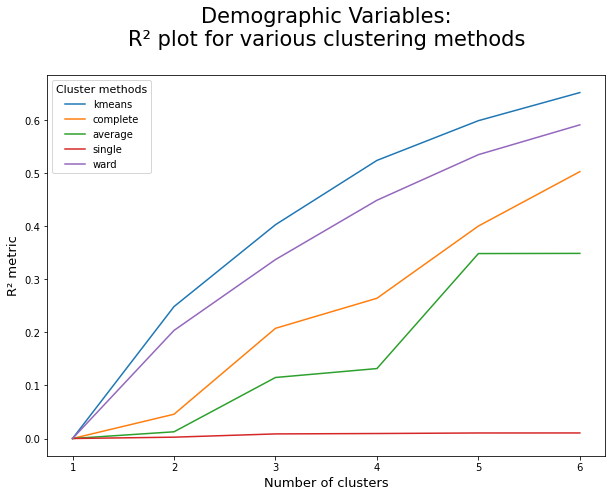

In [151]:
# Visualizing the R² scores for each cluster solution on demographic variables
pd.DataFrame(r2_scores).plot.line(figsize=(10,7))

plt.title("Demographic Variables:\nR² plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.show()

#we choose ward method

In [152]:
# create the counts of samples under each node (number of points being merged)
def function_linkage(linkage,distance,hclust):
    counts = np.zeros(hclust.children_.shape[0])
    n_samples = len(hclust.labels_)

    for i, merge in enumerate(hclust.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1 
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count
    linkage_matrix = np.column_stack(
        [hclust.children_, hclust.distances_, counts]
    ).astype(float)
    sns.set()
    fig = plt.figure(figsize=(11,5))
    y_threshold = 79
    dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
    plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
    plt.xlabel('Number of points in node (or index of point if no parenthesis)')
    plt.ylabel(f'{distance.title()} Distance', fontsize=13)
    plt.show()

findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=12.0.
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSerif-Bold.ttf', name='DejaVu Serif', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmb10.ttf', name='cmb10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUni.ttf', name='STIXNonUnicode', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUniBol.ttf', name='STIXNonUnicode', style='normal

findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizOneSymBol.ttf', name='STIXSizeOneSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizTwoSymBol.ttf', name='STIXSizeTwoSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmmi10.ttf', name='cmmi10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmsy10.ttf', name='cmsy10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PARCHM.TTF', name='Parchment', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GILB____.TTF', name='Gill Sans MT', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BELLI.TTF', name='Bell MT', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRADMCN.TTF', name='Franklin Gothic Demi Cond', style='normal', variant='normal', weight=400, stretch='condensed', size='scalable')) = 10.25
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\framdit.ttf', name='Franklin Gothic Medium', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TCM_____.TTF', name='Tw Cen MT', style='

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ITCKRIST.TTF', name='Kristen ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\palai.ttf', name='Palatino Linotype', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\courbd.ttf', name='Courier New', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\HARLOWSI.TTF', name='Harlow Solid Italic', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BAUHS93.TTF', name='Bauhaus 93', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\OUTLOOK.TTF', name='MS Outlook', style='normal', 

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\corbelz.ttf', name='Corbel', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Candaral.ttf', name='Candara', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ANTQUAI.TTF', name='Book Antiqua', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguisb.ttf', name='Segoe UI', style='normal', variant='normal', weight=600, stretch='normal', size='scalable')) = 10.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SegoeIcons.ttf', name='Segoe Fluent Icons', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\NIAGENG.TTF', name='Niagara Engraved', style='normal', varian

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BKANT.TTF', name='Book Antiqua', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\COPRGTB.TTF', name='Copperplate Gothic Bold', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRADM.TTF', name='Franklin Gothic Demi', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BOD_PSTC.TTF', name='Bodoni MT', style='normal', variant='normal', weight=300, stretch='normal', size='scalable')) = 10.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\AGENCYB.TTF', name='Agency FB', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PERB____.TTF', name='Perpetua', style='normal

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguisbi.ttf', name='Segoe UI', style='italic', variant='normal', weight=600, stretch='normal', size='scalable')) = 11.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\arialbd.ttf', name='Arial', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 0.33499999999999996
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguiemj.ttf', name='Segoe UI Emoji', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\constanb.ttf', name='Constantia', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\georgia.ttf', name='Georgia', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\MISTRAL.TTF', name='Mistral', style='normal', variant='

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguibl.ttf', name='Segoe UI', style='normal', variant='normal', weight=900, stretch='normal', size='scalable')) = 10.525
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GOTHICB.TTF', name='Century Gothic', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GOUDOSB.TTF', name='Goudy Old Style', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segmdl2.ttf', name='Segoe MDL2 Assets', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ANTQUAB.TTF', name='Book Antiqua', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GIL_____.TTF', name='Gill Sans MT', style='norm

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\comici.ttf', name='Comic Sans MS', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguili.ttf', name='Segoe UI', style='italic', variant='normal', weight=300, stretch='normal', size='scalable')) = 11.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\COOPBL.TTF', name='Cooper Black', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\wingding.ttf', name='Wingdings', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\CALIFR.TTF', name='Californian FB', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Candaraz.ttf', name='Candara', style='italic', variant='normal

findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizThreeSymReg.ttf', name='STIXSizeThreeSym', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizFiveSymReg.ttf', name='STIXSizeFiveSym', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUniIta.ttf', name='STIXNonUnicode', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmss10.ttf', name='cmss10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfon

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoepr.ttf', name='Segoe Print', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\sylfaen.ttf', name='Sylfaen', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\pala.ttf', name='Palatino Linotype', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\tahomabd.ttf', name='Tahoma', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\RAGE.TTF', name='Rage Italic', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GLSNECB.TTF', name='Gill Sans MT Ext Condensed Bold', style='normal',

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SCRIPTBL.TTF', name='Script MT Bold', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\couri.ttf', name='Courier New', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\arialbi.ttf', name='Arial', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 1.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LCALLIG.TTF', name='Lucida Calligraphy', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ebrimabd.ttf', name='Ebrima', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\YuGothL.ttc', name='Yu Gothic', style='normal', variant='norm

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\cambriaz.ttf', name='Cambria', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Nirmala.ttf', name='Nirmala UI', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BOOKOS.TTF', name='Bookman Old Style', style='normal', variant='normal', weight=300, stretch='normal', size='scalable')) = 10.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\REFSPCL.TTF', name='MS Reference Specialty', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRABK.TTF', name='Franklin Gothic Book', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\arial.ttf', name='Arial', style='normal',

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\VIVALDII.TTF', name='Vivaldi', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BOD_CI.TTF', name='Bodoni MT', style='italic', variant='normal', weight=400, stretch='condensed', size='scalable')) = 11.25
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\calibrili.ttf', name='Calibri', style='italic', variant='normal', weight=300, stretch='normal', size='scalable')) = 11.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\WINGDNG2.TTF', name='Wingdings 2', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SCHLBKB.TTF', name='Century Schoolbook', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoescb.ttf', name='Segoe Script', style='normal', varia

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\HATTEN.TTF', name='Haettenschweiler', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\gadugib.ttf', name='Gadugi', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LTYPEO.TTF', name='Lucida Sans Typewriter', style='oblique', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LFAX.TTF', name='Lucida Fax', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SCHLBKI.TTF', name='Century Schoolbook', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ELEPHNT.TTF', name='Elephant', style='normal', v

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\STENCIL.TTF', name='Stencil', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TEMPSITC.TTF', name='Tempus Sans ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\MSUIGHUB.TTF', name='Microsoft Uighur', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\timesi.ttf', name='Times New Roman', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\CALISTB.TTF', name='Calisto MT', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BELL.TTF', name='Bell MT', style='normal', variant=

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LSANSI.TTF', name='Lucida Sans', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguibli.ttf', name='Segoe UI', style='italic', variant='normal', weight=900, stretch='normal', size='scalable')) = 11.525
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\webdings.ttf', name='Webdings', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\lucon.ttf', name='Lucida Console', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TCCEB.TTF', name='Tw Cen MT Condensed Extra Bold', style='normal', variant='normal', weight=400, stretch='condensed', size='scalable')) = 10.25
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ROCC____.TTF', name='Rockwell Condensed', sty

findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSerif-Bold.ttf', name='DejaVu Serif', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmb10.ttf', name='cmb10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUni.ttf', name='STIXNonUnicode', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUniBol.ttf', name='STIXNonUnicode', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontE

findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizOneSymBol.ttf', name='STIXSizeOneSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizTwoSymBol.ttf', name='STIXSizeTwoSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmmi10.ttf', name='cmmi10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmsy10.ttf', name='cmsy10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PARCHM.TTF', name='Parchment', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GILB____.TTF', name='Gill Sans MT', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BELLI.TTF', name='Bell MT', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRADMCN.TTF', name='Franklin Gothic Demi Cond', style='normal', variant='normal', weight=400, stretch='condensed', size='scalable')) = 10.25
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\framdit.ttf', name='Franklin Gothic Medium', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TCM_____.TTF', name='Tw Cen MT', style='

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ITCKRIST.TTF', name='Kristen ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\palai.ttf', name='Palatino Linotype', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\courbd.ttf', name='Courier New', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\HARLOWSI.TTF', name='Harlow Solid Italic', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BAUHS93.TTF', name='Bauhaus 93', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\OUTLOOK.TTF', name='MS Outlook', style='normal', 

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\corbelz.ttf', name='Corbel', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Candaral.ttf', name='Candara', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ANTQUAI.TTF', name='Book Antiqua', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguisb.ttf', name='Segoe UI', style='normal', variant='normal', weight=600, stretch='normal', size='scalable')) = 10.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SegoeIcons.ttf', name='Segoe Fluent Icons', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\NIAGENG.TTF', name='Niagara Engraved', style='normal', varian

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BKANT.TTF', name='Book Antiqua', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\COPRGTB.TTF', name='Copperplate Gothic Bold', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRADM.TTF', name='Franklin Gothic Demi', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BOD_PSTC.TTF', name='Bodoni MT', style='normal', variant='normal', weight=300, stretch='normal', size='scalable')) = 10.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\AGENCYB.TTF', name='Agency FB', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PERB____.TTF', name='Perpetua', style='normal

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguisbi.ttf', name='Segoe UI', style='italic', variant='normal', weight=600, stretch='normal', size='scalable')) = 11.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\arialbd.ttf', name='Arial', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 0.33499999999999996
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguiemj.ttf', name='Segoe UI Emoji', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\constanb.ttf', name='Constantia', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\georgia.ttf', name='Georgia', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\MISTRAL.TTF', name='Mistral', style='normal', variant='

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguibl.ttf', name='Segoe UI', style='normal', variant='normal', weight=900, stretch='normal', size='scalable')) = 10.525
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GOTHICB.TTF', name='Century Gothic', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GOUDOSB.TTF', name='Goudy Old Style', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segmdl2.ttf', name='Segoe MDL2 Assets', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ANTQUAB.TTF', name='Book Antiqua', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GIL_____.TTF', name='Gill Sans MT', style='norm

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\comici.ttf', name='Comic Sans MS', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguili.ttf', name='Segoe UI', style='italic', variant='normal', weight=300, stretch='normal', size='scalable')) = 11.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\COOPBL.TTF', name='Cooper Black', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\wingding.ttf', name='Wingdings', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\CALIFR.TTF', name='Californian FB', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Candaraz.ttf', name='Candara', style='italic', variant='normal

findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizThreeSymReg.ttf', name='STIXSizeThreeSym', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizFiveSymReg.ttf', name='STIXSizeFiveSym', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUniIta.ttf', name='STIXNonUnicode', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmss10.ttf', name='cmss10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfon

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoepr.ttf', name='Segoe Print', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\sylfaen.ttf', name='Sylfaen', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\pala.ttf', name='Palatino Linotype', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\tahomabd.ttf', name='Tahoma', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\RAGE.TTF', name='Rage Italic', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GLSNECB.TTF', name='Gill Sans MT Ext Condensed Bold', style='normal',

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SCRIPTBL.TTF', name='Script MT Bold', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\couri.ttf', name='Courier New', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\arialbi.ttf', name='Arial', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 1.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LCALLIG.TTF', name='Lucida Calligraphy', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ebrimabd.ttf', name='Ebrima', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\YuGothL.ttc', name='Yu Gothic', style='normal', variant='norm

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\cambriaz.ttf', name='Cambria', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Nirmala.ttf', name='Nirmala UI', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BOOKOS.TTF', name='Bookman Old Style', style='normal', variant='normal', weight=300, stretch='normal', size='scalable')) = 10.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\REFSPCL.TTF', name='MS Reference Specialty', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRABK.TTF', name='Franklin Gothic Book', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\arial.ttf', name='Arial', style='normal',

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\VIVALDII.TTF', name='Vivaldi', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BOD_CI.TTF', name='Bodoni MT', style='italic', variant='normal', weight=400, stretch='condensed', size='scalable')) = 11.25
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\calibrili.ttf', name='Calibri', style='italic', variant='normal', weight=300, stretch='normal', size='scalable')) = 11.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\WINGDNG2.TTF', name='Wingdings 2', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SCHLBKB.TTF', name='Century Schoolbook', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoescb.ttf', name='Segoe Script', style='normal', varia

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\HATTEN.TTF', name='Haettenschweiler', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\gadugib.ttf', name='Gadugi', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LTYPEO.TTF', name='Lucida Sans Typewriter', style='oblique', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LFAX.TTF', name='Lucida Fax', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SCHLBKI.TTF', name='Century Schoolbook', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ELEPHNT.TTF', name='Elephant', style='normal', v

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\STENCIL.TTF', name='Stencil', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TEMPSITC.TTF', name='Tempus Sans ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\MSUIGHUB.TTF', name='Microsoft Uighur', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\timesi.ttf', name='Times New Roman', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\CALISTB.TTF', name='Calisto MT', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BELL.TTF', name='Bell MT', style='normal', variant=

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LSANSI.TTF', name='Lucida Sans', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguibli.ttf', name='Segoe UI', style='italic', variant='normal', weight=900, stretch='normal', size='scalable')) = 11.525
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\webdings.ttf', name='Webdings', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\lucon.ttf', name='Lucida Console', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TCCEB.TTF', name='Tw Cen MT Condensed Extra Bold', style='normal', variant='normal', weight=400, stretch='condensed', size='scalable')) = 10.25
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ROCC____.TTF', name='Rockwell Condensed', sty

findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSerif-Bold.ttf', name='DejaVu Serif', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmb10.ttf', name='cmb10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUni.ttf', name='STIXNonUnicode', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUniBol.ttf', name='STIXNonUnicode', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontE

findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizOneSymBol.ttf', name='STIXSizeOneSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizTwoSymBol.ttf', name='STIXSizeTwoSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmmi10.ttf', name='cmmi10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmsy10.ttf', name='cmsy10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PARCHM.TTF', name='Parchment', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GILB____.TTF', name='Gill Sans MT', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BELLI.TTF', name='Bell MT', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRADMCN.TTF', name='Franklin Gothic Demi Cond', style='normal', variant='normal', weight=400, stretch='condensed', size='scalable')) = 10.25
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\framdit.ttf', name='Franklin Gothic Medium', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TCM_____.TTF', name='Tw Cen MT', style='

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ITCKRIST.TTF', name='Kristen ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\palai.ttf', name='Palatino Linotype', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\courbd.ttf', name='Courier New', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\HARLOWSI.TTF', name='Harlow Solid Italic', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BAUHS93.TTF', name='Bauhaus 93', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\OUTLOOK.TTF', name='MS Outlook', style='normal', 

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\corbelz.ttf', name='Corbel', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Candaral.ttf', name='Candara', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ANTQUAI.TTF', name='Book Antiqua', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguisb.ttf', name='Segoe UI', style='normal', variant='normal', weight=600, stretch='normal', size='scalable')) = 10.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SegoeIcons.ttf', name='Segoe Fluent Icons', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\NIAGENG.TTF', name='Niagara Engraved', style='normal', varian

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BKANT.TTF', name='Book Antiqua', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\COPRGTB.TTF', name='Copperplate Gothic Bold', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRADM.TTF', name='Franklin Gothic Demi', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BOD_PSTC.TTF', name='Bodoni MT', style='normal', variant='normal', weight=300, stretch='normal', size='scalable')) = 10.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\AGENCYB.TTF', name='Agency FB', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PERB____.TTF', name='Perpetua', style='normal

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguisbi.ttf', name='Segoe UI', style='italic', variant='normal', weight=600, stretch='normal', size='scalable')) = 11.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\arialbd.ttf', name='Arial', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 0.33499999999999996
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguiemj.ttf', name='Segoe UI Emoji', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\constanb.ttf', name='Constantia', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\georgia.ttf', name='Georgia', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\MISTRAL.TTF', name='Mistral', style='normal', variant='

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguibl.ttf', name='Segoe UI', style='normal', variant='normal', weight=900, stretch='normal', size='scalable')) = 10.525
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GOTHICB.TTF', name='Century Gothic', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GOUDOSB.TTF', name='Goudy Old Style', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segmdl2.ttf', name='Segoe MDL2 Assets', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ANTQUAB.TTF', name='Book Antiqua', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GIL_____.TTF', name='Gill Sans MT', style='norm

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\comici.ttf', name='Comic Sans MS', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguili.ttf', name='Segoe UI', style='italic', variant='normal', weight=300, stretch='normal', size='scalable')) = 11.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\COOPBL.TTF', name='Cooper Black', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\wingding.ttf', name='Wingdings', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\CALIFR.TTF', name='Californian FB', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Candaraz.ttf', name='Candara', style='italic', variant='normal

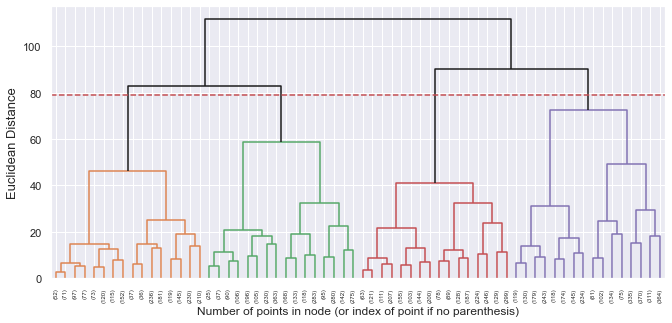

In [153]:
#the best was ward method
linkage = 'ward'
distance = 'euclidean'
hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)
hclust.fit_predict(df)

function_linkage(linkage,distance,hclust)

In [154]:
'''#linkage complete
linkage = 'complete'
distance = 'euclidean'
hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)
hclust.fit_predict(df)

function_linkage(linkage,distance,hclust)'''

"#linkage complete\nlinkage = 'complete'\ndistance = 'euclidean'\nhclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)\nhclust.fit_predict(df)\n\nfunction_linkage(linkage,distance,hclust)"

In [155]:
'''#linkage complete
linkage = 'average'
distance = 'euclidean'
hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)
hclust.fit_predict(df)

function_linkage(linkage,distance,hclust)'''

"#linkage complete\nlinkage = 'average'\ndistance = 'euclidean'\nhclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)\nhclust.fit_predict(df)\n\nfunction_linkage(linkage,distance,hclust)"

In [156]:
'''#linkage complete
linkage = 'single'
distance = 'euclidean'
hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)
hclust.fit_predict(df)

function_linkage(linkage,distance,hclust)'''

"#linkage complete\nlinkage = 'single'\ndistance = 'euclidean'\nhclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)\nhclust.fit_predict(df)\n\nfunction_linkage(linkage,distance,hclust)"

### Final Hierarchical clustering solution

In [157]:
# 4 cluster solution was the best
linkage = 'ward'
distance = 'euclidean'
hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, n_clusters=4)
hc_labels = hclust.fit_predict(df)

In [158]:
## Characterizing the 4 clusters
df_concat = pd.concat((df, pd.Series(hc_labels, name='labels', index = df.index)), axis=1)
df_concat.groupby('labels').mean()

,PolYears,MonthSal,CMV
labels,,,
0,0.666270,-0.759902,0.288557
1,-0.779326,0.800080,0.210314
2,-0.758369,-0.613809,-0.663086
3,0.959057,0.909290,0.098436


In [159]:
print(silhouette(df,hc_labels))
print(r2(df,hc_labels))

0.2009497345608374
0.4492677003360471


In [160]:
#number of observations in each cluster
labels = hclust.labels_
counts = np.bincount(labels[labels>=0])
counts

array([3114, 2646, 2484, 1951], dtype=int64)

## K-means clustering

### Defining the number of clusters:

In [161]:
range_clusters = range(1, 11)

In [162]:
inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
    kmclust.fit(df)
    inertia.append(kmclust.inertia_)  # save the inertia of the given cluster solution

findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=15.0.
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSerif-Bold.ttf', name='DejaVu Serif', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmb10.ttf', name='cmb10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUni.ttf', name='STIXNonUnicode', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUniBol.ttf', name='STIXNonUnicode', style='normal

findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizOneSymBol.ttf', name='STIXSizeOneSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizTwoSymBol.ttf', name='STIXSizeTwoSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmmi10.ttf', name='cmmi10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Users\\catar\\anaconda3\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmsy10.ttf', name='cmsy10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PARCHM.TTF', name='Parchment', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GILB____.TTF', name='Gill Sans MT', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BELLI.TTF', name='Bell MT', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRADMCN.TTF', name='Franklin Gothic Demi Cond', style='normal', variant='normal', weight=400, stretch='condensed', size='scalable')) = 10.25
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\framdit.ttf', name='Franklin Gothic Medium', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\TCM_____.TTF', name='Tw Cen MT', style='

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ITCKRIST.TTF', name='Kristen ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\palai.ttf', name='Palatino Linotype', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\courbd.ttf', name='Courier New', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\HARLOWSI.TTF', name='Harlow Solid Italic', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BAUHS93.TTF', name='Bauhaus 93', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\OUTLOOK.TTF', name='MS Outlook', style='normal', 

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\corbelz.ttf', name='Corbel', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Candaral.ttf', name='Candara', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ANTQUAI.TTF', name='Book Antiqua', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguisb.ttf', name='Segoe UI', style='normal', variant='normal', weight=600, stretch='normal', size='scalable')) = 10.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SegoeIcons.ttf', name='Segoe Fluent Icons', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\NIAGENG.TTF', name='Niagara Engraved', style='normal', varian

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BKANT.TTF', name='Book Antiqua', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\COPRGTB.TTF', name='Copperplate Gothic Bold', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\FRADM.TTF', name='Franklin Gothic Demi', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\BOD_PSTC.TTF', name='Bodoni MT', style='normal', variant='normal', weight=300, stretch='normal', size='scalable')) = 10.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\AGENCYB.TTF', name='Agency FB', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\PERB____.TTF', name='Perpetua', style='normal

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguisbi.ttf', name='Segoe UI', style='italic', variant='normal', weight=600, stretch='normal', size='scalable')) = 11.24
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\arialbd.ttf', name='Arial', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 0.33499999999999996
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguiemj.ttf', name='Segoe UI Emoji', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\constanb.ttf', name='Constantia', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\georgia.ttf', name='Georgia', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\MISTRAL.TTF', name='Mistral', style='normal', variant='

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguibl.ttf', name='Segoe UI', style='normal', variant='normal', weight=900, stretch='normal', size='scalable')) = 10.525
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GOTHICB.TTF', name='Century Gothic', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GOUDOSB.TTF', name='Goudy Old Style', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segmdl2.ttf', name='Segoe MDL2 Assets', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ANTQUAB.TTF', name='Book Antiqua', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GIL_____.TTF', name='Gill Sans MT', style='norm

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\comici.ttf', name='Comic Sans MS', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguili.ttf', name='Segoe UI', style='italic', variant='normal', weight=300, stretch='normal', size='scalable')) = 11.145
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\COOPBL.TTF', name='Cooper Black', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\wingding.ttf', name='Wingdings', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\CALIFR.TTF', name='Californian FB', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Candaraz.ttf', name='Candara', style='italic', variant='normal

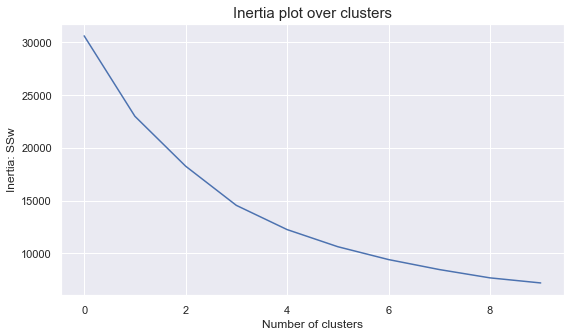

In [163]:
# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(inertia)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

For n_clusters = 2, the average silhouette_score is : 0.24954624672222323
For n_clusters = 3, the average silhouette_score is : 0.24636201763669746
For n_clusters = 4, the average silhouette_score is : 0.2590146330439446
For n_clusters = 5, the average silhouette_score is : 0.26068628654533677
For n_clusters = 6, the average silhouette_score is : 0.2746190051434869
For n_clusters = 7, the average silhouette_score is : 0.2742070072616499
For n_clusters = 8, the average silhouette_score is : 0.2765029718101558
For n_clusters = 9, the average silhouette_score is : 0.27149584867018905
For n_clusters = 10, the average silhouette_score is : 0.26576065180489167


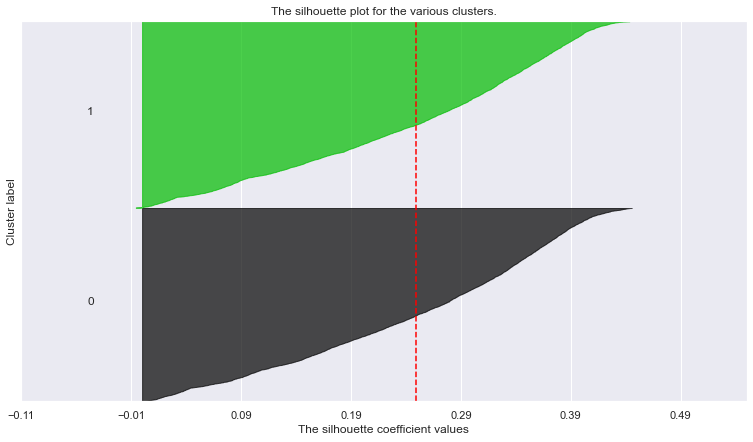

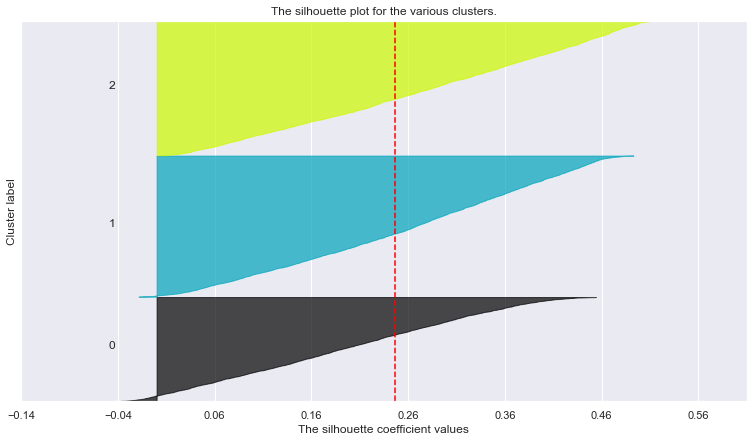

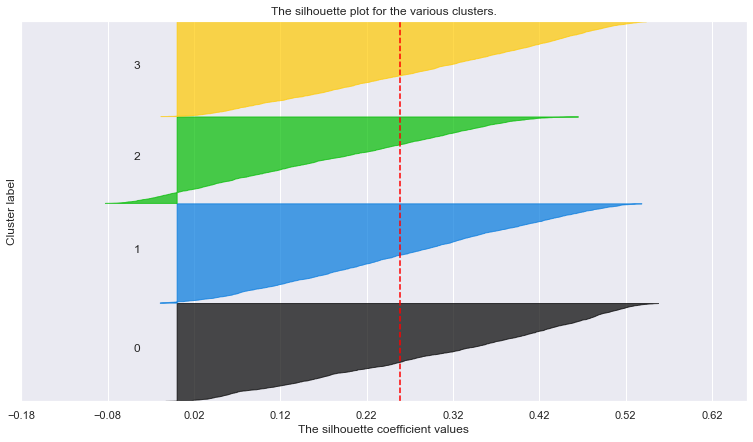

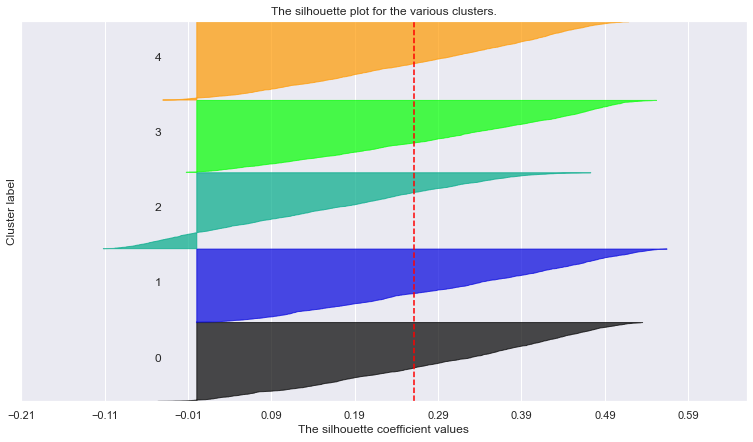

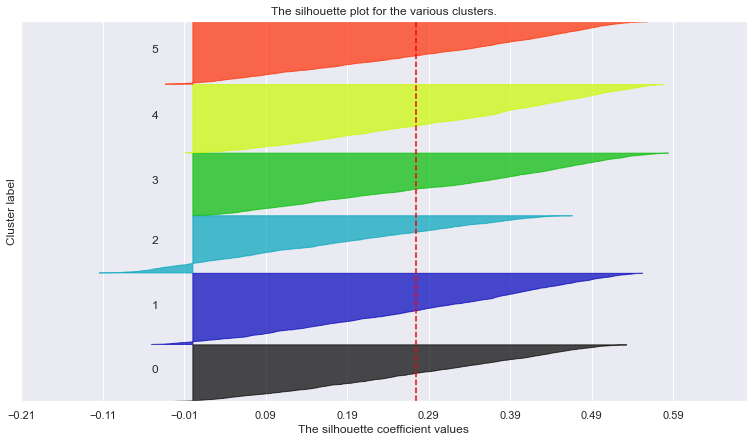

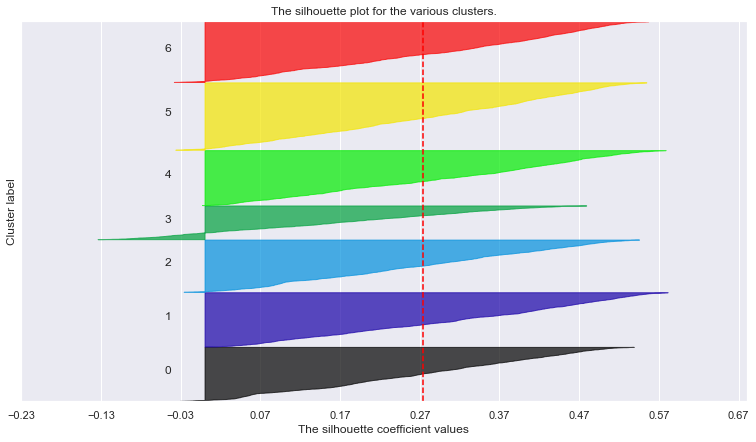

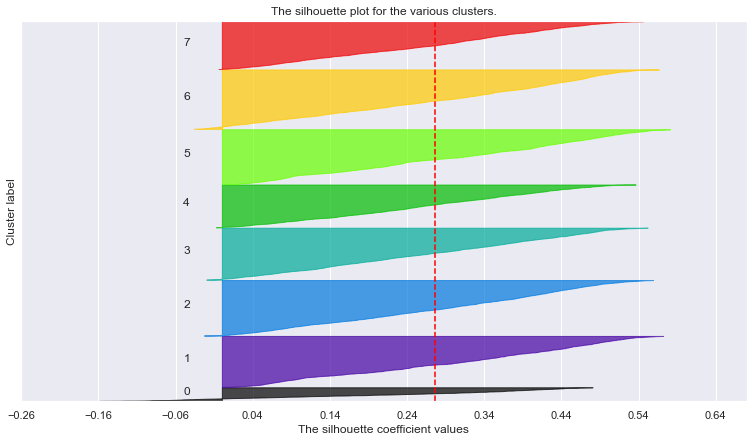

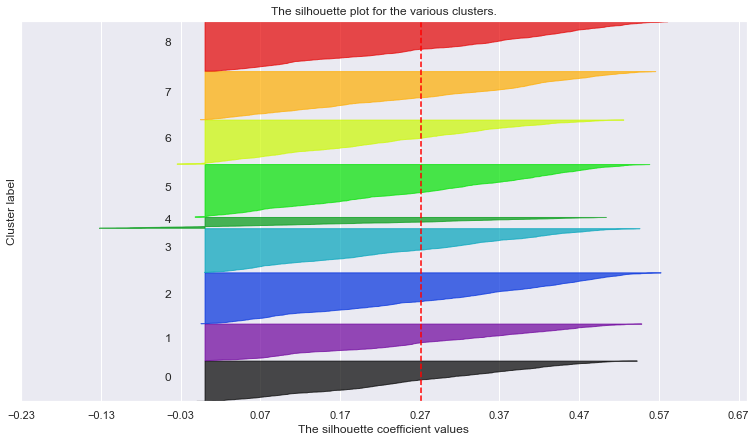

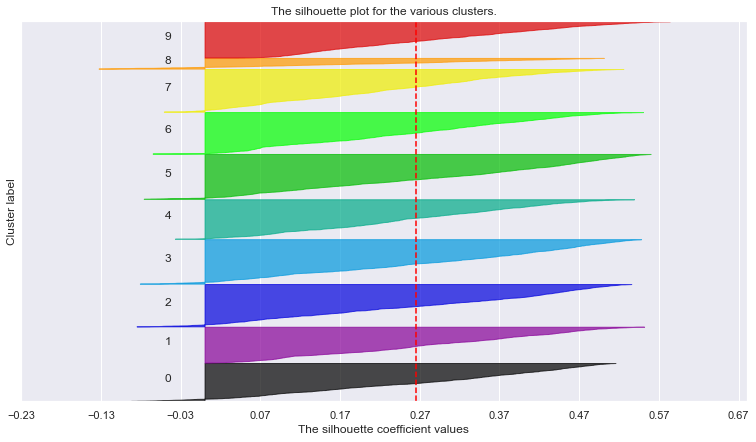

In [164]:
# Storing average silhouette metric
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue
    
    # Create a figure
    fig = plt.figure(figsize=(13, 7))
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(df)

    silhouette_avg = silhouette_score(df, cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(df, cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    plt.title("The silhouette plot for the various clusters.")
    plt.xlabel("The silhouette coefficient values")
    plt.ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    plt.axvline(x=silhouette_avg, color="red", linestyle="--")
    
    # The silhouette coefficient can range from -1, 1
    xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
    plt.xlim([xmin, xmax])
    
    # The (nclus+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    plt.ylim([0, len(df) + (nclus + 1) * 10])

    plt.yticks([])  # Clear the yaxis labels / ticks
    plt.xticks(np.arange(xmin, xmax, 0.1))

### Final KMeans clustering solution

In [165]:
#the best is 3 or 4 clusters

In [166]:
# final cluster solution
number_clusters = 4
kmclust4 = KMeans(n_clusters=number_clusters, init='k-means++', n_init=15, random_state=1)
km_labels4 = kmclust4.fit_predict(df)
km_labels4

array([1, 2, 1, ..., 2, 1, 2])

In [167]:
# Characterizing the final clusters
df_concat4 = pd.concat((df, pd.Series(km_labels4, name='labels',index = df.index)), axis=1)
df_concat4.groupby('labels').mean()

,PolYears,MonthSal,CMV
labels,,,
0,-0.924993,0.787498,-0.249488
1,0.041174,-0.977104,-0.663424
2,-0.114152,-0.518592,1.255732
3,1.015643,0.682561,-0.192839


In [168]:
print(silhouette(df,km_labels4))
print(r2(df,km_labels4))

0.2590146330439446
0.5244489206680452


In [169]:
# final cluster solution
number_clusters = 4
kmclust4 = KMeans(n_clusters=number_clusters, init='k-means++', n_init=15, random_state=1)
km_labels4 = kmclust4.fit_predict(df)
km_labels4

array([5, 2, 4, ..., 2, 5, 2])

In [170]:
# Characterizing the final clusters
df_concat4 = pd.concat((df, pd.Series(km_labels4, name='labels',index = df.index)), axis=1)
df_concat4.groupby('labels').mean()

,PolYears,MonthSal,CMV
labels,,,
0,0.801993,0.473422,0.925623
1,-0.946362,1.028261,-0.099756
2,-0.551410,-0.730615,1.307608
3,0.818002,0.816907,-0.736841
4,-0.822427,-0.707329,-0.713425
5,0.938931,-0.972681,-0.409061


In [171]:
print(silhouette(df,km_labels4))
print(r2(df,km_labels4))

0.2746190051434869
0.652387520879744


## SOM clustering

### SOM Algorithm

In [172]:
np.random.seed(42)

# Notice that the SOM did not converge - We're under a time constraint for this class
sm = sompy.SOMFactory().build(
        df.values, 
        mapsize=[10, 10],
        initialization='random',
        neighborhood='gaussian',
        training='batch',
        lattice='hexa',
        normalization=False,
        component_names=df.columns
)
sm.train(n_job=-1, verbose='info', train_rough_len=125, train_finetune_len=110)  ## TUNE THESE PARAMETERS !!!

 Training...
 random_initialization took: 0.001000 seconds
 Rough training...
 radius_ini: 4.000000 , radius_final: 1.000000, trainlen: 125

 epoch: 1 ---> elapsed time:  0.081000, quantization error: 0.690460

 epoch: 2 ---> elapsed time:  0.038000, quantization error: 1.605971

 epoch: 3 ---> elapsed time:  0.044000, quantization error: 1.518771

 epoch: 4 ---> elapsed time:  0.045000, quantization error: 1.504178

 epoch: 5 ---> elapsed time:  0.043000, quantization error: 1.495159

 epoch: 6 ---> elapsed time:  0.044000, quantization error: 1.490526

 epoch: 7 ---> elapsed time:  0.044000, quantization error: 1.487998

 epoch: 8 ---> elapsed time:  0.043000, quantization error: 1.486008

 epoch: 9 ---> elapsed time:  0.046000, quantization error: 1.484093

 epoch: 10 ---> elapsed time:  0.046000, quantization error: 1.482164

 epoch: 11 ---> elapsed time:  0.046000, quantization error: 1.480215

 epoch: 12 ---> elapsed time:  0.043000, quantization error: 1.478233

 epoch: 13 ---> 

 epoch: 115 ---> elapsed time:  0.047000, quantization error: 0.775088

 epoch: 116 ---> elapsed time:  0.045000, quantization error: 0.760450

 epoch: 117 ---> elapsed time:  0.047000, quantization error: 0.745847

 epoch: 118 ---> elapsed time:  0.044000, quantization error: 0.731270

 epoch: 119 ---> elapsed time:  0.046000, quantization error: 0.716769

 epoch: 120 ---> elapsed time:  0.048000, quantization error: 0.702368

 epoch: 121 ---> elapsed time:  0.044000, quantization error: 0.688299

 epoch: 122 ---> elapsed time:  0.045000, quantization error: 0.674350

 epoch: 123 ---> elapsed time:  0.045000, quantization error: 0.660787

 epoch: 124 ---> elapsed time:  0.043000, quantization error: 0.647211

 epoch: 125 ---> elapsed time:  0.047000, quantization error: 0.633622

 Finetune training...
 radius_ini: 1.000000 , radius_final: 1.000000, trainlen: 110

 epoch: 1 ---> elapsed time:  0.044000, quantization error: 0.620243

 epoch: 2 ---> elapsed time:  0.044000, quantization 

 epoch: 105 ---> elapsed time:  0.043000, quantization error: 0.613665

 epoch: 106 ---> elapsed time:  0.047000, quantization error: 0.613665

 epoch: 107 ---> elapsed time:  0.043000, quantization error: 0.613665

 epoch: 108 ---> elapsed time:  0.044000, quantization error: 0.613665

 epoch: 109 ---> elapsed time:  0.044000, quantization error: 0.613665

 epoch: 110 ---> elapsed time:  0.041000, quantization error: 0.613665

 Final quantization error: 0.613665
 train took: 10.926000 seconds


### Component Planes

In [173]:
len(metric_features)

10

In [174]:
plt.rcParams['figure.dpi'] = 72
weights = sm.codebook.matrix 

In [175]:
'''def plot_component_planes(weights,
                          features,
                          M=3, N=4, 
                          figsize=(20,20),
                          figlayout=(3,4),
                          title="Component Planes",
                          cmap=cm.magma
                         ):
    
    xx, yy = np.meshgrid(np.arange(M), np.arange(N))
    xx = xx.astype(float)
    yy = yy.astype(float)

    xx[::-2] -= 0.5

    xx = xx.T
    yy = yy.T
    
    weights_ = weights.reshape((M,N,len(features)))

    fig = plt.figure(figsize=figsize, constrained_layout=True)
    subfigs = fig.subfigures(figlayout[0], figlayout[1], wspace=.15)
    
    ## Normalize color scale to range of all values
    colornorm = mpl_colors.Normalize(vmin=np.min(weights), 
                                         vmax=np.max(weights))

    for cpi, sf in zip(range(len(metric_features)), subfigs.flatten()):

        sf.suptitle(features[cpi], y=0.95)

        axs = sf.subplots(1,1, )
        axs.set_aspect('equal')

        ## Normalize color scale to range of values in each component
        colornorm = mpl_colors.Normalize(vmin=np.min(weights_[:,:,cpi]), 
                                         vmax=np.max(weights_[:,:,cpi]))

        # iteratively add hexagons
        for i in range(weights_.shape[0]):
            for j in range(weights_.shape[1]):
                wy = yy[(i, j)] * np.sqrt(3) / 2
                hexagon = RegularPolygon((xx[(i, j)], wy), 
                                     numVertices=6, 
                                     radius=.99 / np.sqrt(3),
                                     facecolor=cmap(colornorm(weights_[i, j, cpi])), 
                                     alpha=1, 
                                     linewidth=.5,
                                     edgecolor=cmap(colornorm(weights_[i, j, cpi]))
                                    )
                axs.add_patch(hexagon)


        ## only run this block if matplotlib >= 3.6.x
        mplv = [int(i) for i in mplver.split('.')]
        if mplv[1] >= 6:
             ## Add colorbar
            divider = make_axes_locatable(axs)

            ax_cb = divider.append_axes("right", size="7%")#, pad="2%")

            ## Create a Mappable object
            cmap_sm = plt.cm.ScalarMappable(cmap=cmap, norm=colornorm)
            cmap_sm.set_array([])

            ## Create custom colorbar 
            cb1 = colorbar.Colorbar(ax_cb,
                                    orientation='vertical', 
                                    alpha=1,
                                    mappable=cmap_sm
                                    )
            cb1.ax.get_yaxis().labelpad = 16

            ## Add colorbar to plot
            sf.add_axes(ax_cb)



        ## Remove axes for hex plot
        axs.margins(.05)
        axs.axis("off")


    fig.suptitle(title)
    plt.show()'''

'def plot_component_planes(weights,\n                          features,\n                          M=3, N=4, \n                          figsize=(20,20),\n                          figlayout=(3,4),\n                          title="Component Planes",\n                          cmap=cm.magma\n                         ):\n    \n    xx, yy = np.meshgrid(np.arange(M), np.arange(N))\n    xx = xx.astype(float)\n    yy = yy.astype(float)\n\n    xx[::-2] -= 0.5\n\n    xx = xx.T\n    yy = yy.T\n    \n    weights_ = weights.reshape((M,N,len(features)))\n\n    fig = plt.figure(figsize=figsize, constrained_layout=True)\n    subfigs = fig.subfigures(figlayout[0], figlayout[1], wspace=.15)\n    \n    ## Normalize color scale to range of all values\n    colornorm = mpl_colors.Normalize(vmin=np.min(weights), \n                                         vmax=np.max(weights))\n\n    for cpi, sf in zip(range(len(metric_features)), subfigs.flatten()):\n\n        sf.suptitle(features[cpi], y=0.95)\n\n      

In [176]:
'''plot_component_planes(weights=sm.codebook.matrix,features=metric_features,
                      M=10,N=10,
                      figsize=(12,15),figlayout=(4,3),
                      title="Component Planes",
                      cmap=sns.color_palette("rocket", as_cmap=True))'''

'plot_component_planes(weights=sm.codebook.matrix,features=metric_features,\n                      M=10,N=10,\n                      figsize=(12,15),figlayout=(4,3),\n                      title="Component Planes",\n                      cmap=sns.color_palette("rocket", as_cmap=True))'

In [177]:
print("matplotlib version is:" , mplver)


matplotlib version is: 3.5.1


### U-Matrix

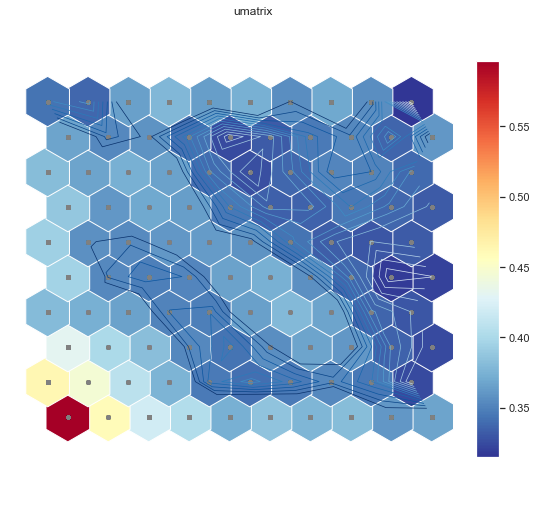

In [178]:
# Here you have U-matrix
u = sompy.umatrix.UMatrixView(9, 9, 'umatrix', show_axis=True, text_size=8, show_text=True)

UMAT = u.show(
    sm, 
    distance=2, 
    row_normalized=False,
    show_data=True, 
    contour=True, # Visualize isomorphic curves
    blob=False
)

# np.flip(UMAT[1], axis=1) # U-matrix values - they match with the plot colors

### Hit Map

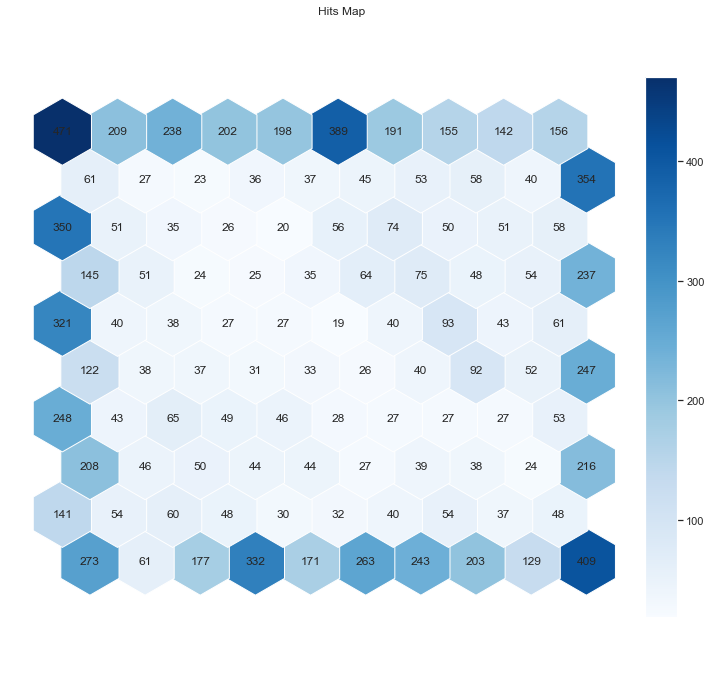

In [179]:
vhts  = BmuHitsView(12,12,"Hits Map")
vhts.show(sm, anotate=True, onlyzeros=False, labelsize=12, cmap="Blues")
plt.show()

### Hierarchical Clustering using SOM

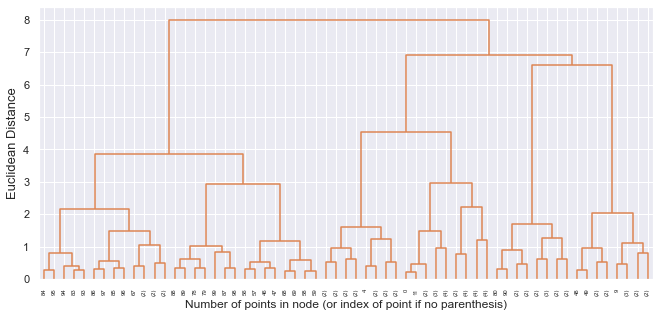

In [180]:
units = sm.codebook.matrix

linkage = 'ward'
distance = 'euclidean'
hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)
hclust.fit_predict(units)

function_linkage(linkage,distance,hclust)


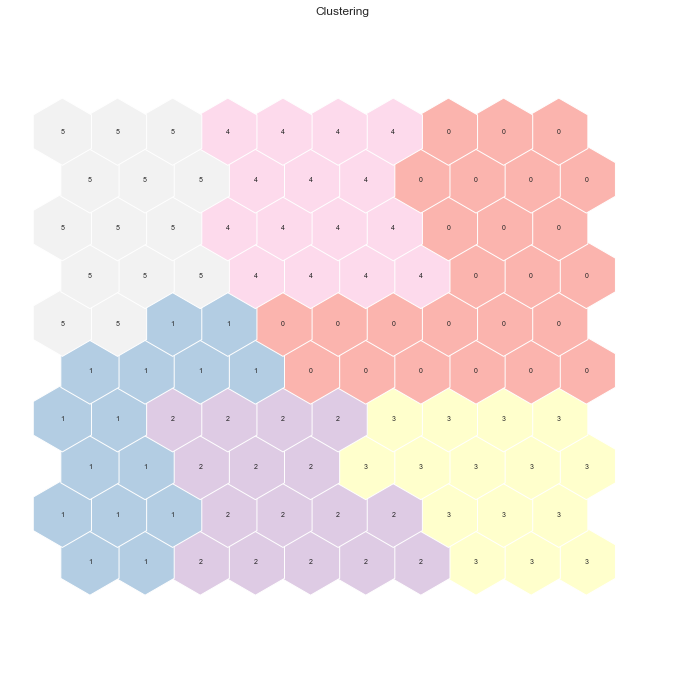

In [181]:
# Perform Hierarchical clustering on top of the 2500 untis (sm.get_node_vectors() output)
hierclust = AgglomerativeClustering(n_clusters=6, linkage='ward')
nodeclus_labels = hierclust.fit_predict(sm.codebook.matrix)
sm.cluster_labels = nodeclus_labels  # setting the cluster labels of sompy

hits  = HitMapView(12, 12,"Clustering",text_size=10)
hits.show(sm, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

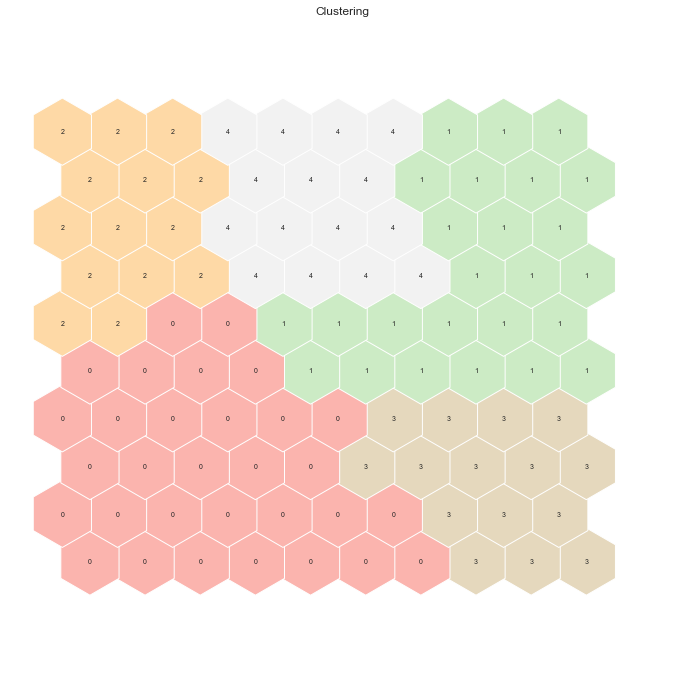

In [182]:
hierclust = AgglomerativeClustering(n_clusters=5, linkage='ward')
nodeclus_labels = hierclust.fit_predict(sm.codebook.matrix)
sm.cluster_labels = nodeclus_labels  # setting the cluster labels of sompy

hits  = HitMapView(12, 12,"Clustering",text_size=10)
hits.show(sm, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

#### Final SOM Hierarquical Clustering solution

In [183]:
#best solution -- 5

In [184]:
hierclust = AgglomerativeClustering(n_clusters=5, linkage='ward')
nodeclus_labels = hierclust.fit_predict(sm.codebook.matrix)
sm.cluster_labels = nodeclus_labels


In [185]:
# Check the nodes and and respective clusters
nodes = sm.codebook.matrix

df_nodes = pd.DataFrame(nodes, columns=df.columns)
df_nodes['label'] = nodeclus_labels
df_nodes

# Obtaining SOM's BMUs labels
bmus_map = sm.find_bmu(df)[0]  # get bmus for each observation in df_value

df_value_bmus = pd.DataFrame(
    np.concatenate((df, np.expand_dims(bmus_map,1)), axis=1),
    index=df.index, columns=np.append(df.columns,"BMU"))

# Get cluster labels for each observation
hierarc_5 = df_value_bmus.merge(df_nodes['label'], 'left', left_on="BMU", right_index=True)
hierarc_5.drop(columns='BMU').groupby('label').mean()


,PolYears,MonthSal,CMV
label,,,
0,0.152652,-0.364018,1.077778
1,0.670845,-0.684791,-0.715669
2,-0.912875,1.046954,-0.068820
3,0.969633,1.062920,-0.384062
4,-0.961218,-0.634530,-0.727543


In [186]:
hierarc_5_labels = hierarc_5['label']

#### R²

In [187]:
# using R²
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

sst = get_ss(hierarc_5[df.columns])  # get total sum of squares
ssw_labels = hierarc_5[(df.columns).to_list() + ["label"]].groupby(by='label').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2_ = ssb / sst
r2_

0.5545847454680557

In [188]:
print(silhouette(df,hierarc_5_labels))

0.210627738998257


### K-means

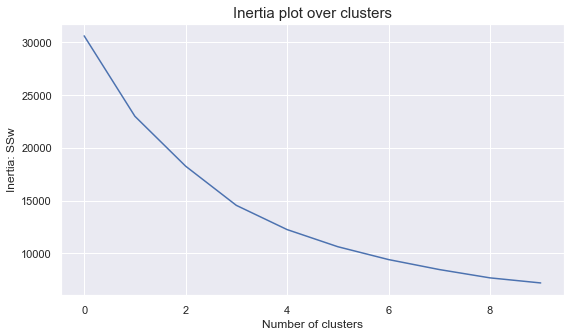

In [189]:
inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
    kmclust.fit(df)
    inertia.append(kmclust.inertia_)  # save the inertia of the given cluster solution
    
# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(inertia)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

For n_clusters = 2, the average silhouette_score is : 0.24954624672222323
For n_clusters = 3, the average silhouette_score is : 0.24636201763669746
For n_clusters = 4, the average silhouette_score is : 0.2590146330439446
For n_clusters = 5, the average silhouette_score is : 0.26068628654533677
For n_clusters = 6, the average silhouette_score is : 0.2746190051434869
For n_clusters = 7, the average silhouette_score is : 0.2742070072616499
For n_clusters = 8, the average silhouette_score is : 0.2765029718101558
For n_clusters = 9, the average silhouette_score is : 0.27149584867018905
For n_clusters = 10, the average silhouette_score is : 0.26576065180489167


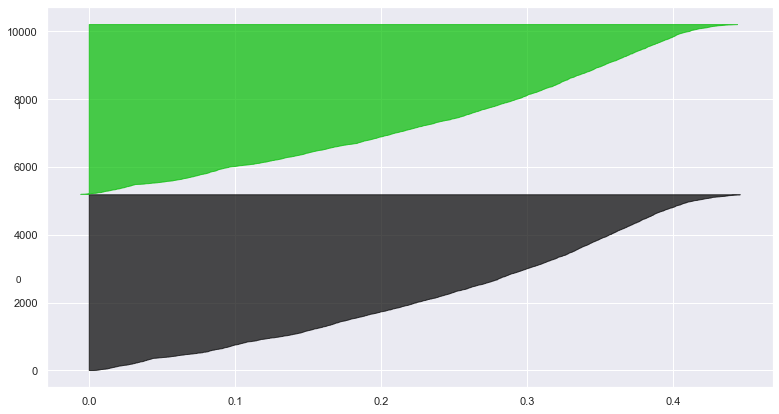

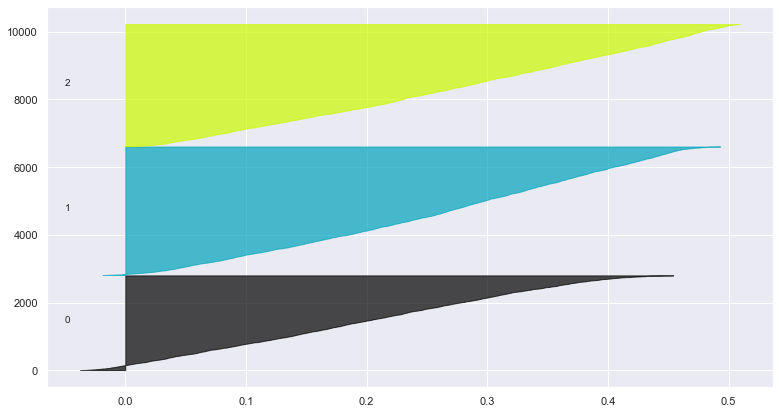

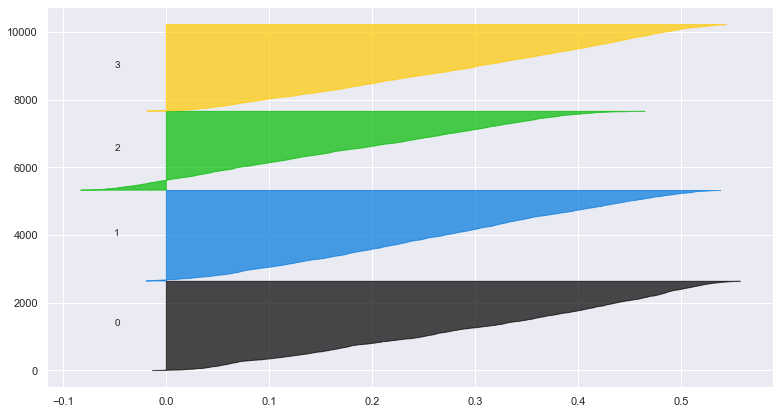

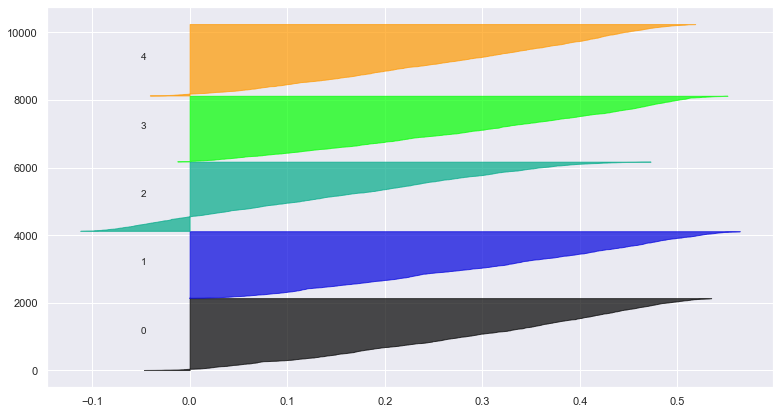

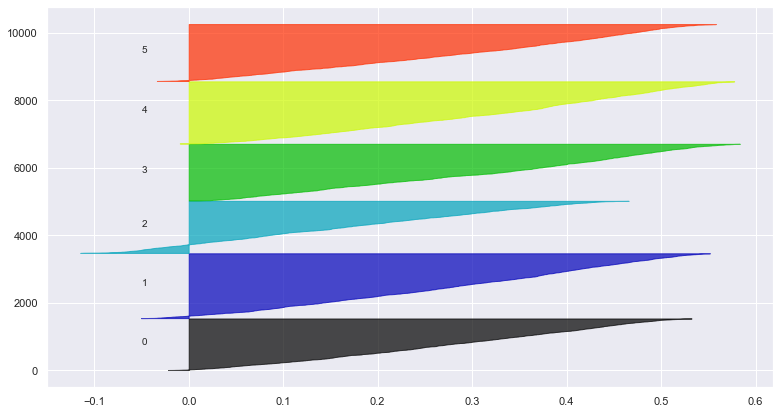

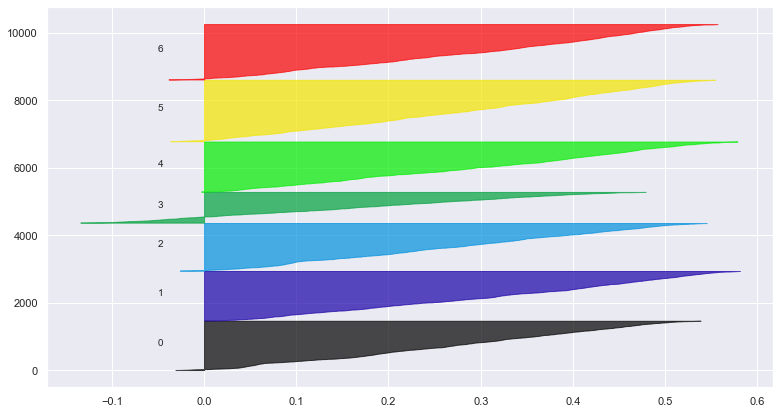

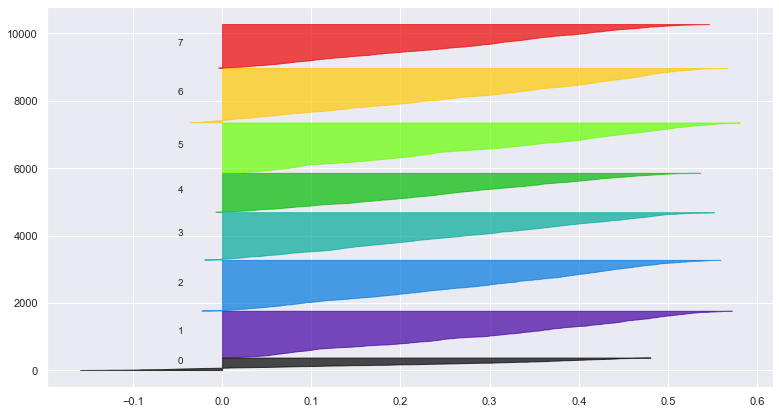

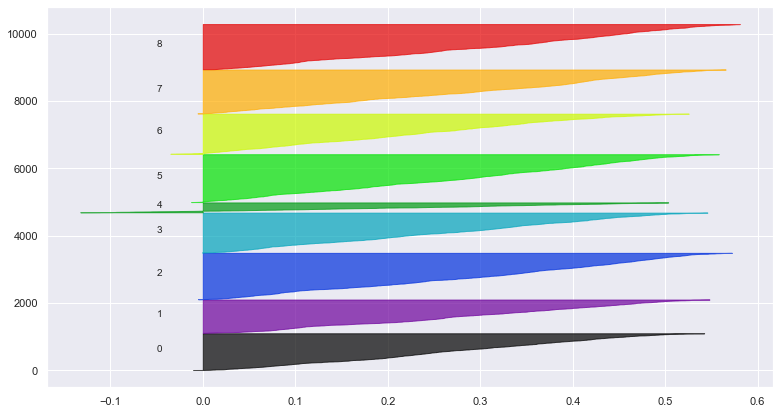

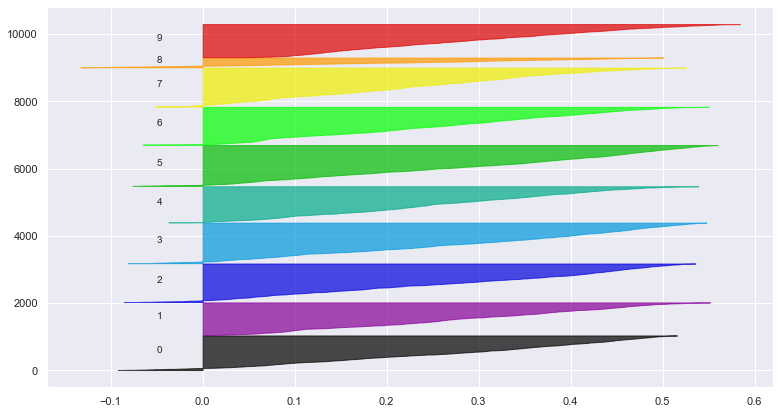

In [190]:
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue
    
    # Create a figure
    fig = plt.figure(figsize=(13, 7))
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(df)

    silhouette_avg = silhouette_score(df, cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(df, cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples


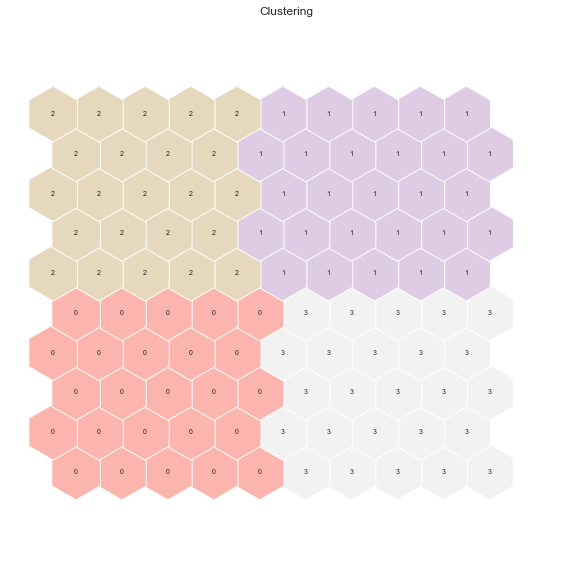

In [191]:
# 4 clusters solution
kmeans_som = KMeans(n_clusters=4, init='k-means++', n_init=20, random_state=10)
kmeans_som_labels = kmeans_som.fit_predict(units)
sm.cluster_labels = kmeans_som_labels 

hits = HitMapView(10, 10,"Clustering", text_size=10)
hits.show(sm, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")
plt.show()

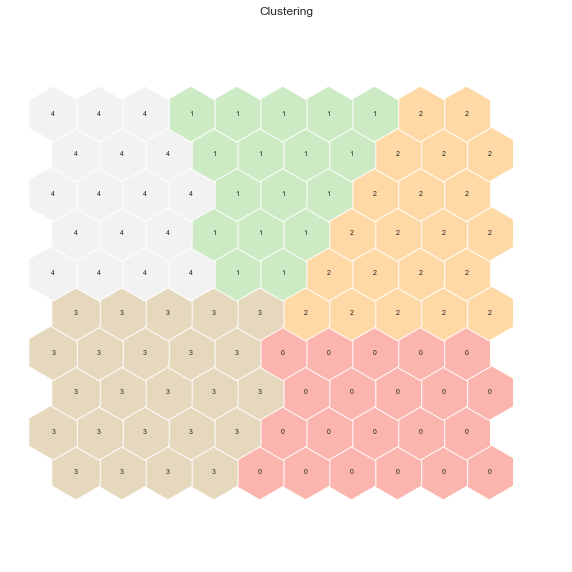

In [192]:
# 5 clusters solution
kmeans_som = KMeans(n_clusters=5, init='k-means++', n_init=20, random_state=10)
kmeans_som_labels = kmeans_som.fit_predict(units)
sm.cluster_labels = kmeans_som_labels 

hits = HitMapView(10, 10,"Clustering", text_size=10)
hits.show(sm, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")
plt.show()

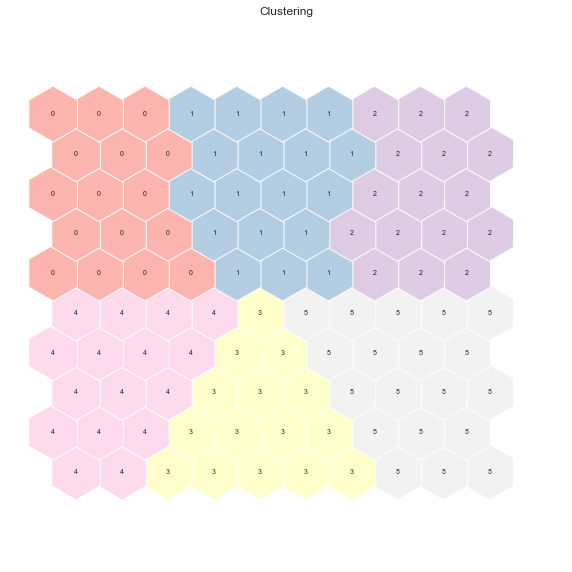

In [193]:
# 6 clusters solution
kmeans_som = KMeans(n_clusters=6, init='k-means++', n_init=20, random_state=10)
kmeans_som_labels = kmeans_som.fit_predict(units)
sm.cluster_labels = kmeans_som_labels 

hits = HitMapView(10, 10,"Clustering", text_size=10)
hits.show(sm, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")
plt.show()

#### Final SOM K-means Clustering solution

In [194]:
# Check the nodes and and respective clusters
nodes = sm.codebook.matrix

df_nodes = pd.DataFrame(nodes, columns=df.columns)
df_nodes['label'] = kmeans_som_labels
df_nodes

# Obtaining SOM's BMUs labels
bmus_map = sm.find_bmu(df)[0]  # get bmus for each observation in df_value

df_value_bmus = pd.DataFrame(
    np.concatenate((df, np.expand_dims(bmus_map,1)), axis=1),
    index=df.index, columns=np.append(df.columns,"BMU"))

# Get cluster labels for each observation
kmeans_5 = df_value_bmus.merge(df_nodes['label'], 'left', left_on="BMU", right_index=True)
kmeans_5.drop(columns='BMU').groupby('label').mean()


,PolYears,MonthSal,CMV
label,,,
0,-0.899470,1.024164,-0.055016
1,-0.939123,-0.627630,-0.703657
2,0.654856,-0.943765,-0.720628
3,0.882995,-0.023303,0.889867
4,-0.561550,-0.722820,1.267461
5,0.965632,0.851674,-0.512219


In [195]:
kmeans_5_labels = kmeans_5['label']

#### R²

In [196]:
# using R²
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

sst = get_ss(kmeans_5[df.columns])  # get total sum of squares
ssw_labels = kmeans_5[(df.columns).to_list() + ["label"]].groupby(by='label').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2_ = ssb / sst
r2_

0.6324384980167888

In [197]:
print(silhouette(df,kmeans_5_labels))

0.2476738302116059


## Density Based Clustering

In [198]:
# Perform DBSCAN clustering
dbscan = DBSCAN(eps=1.9, min_samples=20, n_jobs=4)
dbscan_labels = dbscan.fit_predict(df)

dbscan_n_clusters = len(np.unique(dbscan_labels))
print("Number of estimated clusters : %d" % dbscan_n_clusters)

Number of estimated clusters : 1


#### Define eps and min_samples

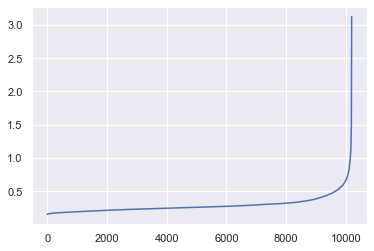

In [199]:
# K-distance graph to find out the right eps value
neigh = NearestNeighbors(n_neighbors=20)
neigh.fit(df)
distances, _ = neigh.kneighbors(df)
distances = np.sort(distances[:, -1])
plt.plot(distances)
plt.show()

In [516]:
# Concatenating the labels to df
df_concat = pd.concat([df, pd.Series(dbscan_labels, index=df.index, name="dbscan_labels")], axis=1)
df_concat.head()

,PolYears,MonthSal,Claims,dbscan_labels
CustID,,,,
1,0.759644,-1.861887,1.382025,0
2,-0.754772,-0.230637,-1.255569,0
3,-0.603330,-1.431645,0.973826,0
4,0.002436,-0.754676,0.691227,0
5,0.002436,0.064008,1.005226,0


In [517]:
# Detecting noise (potential outliers)
df_concat.loc[df_concat['dbscan_labels'] == -1]

,PolYears,MonthSal,Claims,dbscan_labels
CustID,,,,


In [518]:
print(r2(df,dbscan_labels))

0.0


## Mean Shift Clustering

In [519]:
bandwidth = estimate_bandwidth(df, quantile=0.06, random_state=1, n_jobs=-1)
bandwidth

0.9551162977503446

In [520]:
# Perform mean-shift clustering with bandwidth set using estimate_bandwidth
ms = MeanShift(bandwidth=bandwidth, bin_seeding=True, n_jobs=4)
ms_labels = ms.fit_predict(df)

ms_n_clusters = len(np.unique(ms_labels))
print("Number of estimated clusters : %d" % ms_n_clusters)

Number of estimated clusters : 4


In [521]:
# Concatenating the labels to df
df_concat = pd.concat([df, pd.Series(ms_labels, index=df.index, name="ms_labels")], axis=1)
df_concat.head()
df_concat.groupby('ms_labels').mean()


,PolYears,MonthSal,Claims
ms_labels,,,
0,0.046005,-0.196998,0.861815
1,-0.800018,-0.566447,-1.110412
2,1.034026,-0.051157,-0.959793
3,-0.565937,1.167009,-0.319792


In [522]:
print(silhouette(df,ms_labels))
print(r2(df,ms_labels))

0.2169147807576193
0.4693134375858691


## Gaussian Mixture Model (GMM)

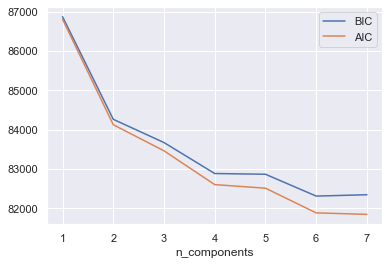

In [523]:
# Selecting number of components based on AIC and BIC
n_components = np.arange(1, 8)
models = [GaussianMixture(n, covariance_type='full', n_init=10, random_state=1).fit(df)
          for n in n_components]

bic_values = [m.bic(df) for m in models]
aic_values = [m.aic(df) for m in models]
plt.plot(n_components, bic_values, label='BIC')
plt.plot(n_components, aic_values, label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components')
plt.xticks(n_components)
plt.show()

In [527]:
# Performing GMM clustering
gmm = GaussianMixture(n_components=5, covariance_type='full', n_init=10, init_params='kmeans', random_state=1)
gmm_labels = gmm.fit_predict(df)

In [528]:
# Concatenating the labels to df
df_concat = pd.concat([df, pd.Series(gmm_labels, index=df.index, name="gmm_labels")], axis=1)
df_concat.head()

,PolYears,MonthSal,Claims,gmm_labels
CustID,,,,
1,0.759644,-1.861887,1.382025,4
2,-0.754772,-0.230637,-1.255569,0
3,-0.603330,-1.431645,0.973826,1
4,0.002436,-0.754676,0.691227,1
5,0.002436,0.064008,1.005226,1


In [529]:
print(silhouette(df,gmm_labels))
print(r2(df,gmm_labels))

0.2650368360332431
0.6001566944446699


## Fuzzy Clustering

In [849]:
my_model = FCM(n_clusters=4) # we use two cluster as an example
my_model.fit(df.values) ## X, numpy array. rows:samples columns:features


In [850]:
centers = my_model.centers
labels = my_model.predict(df.values)


In [851]:
df_concat = pd.concat([df, pd.Series(labels, index=df.index, name="labels")], axis=1)
df_concat.head()


,Motor,Health,Life_sqrt,Work_sqrt,TotalPrem,labels
CustID,,,,,,
1,-1.604871,-0.695743,2.679181,1.497202,0.822207,3
2,-0.667836,-0.589188,1.145752,1.378589,-0.070374,3
3,-0.840185,1.930720,0.078424,-0.115943,-0.803468,1
4,0.296722,0.194240,-0.405199,0.226717,-0.653832,0
5,1.040365,-0.721267,-0.857098,-0.800245,-0.864036,2


In [852]:
# Computing the R^2 of the cluster solution
sst = get_ss(df)  # get total sum of squares
ssw_labels = df_concat.groupby(by='labels').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2_ = ssb / sst
print("Cluster solution with R^2 of %0.4f" % r2_)

Cluster solution with R^2 of 0.5991


In [853]:
print(silhouette(df,labels))

0.2439533370772861


# Clustering on Product value

In [201]:
#df = products_1
df = products_2

## Hierarchical clustering

### Defining the linkage method to choose and number of clusters:

In [936]:
import numpy as np

In [162]:
# ------------------------------------------------------------------
def get_r2_scores(df, clusterer, min_k=1, max_k=6):
    r2_clust = {}
    # Iterate over number of clusters
    for n in range(min_k, max_k+1):
        clust = clone(clusterer).set_params(n_clusters=n)
        labels = clust.fit_predict(df)
        r2_clust[n] = r2(df, labels)
        
    return r2_clust

# Set up the clusterers
kmeans = KMeans(
    init='k-means++',
    n_init=20,
    random_state=42
)

hierarchical = AgglomerativeClustering(
    affinity='euclidean'
)

In [163]:
# Obtaining the R² scores for each cluster solution on demographic variables
r2_scores = {}
r2_scores['kmeans'] = get_r2_scores(df, kmeans)

for linkage in ['complete', 'average', 'single', 'ward']:
    r2_scores[linkage] = get_r2_scores(
        df, hierarchical.set_params(linkage=linkage)
    )

pd.DataFrame(r2_scores)

ValueError: could not convert string to float: 'High_School'

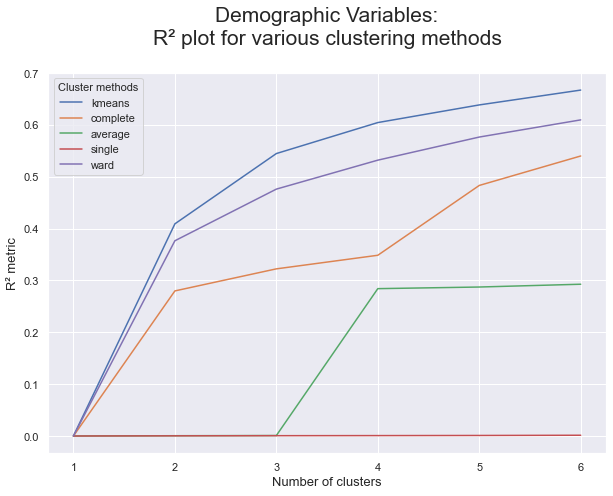

In [939]:
# Visualizing the R² scores for each cluster solution on demographic variables
pd.DataFrame(r2_scores).plot.line(figsize=(10,7))

plt.title("Demographic Variables:\nR² plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.show()

In [940]:
# create the counts of samples under each node (number of points being merged)
def function_linkage(linkage,distance,hclust):
    counts = np.zeros(hclust.children_.shape[0])
    n_samples = len(hclust.labels_)

    for i, merge in enumerate(hclust.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1 
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count
    linkage_matrix = np.column_stack(
        [hclust.children_, hclust.distances_, counts]
    ).astype(float)
    sns.set()
    fig = plt.figure(figsize=(11,5))
    y_threshold = 100
    dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
    plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
    plt.xlabel('Number of points in node (or index of point if no parenthesis)')
    plt.ylabel(f'{distance.title()} Distance', fontsize=13)
    plt.show()

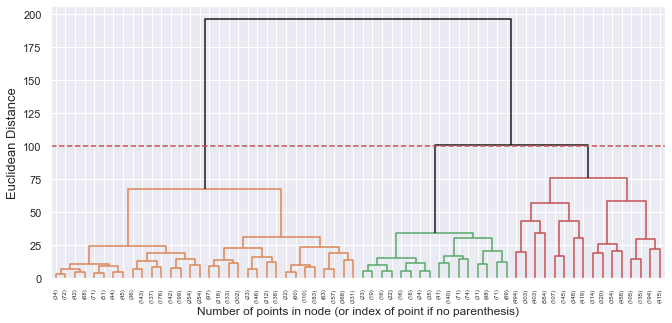

In [941]:
#linkage ward
linkage = 'ward'
distance = 'euclidean'
hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)
hclust.fit_predict(df)

function_linkage(linkage,distance,hclust)

In [942]:
'''#linkage complete
linkage = 'complete'
distance = 'euclidean'
hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)
hclust.fit_predict(df)

function_linkage(linkage,distance,hclust)'''

"#linkage complete\nlinkage = 'complete'\ndistance = 'euclidean'\nhclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)\nhclust.fit_predict(df)\n\nfunction_linkage(linkage,distance,hclust)"

In [943]:
'''#linkage complete
linkage = 'average'
distance = 'euclidean'
hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)
hclust.fit_predict(df)

function_linkage(linkage,distance,hclust)'''

"#linkage complete\nlinkage = 'average'\ndistance = 'euclidean'\nhclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)\nhclust.fit_predict(df)\n\nfunction_linkage(linkage,distance,hclust)"

In [944]:
'''#linkage complete
linkage = 'single'
distance = 'euclidean'
hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)
hclust.fit_predict(df)

function_linkage(linkage,distance,hclust)'''

"#linkage complete\nlinkage = 'single'\ndistance = 'euclidean'\nhclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)\nhclust.fit_predict(df)\n\nfunction_linkage(linkage,distance,hclust)"

### Final Hierarchical clustering solution

In [945]:
# 3 cluster solution
linkage = 'ward'
distance = 'euclidean'
hclust3 = AgglomerativeClustering(linkage=linkage, affinity=distance, n_clusters=3)
hc_labels3 = hclust3.fit_predict(df)

In [946]:
## Characterizing the 3 clusters
df_concat3 = pd.concat((df, pd.Series(hc_labels3, name='labels', index = df.index)), axis=1)
df_concat3.groupby('labels').mean()

,Motor,Health,Life_sqrt,Work_sqrt,Household_sqrt
labels,,,,,
0,-0.565692,0.649238,0.229046,0.305870,0.337980
1,0.945267,-0.691579,-0.619222,-0.630890,-0.630570
2,-1.573125,-0.411424,1.969971,1.525776,1.310827


In [947]:
print(silhouette(df,hc_labels3))
print(r2(df,hc_labels3))

0.28454264610423335
0.4760835740732352


In [948]:
#number of observations in each cluster
labels = hclust.labels_
counts = np.bincount(labels[labels>=0])
counts

array([1, 1, 1, ..., 1, 1, 1], dtype=int64)

## K-means clustering

### Defining the number of clusters:

In [949]:
range_clusters = range(1, 11)

In [950]:
inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
    kmclust.fit(df)
    inertia.append(kmclust.inertia_)  # save the inertia of the given cluster solution

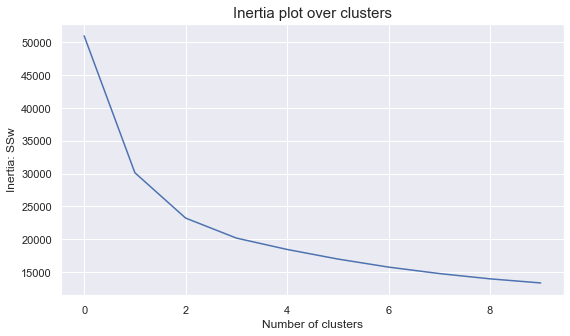

In [951]:
# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(inertia)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

For n_clusters = 2, the average silhouette_score is : 0.35072754965521774
For n_clusters = 3, the average silhouette_score is : 0.30590762003324323
For n_clusters = 4, the average silhouette_score is : 0.2487088875463831
For n_clusters = 5, the average silhouette_score is : 0.24112142670323689
For n_clusters = 6, the average silhouette_score is : 0.2294581808404589
For n_clusters = 7, the average silhouette_score is : 0.2307657239652707
For n_clusters = 8, the average silhouette_score is : 0.20504098681267488
For n_clusters = 9, the average silhouette_score is : 0.20012950333856522
For n_clusters = 10, the average silhouette_score is : 0.19932549709833655


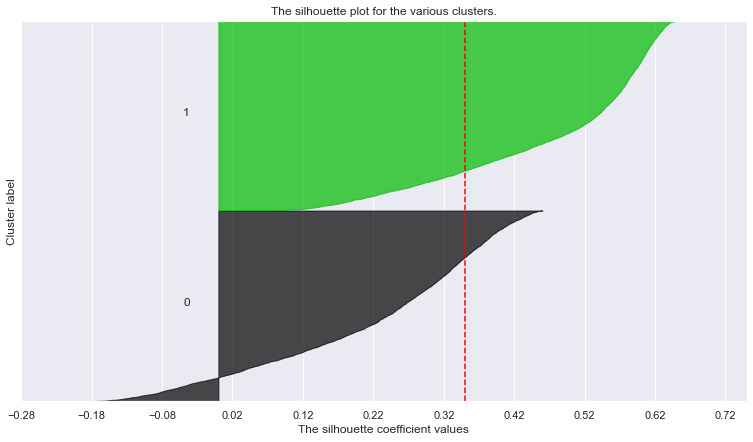

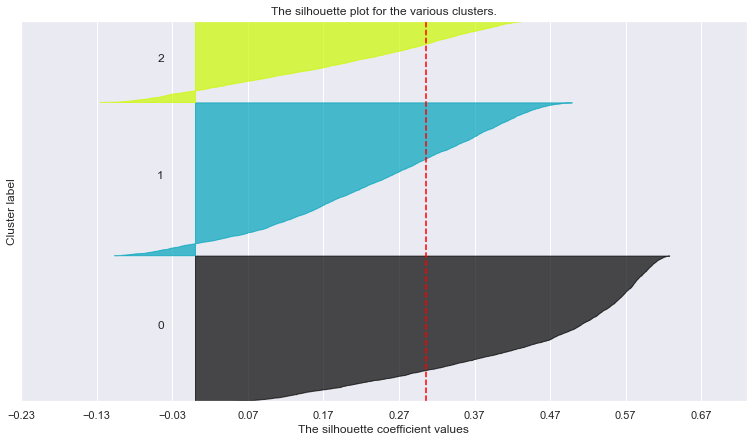

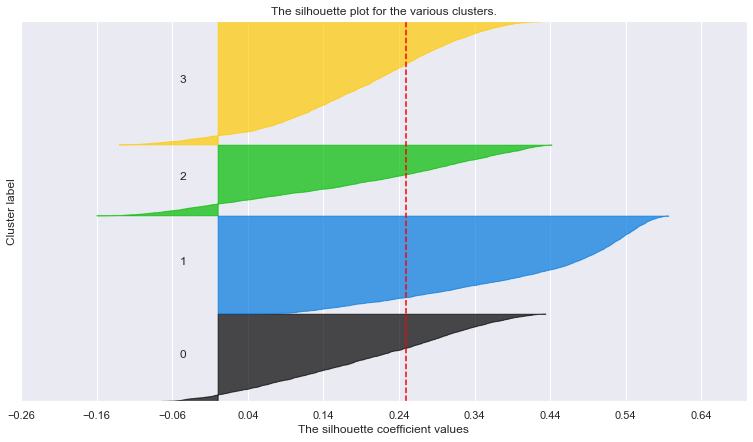

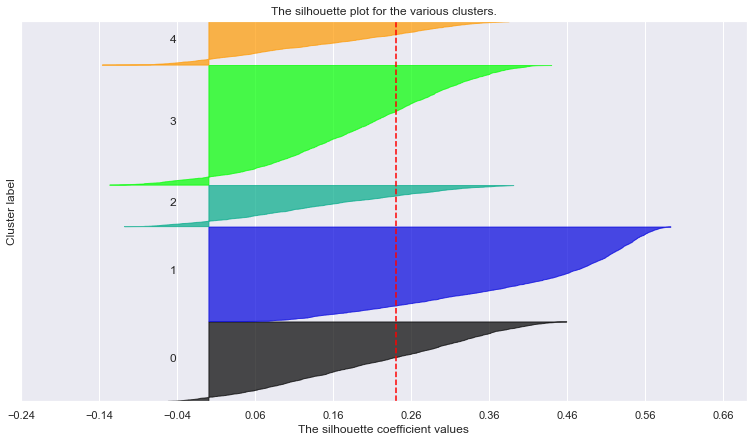

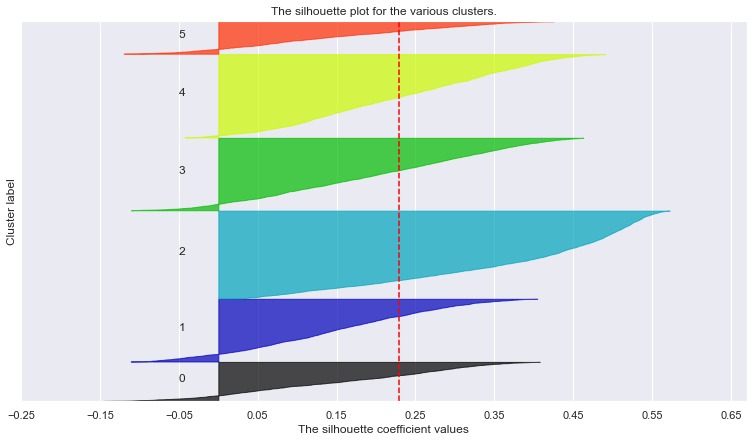

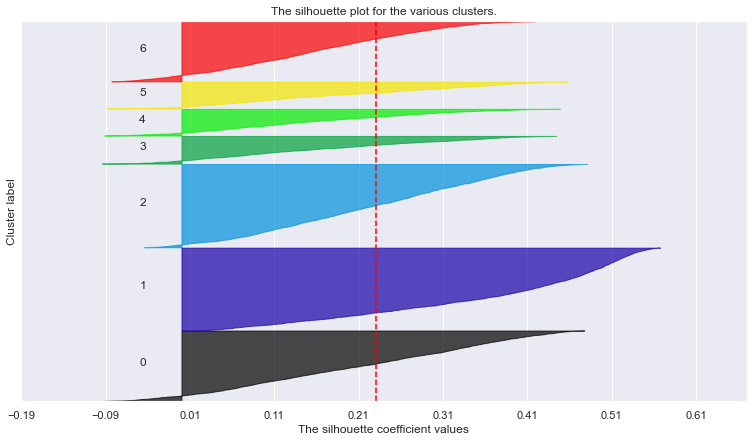

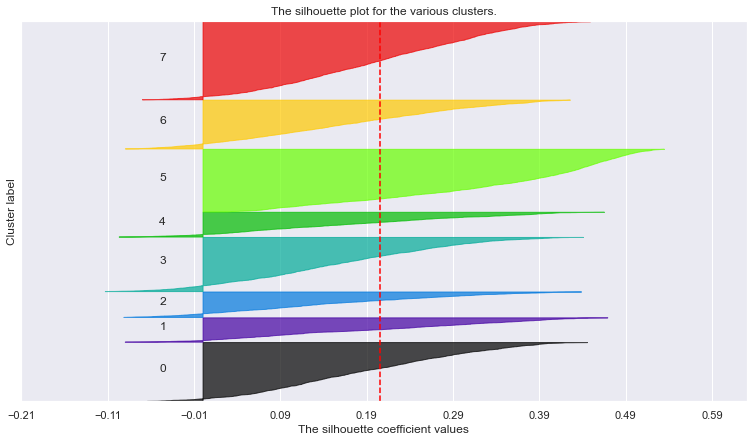

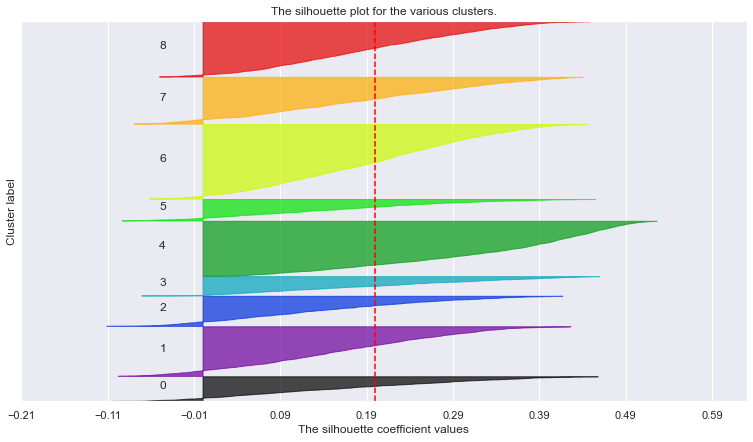

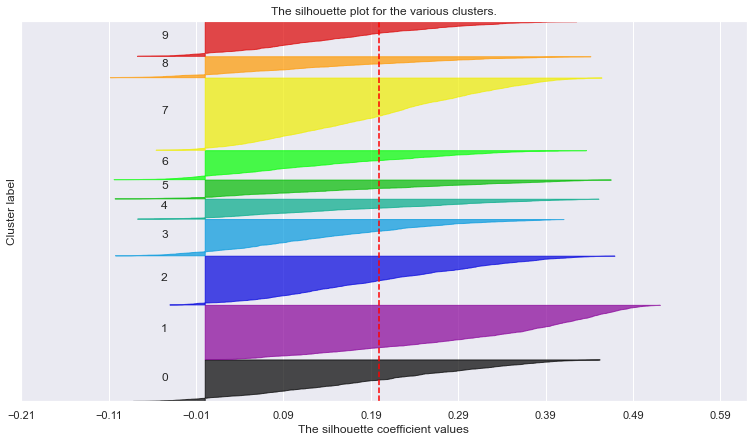

In [952]:
# Storing average silhouette metric
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue
    
    # Create a figure
    fig = plt.figure(figsize=(13, 7))
    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(df)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(df, cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(df, cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    plt.title("The silhouette plot for the various clusters.")
    plt.xlabel("The silhouette coefficient values")
    plt.ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    plt.axvline(x=silhouette_avg, color="red", linestyle="--")
    
    # The silhouette coefficient can range from -1, 1
    xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
    plt.xlim([xmin, xmax])
    
    # The (nclus+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    plt.ylim([0, len(df) + (nclus + 1) * 10])

    plt.yticks([])  # Clear the yaxis labels / ticks
    plt.xticks(np.arange(xmin, xmax, 0.1))

### Final KMeans clustering solution

In [953]:
#the best solution with 2 or 3 clusters

In [954]:
# final cluster solution
number_clusters = 2
kmclust2 = KMeans(n_clusters=number_clusters, init='k-means++', n_init=15, random_state=1)
km_labels2 = kmclust2.fit_predict(df)
km_labels2

array([0, 0, 0, ..., 1, 0, 1])

In [955]:
# Characterizing the final clusters
df_concat2 = pd.concat((df, pd.Series(km_labels2, name='labels',index = df.index)), axis=1)
df_concat2.groupby('labels').mean()

,Motor,Health,Life_sqrt,Work_sqrt,Household_sqrt
labels,,,,,
0,-0.826322,0.518309,0.608954,0.601566,0.588167
1,0.832669,-0.522290,-0.613631,-0.606186,-0.592684


In [956]:
print(silhouette(df,km_labels2))
print(r2(df,km_labels2))

0.35072754965521774
0.4091383515826088


In [957]:
# final cluster solution
number_clusters = 3
kmclust3 = KMeans(n_clusters=number_clusters, init='k-means++', n_init=15, random_state=1)
km_labels3 = kmclust3.fit_predict(df)
km_labels3

array([2, 2, 1, ..., 0, 2, 0])

In [958]:
# Characterizing the final clusters
df_concat3 = pd.concat((df, pd.Series(km_labels3, name='labels',index = df.index)), axis=1)
df_concat3.groupby('labels').mean()

,Motor,Health,Life_sqrt,Work_sqrt,Household_sqrt
labels,,,,,
0,1.034154,-0.804920,-0.692775,-0.680554,-0.664131
1,-0.350703,0.801861,0.025031,0.027666,-0.014850
2,-1.196781,-0.068637,1.198643,1.171679,1.222539


In [959]:
print(silhouette(df,km_labels3))
print(r2(df,km_labels3))

0.30590762003324323
0.544656116741365


## SOM clustering

### SOM Algorithm

In [960]:
np.random.seed(42)

# Notice that the SOM did not converge - We're under a time constraint for this class
sm = sompy.SOMFactory().build(
        df.values, 
        mapsize=[25, 25],  # HOW MANY UNITS TO USE ???
        initialization='random',
        neighborhood='gaussian',
        training='batch',
        lattice='hexa',
        normalization=False,
        component_names=df.columns
)
sm.train(n_job=-1, verbose='info', train_rough_len=125, train_finetune_len=110)  ## TUNE THESE PARAMETERS !!!

 Training...
 random_initialization took: 0.003000 seconds
 Rough training...
 radius_ini: 9.000000 , radius_final: 1.500000, trainlen: 125

 epoch: 1 ---> elapsed time:  0.120000, quantization error: 1.037825

 epoch: 2 ---> elapsed time:  0.079000, quantization error: 2.038672

 epoch: 3 ---> elapsed time:  0.078000, quantization error: 1.982671

 epoch: 4 ---> elapsed time:  0.075000, quantization error: 1.932262

 epoch: 5 ---> elapsed time:  0.080000, quantization error: 1.915979

 epoch: 6 ---> elapsed time:  0.074000, quantization error: 1.913942

 epoch: 7 ---> elapsed time:  0.073000, quantization error: 1.912119

 epoch: 8 ---> elapsed time:  0.068000, quantization error: 1.910276

 epoch: 9 ---> elapsed time:  0.066000, quantization error: 1.908405

 epoch: 10 ---> elapsed time:  0.066000, quantization error: 1.906500

 epoch: 11 ---> elapsed time:  0.068000, quantization error: 1.904555

 epoch: 12 ---> elapsed time:  0.068000, quantization error: 1.902576

 epoch: 13 ---> 

 epoch: 115 ---> elapsed time:  0.063000, quantization error: 1.066365

 epoch: 116 ---> elapsed time:  0.063000, quantization error: 1.050579

 epoch: 117 ---> elapsed time:  0.063000, quantization error: 1.034458

 epoch: 118 ---> elapsed time:  0.070000, quantization error: 1.017758

 epoch: 119 ---> elapsed time:  0.072000, quantization error: 1.000677

 epoch: 120 ---> elapsed time:  0.063000, quantization error: 0.982725

 epoch: 121 ---> elapsed time:  0.079000, quantization error: 0.963916

 epoch: 122 ---> elapsed time:  0.051000, quantization error: 0.943843

 epoch: 123 ---> elapsed time:  0.063000, quantization error: 0.922542

 epoch: 124 ---> elapsed time:  0.063000, quantization error: 0.900271

 epoch: 125 ---> elapsed time:  0.063000, quantization error: 0.877167

 Finetune training...
 radius_ini: 2.083333 , radius_final: 1.000000, trainlen: 110

 epoch: 1 ---> elapsed time:  0.077000, quantization error: 0.853624

 epoch: 2 ---> elapsed time:  0.063000, quantization 

 epoch: 105 ---> elapsed time:  0.064000, quantization error: 0.657045

 epoch: 106 ---> elapsed time:  0.061000, quantization error: 0.652726

 epoch: 107 ---> elapsed time:  0.062000, quantization error: 0.648451

 epoch: 108 ---> elapsed time:  0.062000, quantization error: 0.644123

 epoch: 109 ---> elapsed time:  0.061000, quantization error: 0.639780

 epoch: 110 ---> elapsed time:  0.061000, quantization error: 0.635227

 Final quantization error: 0.630680
 train took: 16.391000 seconds


### Component Planes

In [961]:
'''# Visualizing the Component planes (feature values)
sns.set()
view2D = View2D(12, 12, "", text_size=10)

view2D.show(sm, col_sz=2, what='codebook')

plt.subplots_adjust(top=0.90)
plt.suptitle("Component Planes", fontsize=20)
plt.show()'''

'# Visualizing the Component planes (feature values)\nsns.set()\nview2D = View2D(12, 12, "", text_size=10)\n\nview2D.show(sm, col_sz=2, what=\'codebook\')\n\nplt.subplots_adjust(top=0.90)\nplt.suptitle("Component Planes", fontsize=20)\nplt.show()'

### U-Matrix

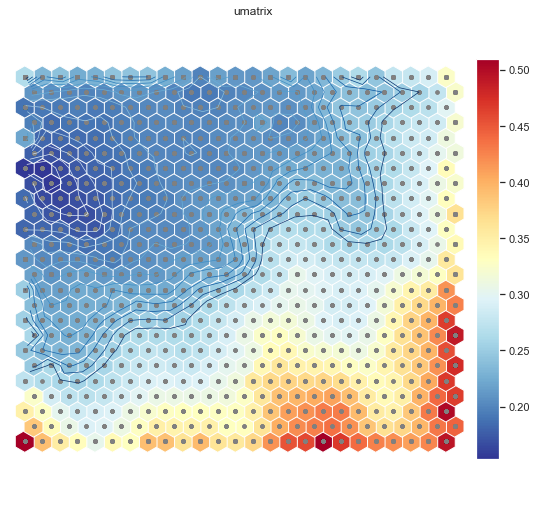

In [962]:
# Here you have U-matrix
u = sompy.umatrix.UMatrixView(9, 9, 'umatrix', show_axis=True, text_size=8, show_text=True)

UMAT = u.show(
    sm, 
    distance=2, 
    row_normalized=False,
    show_data=True, 
    contour=True, # Visualize isomorphic curves
    blob=False
)

# np.flip(UMAT[1], axis=1) # U-matrix values - they match with the plot colors

### Hit Map

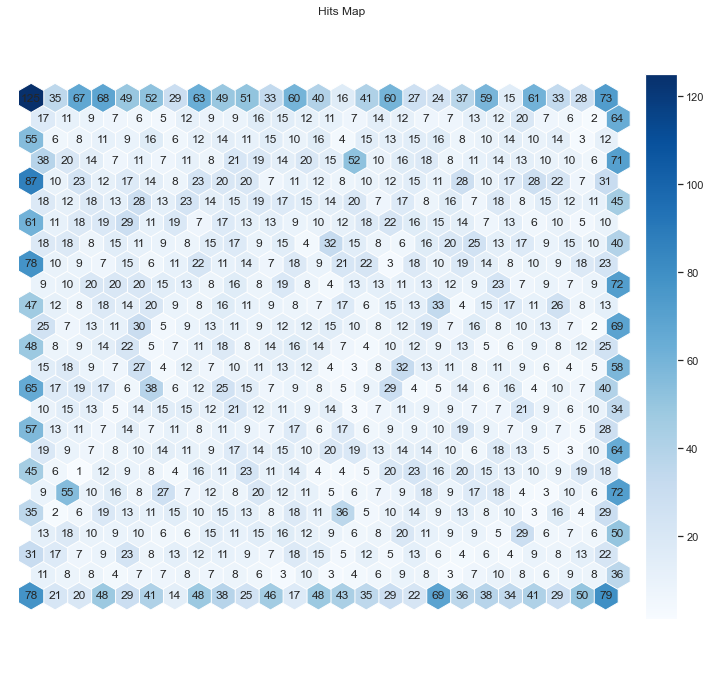

In [963]:
vhts  = BmuHitsView(12,12,"Hits Map")
vhts.show(sm, anotate=True, onlyzeros=False, labelsize=12, cmap="Blues")
plt.show()

### Hierarchical Clustering using SOM

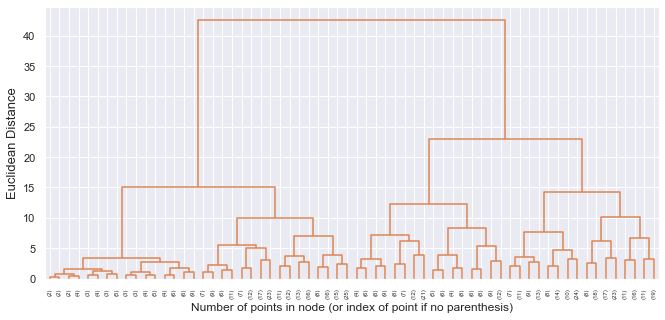

In [964]:
units = sm.codebook.matrix

linkage = 'ward'
distance = 'euclidean'
hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)
hclust.fit_predict(units)

function_linkage(linkage,distance,hclust)


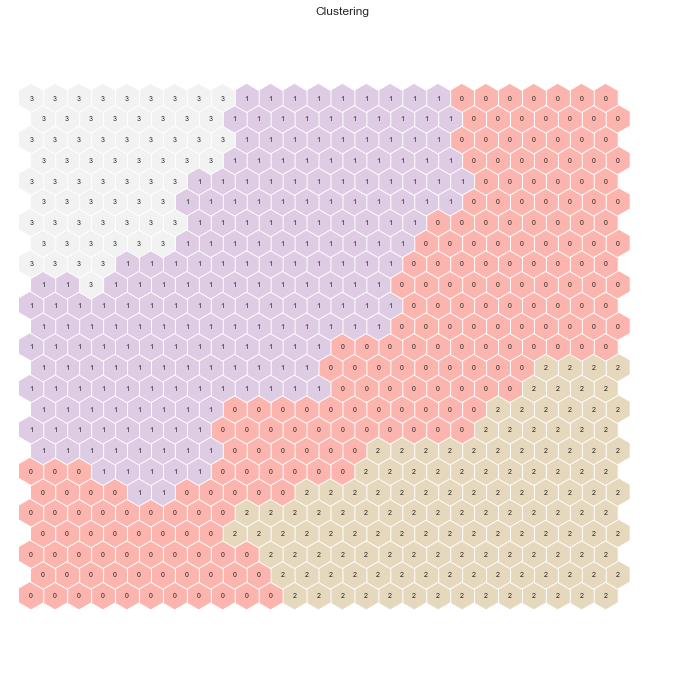

In [975]:
# Perform Hierarchical clustering on top of the 2500 untis (sm.get_node_vectors() output)
hierclust = AgglomerativeClustering(n_clusters=4, linkage='ward')
nodeclus_labels = hierclust.fit_predict(sm.codebook.matrix)
sm.cluster_labels = nodeclus_labels  # setting the cluster labels of sompy

hits  = HitMapView(12, 12,"Clustering",text_size=10)
hits.show(sm, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

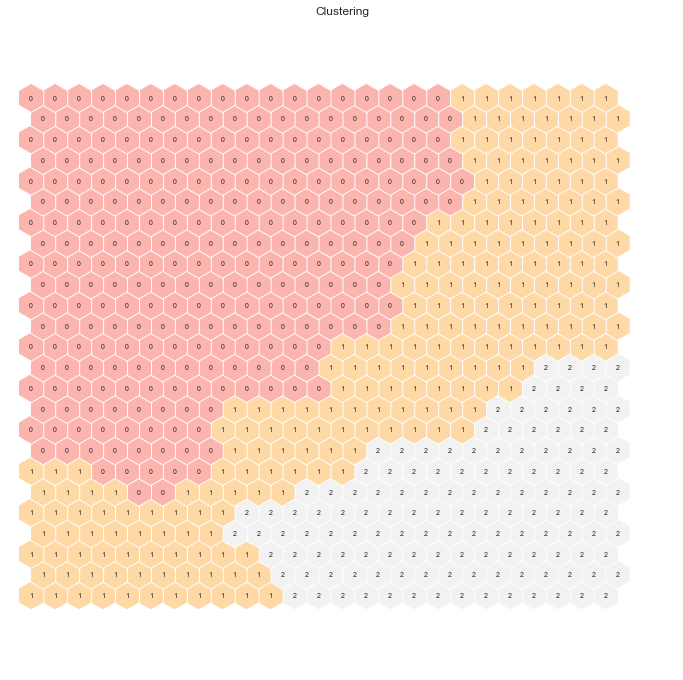

In [966]:
hierclust = AgglomerativeClustering(n_clusters=3, linkage='ward')
nodeclus_labels = hierclust.fit_predict(sm.codebook.matrix)
sm.cluster_labels = nodeclus_labels  # setting the cluster labels of sompy

hits  = HitMapView(12, 12,"Clustering",text_size=10)
hits.show(sm, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

#### Final SOM Hierarquical Clustering solution

In [967]:
#best solution -- 4 clusters

In [976]:
hierclust = AgglomerativeClustering(n_clusters=4, linkage='ward')
nodeclus_labels = hierclust.fit_predict(sm.codebook.matrix)
sm.cluster_labels = nodeclus_labels


In [977]:
# Check the nodes and and respective clusters
nodes = sm.codebook.matrix

df_nodes = pd.DataFrame(nodes, columns=df.columns)
df_nodes['label'] = nodeclus_labels
df_nodes

# Obtaining SOM's BMUs labels
bmus_map = sm.find_bmu(df)[0]  # get bmus for each observation in df_value

df_value_bmus = pd.DataFrame(
    np.concatenate((df, np.expand_dims(bmus_map,1)), axis=1),
    index=df.index, columns=np.append(df.columns,"BMU"))

# Get cluster labels for each observation
hierarc_4 = df_value_bmus.merge(df_nodes['label'], 'left', left_on="BMU", right_index=True)
hierarc_4.drop(columns='BMU').groupby('label').mean()


,Motor,Health,Life_sqrt,Work_sqrt,Household_sqrt
label,,,,,
0,-0.483339,0.765144,0.276924,0.062372,0.177373
1,0.610461,-0.217794,-0.494040,-0.495847,-0.456796
2,-1.167682,-0.000654,0.991338,1.333507,1.090857
3,1.466084,-1.297984,-0.989694,-0.971496,-0.977691


In [978]:
hierarc_4_labels = hierarc_4['label']

#### R²

In [979]:
# using R²
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

sst = get_ss(hierarc_4[df.columns])  # get total sum of squares
ssw_labels = hierarc_4[(df.columns).to_list() + ["label"]].groupby(by='label').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2_ = ssb / sst
r2_

0.5497702394666995

In [980]:
print(silhouette(df,hierarc_4_labels))

0.17460988328845603


### K-means

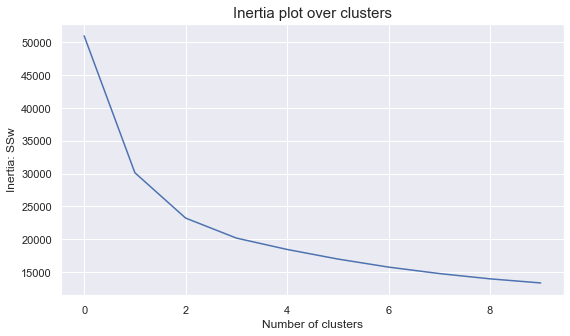

In [973]:
inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
    kmclust.fit(df)
    inertia.append(kmclust.inertia_)  # save the inertia of the given cluster solution
    
# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(inertia)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

For n_clusters = 2, the average silhouette_score is : 0.35072754965521774
For n_clusters = 3, the average silhouette_score is : 0.30590762003324323
For n_clusters = 4, the average silhouette_score is : 0.2487088875463831
For n_clusters = 5, the average silhouette_score is : 0.24112142670323689
For n_clusters = 6, the average silhouette_score is : 0.2294581808404589
For n_clusters = 7, the average silhouette_score is : 0.2307657239652707
For n_clusters = 8, the average silhouette_score is : 0.20504098681267488
For n_clusters = 9, the average silhouette_score is : 0.20012950333856522
For n_clusters = 10, the average silhouette_score is : 0.19932549709833655


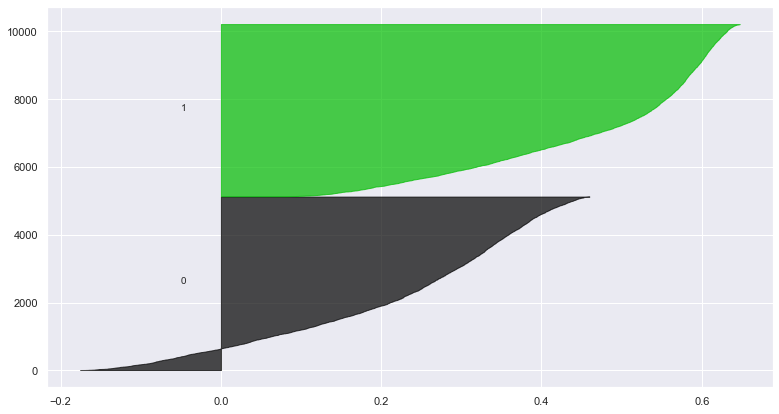

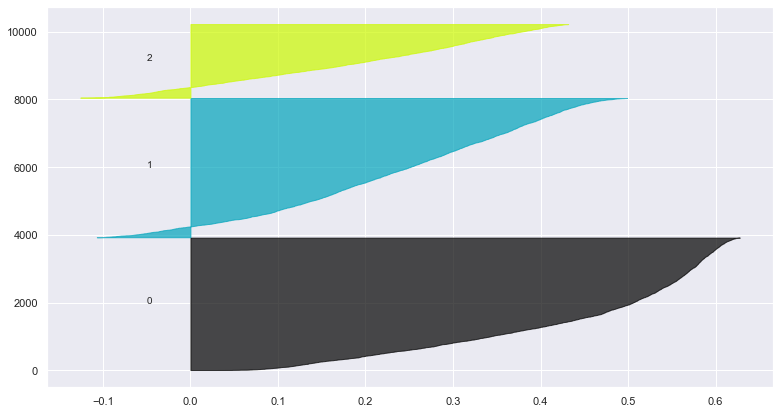

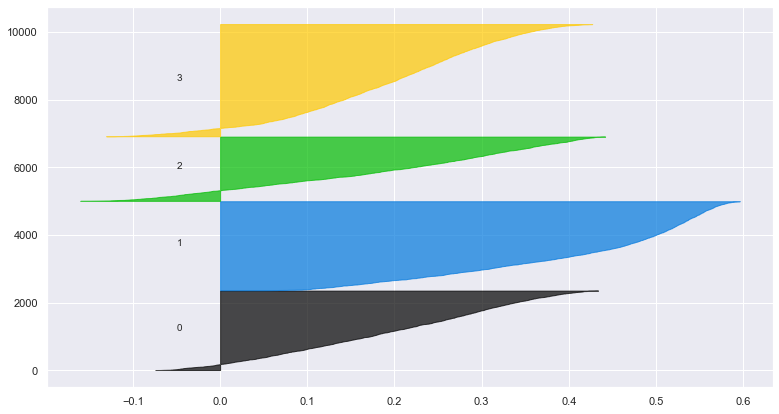

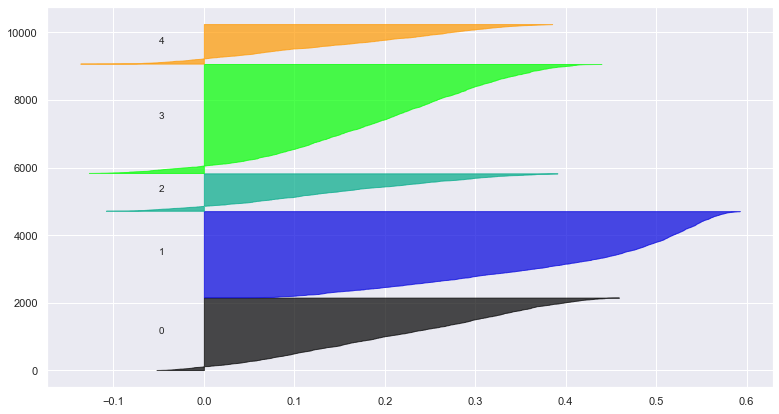

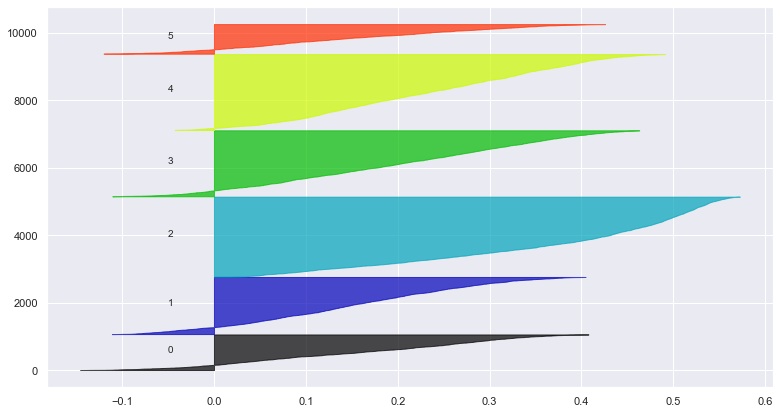

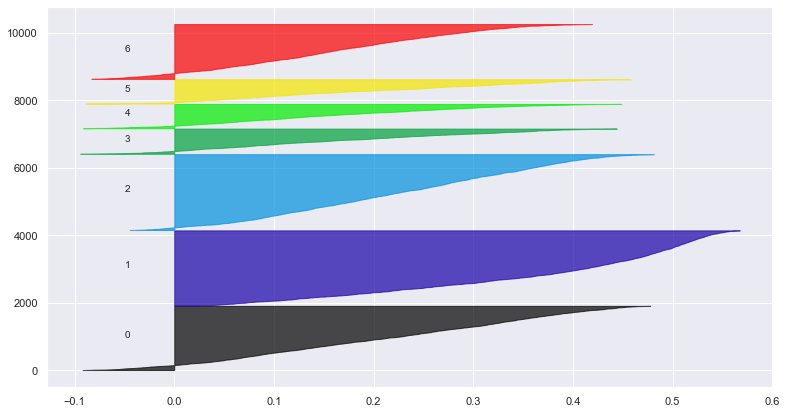

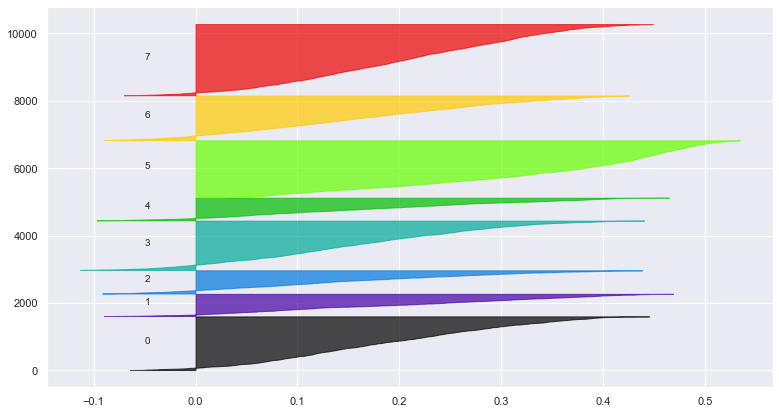

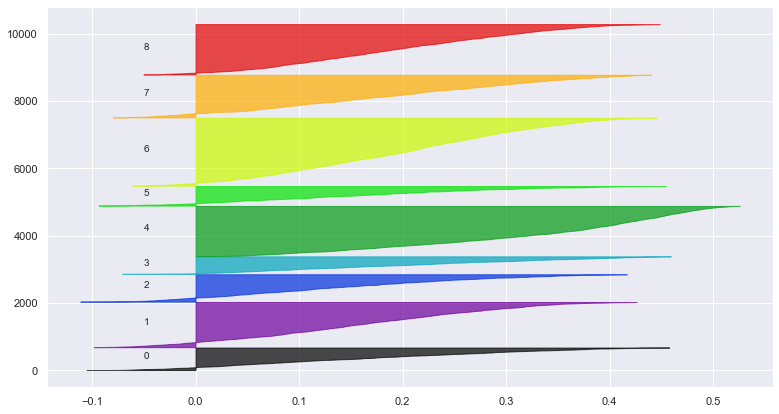

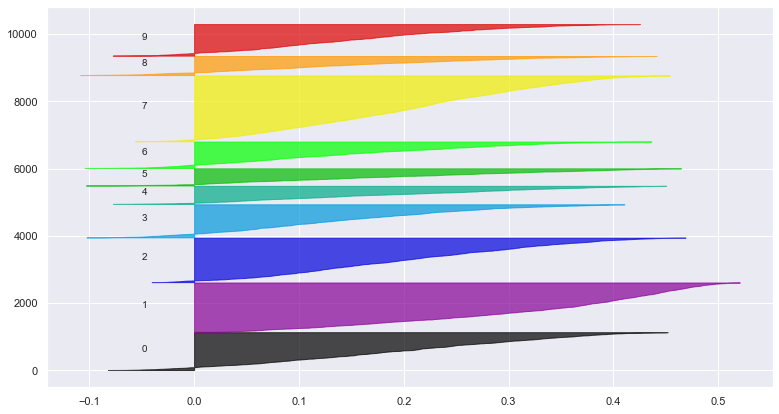

In [974]:
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue
    
    # Create a figure
    fig = plt.figure(figsize=(13, 7))
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(df)
    silhouette_avg = silhouette_score(df, cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(df, cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples


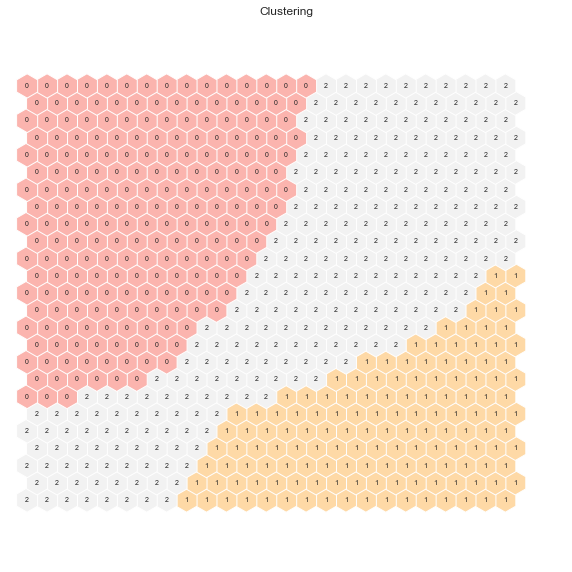

In [808]:
# 3 clusters solution
kmeans_som = KMeans(n_clusters=3, init='k-means++', n_init=20, random_state=10)
kmeans_som_labels = kmeans_som.fit_predict(units)
sm.cluster_labels = kmeans_som_labels 

hits = HitMapView(10, 10,"Clustering", text_size=10)
hits.show(sm, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")
plt.show()

#### Final SOM K-means Clustering solution

In [806]:
# Check the nodes and and respective clusters
nodes = sm.codebook.matrix

df_nodes = pd.DataFrame(nodes, columns=df.columns)
df_nodes['label'] = kmeans_som_labels
df_nodes

# Obtaining SOM's BMUs labels
bmus_map = sm.find_bmu(df)[0]  # get bmus for each observation in df_value

df_value_bmus = pd.DataFrame(
    np.concatenate((df, np.expand_dims(bmus_map,1)), axis=1),
    index=df.index, columns=np.append(df.columns,"BMU"))

# Get cluster labels for each observation
kmeans_3 = df_value_bmus.merge(df_nodes['label'], 'left', left_on="BMU", right_index=True)
kmeans_3.drop(columns='BMU').groupby('label').mean()


,Motor,Health,Life_sqrt,Work_sqrt,TotalPrem
label,,,,,
0,0.776229,-0.457085,-0.594721,-0.591107,-0.494930
1,-0.864587,0.509115,0.662417,0.658392,0.551268


#### R²

In [807]:
# using R²
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

sst = get_ss(kmeans_3[df.columns])  # get total sum of squares
ssw_labels = kmeans_3[(df.columns).to_list() + ["label"]].groupby(by='label').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2_ = ssb / sst
r2_

0.3919599097557951

## Density Based Clustering

In [809]:
# Perform DBSCAN clustering
dbscan = DBSCAN(eps=1.9, min_samples=20, n_jobs=4)
dbscan_labels = dbscan.fit_predict(df)

dbscan_n_clusters = len(np.unique(dbscan_labels))
print("Number of estimated clusters : %d" % dbscan_n_clusters)

Number of estimated clusters : 2


#### Define eps and min_samples

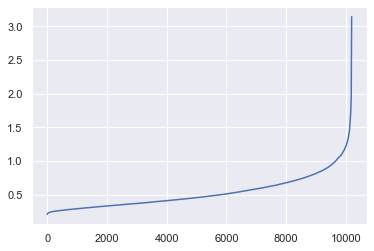

In [810]:
# K-distance graph to find out the right eps value
neigh = NearestNeighbors(n_neighbors=20)
neigh.fit(df)
distances, _ = neigh.kneighbors(df)
distances = np.sort(distances[:, -1])
plt.plot(distances)
plt.show()

In [811]:
# Concatenating the labels to df
df_concat = pd.concat([df, pd.Series(dbscan_labels, index=df.index, name="dbscan_labels")], axis=1)
df_concat.head()

,Motor,Health,Life_sqrt,Work_sqrt,TotalPrem,dbscan_labels
CustID,,,,,,
1,-1.604871,-0.695743,2.679181,1.497202,0.822207,0
2,-0.667836,-0.589188,1.145752,1.378589,-0.070374,0
3,-0.840185,1.930720,0.078424,-0.115943,-0.803468,0
4,0.296722,0.194240,-0.405199,0.226717,-0.653832,0
5,1.040365,-0.721267,-0.857098,-0.800245,-0.864036,0


In [812]:
# Detecting noise (potential outliers)
df_concat.loc[df_concat['dbscan_labels'] == -1]

,Motor,Health,Life_sqrt,Work_sqrt,TotalPrem,dbscan_labels
CustID,,,,,,
1054,-2.062867,-1.606794,0.340236,1.744912,6.575466,-1
2300,-1.884037,-1.633804,-0.508236,1.084623,7.272513,-1
4336,-1.782899,-1.344120,-1.006516,1.189290,6.738515,-1
8297,-2.069347,-1.570735,-0.508236,1.378589,7.044286,-1
8597,-1.947967,-1.768854,0.025803,1.367218,7.175218,-1
9158,-2.062867,-1.606794,0.340236,1.744912,6.575466,-1


In [813]:
print(r2(df,dbscan_labels))

0.006598256912532352


## Mean Shift Clustering

In [814]:
# The following bandwidth can be automatically detected using (we need to set quantile though)
# Based on distance to nearest neighbors for all observations
bandwidth = estimate_bandwidth(df, quantile=0.06, random_state=1, n_jobs=-1)
bandwidth

1.2540580474001697

In [815]:
# Perform mean-shift clustering with bandwidth set using estimate_bandwidth
ms = MeanShift(bandwidth=bandwidth, bin_seeding=True, n_jobs=-1)
ms_labels = ms.fit_predict(df)

ms_n_clusters = len(np.unique(ms_labels))
print("Number of estimated clusters : %d" % ms_n_clusters)

Number of estimated clusters : 7


In [816]:
# Concatenating the labels to df
df_concat = pd.concat([df, pd.Series(ms_labels, index=df.index, name="ms_labels")], axis=1)
df_concat.head()

,Motor,Health,Life_sqrt,Work_sqrt,TotalPrem,ms_labels
CustID,,,,,,
1,-1.604871,-0.695743,2.679181,1.497202,0.822207,1
2,-0.667836,-0.589188,1.145752,1.378589,-0.070374,0
3,-0.840185,1.930720,0.078424,-0.115943,-0.803468,0
4,0.296722,0.194240,-0.405199,0.226717,-0.653832,0
5,1.040365,-0.721267,-0.857098,-0.800245,-0.864036,0


In [817]:
print(silhouette(df,ms_labels))
print(r2(df,ms_labels))

0.28559539460892247
0.25094320801586223


## Gaussian Mixture Model (GMM)

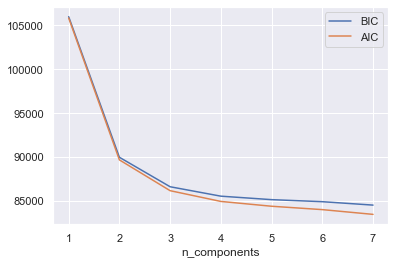

In [818]:
# Selecting number of components based on AIC and BIC
n_components = np.arange(1, 8)
models = [GaussianMixture(n, covariance_type='full', n_init=10, random_state=1).fit(df)
          for n in n_components]

bic_values = [m.bic(df) for m in models]
aic_values = [m.aic(df) for m in models]
plt.plot(n_components, bic_values, label='BIC')
plt.plot(n_components, aic_values, label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components')
plt.xticks(n_components)
plt.show()

In [822]:
# Performing GMM clustering
gmm = GaussianMixture(n_components=4, covariance_type='full', n_init=10, init_params='kmeans', random_state=1)
gmm_labels = gmm.fit_predict(df)

In [823]:
# Concatenating the labels to df
df_concat = pd.concat([df, pd.Series(gmm_labels, index=df.index, name="gmm_labels")], axis=1)
df_concat.head()

,Motor,Health,Life_sqrt,Work_sqrt,TotalPrem,gmm_labels
CustID,,,,,,
1,-1.604871,-0.695743,2.679181,1.497202,0.822207,1
2,-0.667836,-0.589188,1.145752,1.378589,-0.070374,1
3,-0.840185,1.930720,0.078424,-0.115943,-0.803468,0
4,0.296722,0.194240,-0.405199,0.226717,-0.653832,2
5,1.040365,-0.721267,-0.857098,-0.800245,-0.864036,2


In [824]:
print(silhouette(df,gmm_labels))
print(r2(df,gmm_labels))

0.24055284166805627
0.47345985231239474


## Fuzzy Clustering

In [826]:
from fcmeans import FCM

In [832]:
my_model = FCM(n_clusters=4) 
my_model.fit(df.values) ## X, numpy array. rows:samples columns:features

In [833]:
centers = my_model.centers
labels = my_model.predict(df.values)

In [834]:
df_concat = pd.concat([df, pd.Series(labels, index=df.index, name="labels")], axis=1)
df_concat.head()


,Motor,Health,Life_sqrt,Work_sqrt,TotalPrem,labels
CustID,,,,,,
1,-1.604871,-0.695743,2.679181,1.497202,0.822207,0
2,-0.667836,-0.589188,1.145752,1.378589,-0.070374,0
3,-0.840185,1.930720,0.078424,-0.115943,-0.803468,2
4,0.296722,0.194240,-0.405199,0.226717,-0.653832,2
5,1.040365,-0.721267,-0.857098,-0.800245,-0.864036,1


In [835]:
# Computing the R^2 of the cluster solution
sst = get_ss(df)  # get total sum of squares
ssw_labels = df_concat.groupby(by='labels').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2_ = ssb / sst
print("Cluster solution with R^2 of %0.4f" % r2_)


Cluster solution with R^2 of 0.5411


In [836]:
print(silhouette(df,labels))

0.30620347747271676


# Merge Perspectives

In [489]:
df_value = value_2

In [490]:
df_products = products_2

In [491]:
df_final = pd.concat([df_value, df_products], axis=1)
final_features = df_final.columns
df_final.head(3)

,PolYears,MonthSal,Claims,Motor,Health,Life_sqrt,Work_sqrt,TotalPrem
CustID,,,,,,,,
1,0.759644,-1.861887,1.382025,-1.604871,-0.695743,2.679181,1.497202,0.822207
2,-0.754772,-0.230637,-1.255569,-0.667836,-0.589188,1.145752,1.378589,-0.070374
3,-0.603330,-1.431645,0.973826,-0.840185,1.930720,0.078424,-0.115943,-0.803468


In [492]:
#VALUE 2
# Performing GMM clustering
gmm = GaussianMixture(n_components=5, covariance_type='full', n_init=10, init_params='kmeans', random_state=1)
gmm_labels = gmm.fit_predict(df_value)

In [493]:
#PRODUCT 2
# final cluster solution
number_clusters = 3
kmclust3 = KMeans(n_clusters=number_clusters, init='k-means++', n_init=15, random_state=1)
km_labels3 = kmclust3.fit_predict(df_products)

In [494]:
df_final['value_labels'] = gmm_labels
df_final['product_labels'] = km_labels3

In [495]:
# Count label frequencies (contigency table)
df_final.groupby(['value_labels', 'product_labels'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot('value_labels', 'product_labels', 0)


product_labels,0,1,2
value_labels,,,
0,977,704,469
1,780,735,455
2,599,1360,306
3,934,642,363
4,741,705,425


### Merging using Hierarchical clustering

In [496]:
# Centroids of the concatenated cluster labels
df_centroids = df_final.groupby(['value_labels', 'product_labels']).mean()
df_centroids

PolYears  MonthSal    Claims     Motor    Health  \
value_labels product_labels                                                     
0            0              -0.847776  0.074832 -1.280349  1.001929 -0.764556   
             1              -0.828342 -0.076345 -0.745053 -0.316735  0.698455   
             2              -0.818384 -0.610955 -0.999215 -1.222638 -0.107825   
1            0              -0.785449 -0.247622  0.948907  1.082105 -0.841332   
             1              -0.762602 -0.687040  0.689860 -0.432895  0.860263   
             2              -0.821340 -1.173970  0.830284 -1.355752 -0.088894   
2            0              -0.137123  1.031252  0.774418  0.861381 -0.639252   
             1              -0.099787  1.202807  0.454942 -0.426104  0.896879   
             2              -0.162863  1.144894  0.551671 -1.003260  0.068454   
3            0               0.873307  0.112467 -1.287171  1.028750 -0.822221   
             1               0.944347 -0.003148 -0.800368 -0.238255  0.588862   
             2               0.919013 -0.548728 -1.085767 -1.248013 -0.160295   
4            0               1.025945 -0.154085  0.939121  1.053832 -0.839178   
             1               0.955767 -0.620539  0.662944 -0.433049  0.894006   
             2               0.988767 -1.074360  0.740211 -1.297424 -0.112754   

                             Life_sqrt  Work_sqrt  TotalPrem  
value_labels product_labels                                   
0            0               -0.658456  -0.688784  -0.576840  
             1                0.004653   0.044405  -0.043488  
             2                1.127006   1.142504   1.516057  
1            0               -0.746465  -0.721639  -0.617174  
             1                0.115142   0.128056  -0.130189  
             2                1.374630   1.350423   1.257840  
2            0               -0.576827  -0.564561  -0.466044  
             1                0.103681   0.056053  -0.128858  
             2                1.020556   0.977107   1.041439  
3            0               -0.690484  -0.654703  -0.568090  
             1                0.019825   0.007363  -0.039875  
             2                1.120099   1.125776   1.636685  
4            0               -0.715781  -0.704275  -0.586876  
             1                0.084332   0.117156  -0.163177  
             2                1.346768   1.318794   1.260345

In [497]:
# Using Hierarchical clustering to merge the concatenated cluster centroids
hclust = AgglomerativeClustering(
    linkage='ward', 
    affinity='euclidean', 
    distance_threshold=0, 
    n_clusters=None
)
hclust_labels = hclust.fit_predict(df_centroids)

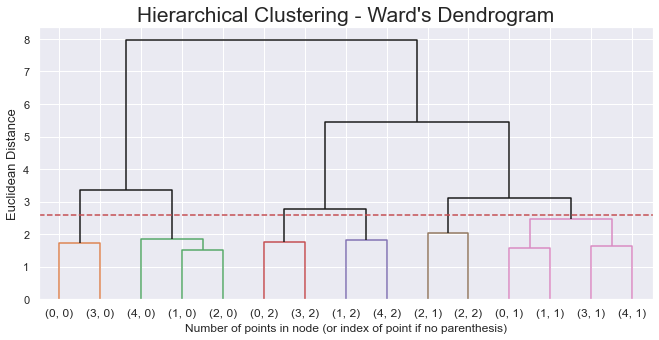

In [498]:
# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 2.6
dendrogram(linkage_matrix, truncate_mode='level', labels=df_centroids.index, p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'Euclidean Distance', fontsize=13)
plt.show()

In [499]:
# Re-running the Hierarchical clustering based on the correct number of clusters
hclust = AgglomerativeClustering(
    linkage='ward', 
    affinity='euclidean', 
    n_clusters=6
)
hclust_labels = hclust.fit_predict(df_centroids)
df_centroids['hclust_labels'] = hclust_labels

df_centroids  # centroid's cluster labels

PolYears  MonthSal    Claims     Motor    Health  \
value_labels product_labels                                                     
0            0              -0.847776  0.074832 -1.280349  1.001929 -0.764556   
             1              -0.828342 -0.076345 -0.745053 -0.316735  0.698455   
             2              -0.818384 -0.610955 -0.999215 -1.222638 -0.107825   
1            0              -0.785449 -0.247622  0.948907  1.082105 -0.841332   
             1              -0.762602 -0.687040  0.689860 -0.432895  0.860263   
             2              -0.821340 -1.173970  0.830284 -1.355752 -0.088894   
2            0              -0.137123  1.031252  0.774418  0.861381 -0.639252   
             1              -0.099787  1.202807  0.454942 -0.426104  0.896879   
             2              -0.162863  1.144894  0.551671 -1.003260  0.068454   
3            0               0.873307  0.112467 -1.287171  1.028750 -0.822221   
             1               0.944347 -0.003148 -0.800368 -0.238255  0.588862   
             2               0.919013 -0.548728 -1.085767 -1.248013 -0.160295   
4            0               1.025945 -0.154085  0.939121  1.053832 -0.839178   
             1               0.955767 -0.620539  0.662944 -0.433049  0.894006   
             2               0.988767 -1.074360  0.740211 -1.297424 -0.112754   

                             Life_sqrt  Work_sqrt  TotalPrem  hclust_labels  
value_labels product_labels                                                  
0            0               -0.658456  -0.688784  -0.576840              3  
             1                0.004653   0.044405  -0.043488              0  
             2                1.127006   1.142504   1.516057              5  
1            0               -0.746465  -0.721639  -0.617174              4  
             1                0.115142   0.128056  -0.130189              0  
             2                1.374630   1.350423   1.257840              2  
2            0               -0.576827  -0.564561  -0.466044              4  
             1                0.103681   0.056053  -0.128858              1  
             2                1.020556   0.977107   1.041439              1  
3            0               -0.690484  -0.654703  -0.568090              3  
             1                0.019825   0.007363  -0.039875              0  
             2                1.120099   1.125776   1.636685              5  
4            0               -0.715781  -0.704275  -0.586876              4  
             1                0.084332   0.117156  -0.163177              0  
             2                1.346768   1.318794   1.260345              2

In [500]:
# Mapper between concatenated clusters and hierarchical clusters
cluster_mapper = df_centroids['hclust_labels'].to_dict()

df_ = df_final.copy()

# Mapping the hierarchical clusters on the centroids to the observations
df_['merged_labels'] = df_.apply(
    lambda row: cluster_mapper[
        (row['value_labels'], row['product_labels'])
    ], axis=1
)

# Merged cluster centroids
df_.groupby('merged_labels').mean()

,PolYears,MonthSal,Claims,Motor,Health,Life_sqrt,Work_sqrt,TotalPrem,value_labels,product_labels
merged_labels,,,,,,,,,,
0,0.048967,-0.358300,-0.022947,-0.358729,0.765373,0.057461,0.076348,-0.095816,1.967337,1.000000
1,-0.111372,1.192170,0.472709,-0.532112,0.744719,0.272087,0.225226,0.086095,2.000000,1.183673
2,0.052859,-1.125863,0.786782,-1.327582,-0.100417,1.361174,1.335148,1.259050,2.448864,2.000000
3,-0.006598,0.093226,-1.283683,1.015038,-0.792740,-0.674109,-0.672127,-0.572563,1.466248,0.000000
4,0.030867,0.146414,0.896185,1.009858,-0.783482,-0.687809,-0.671188,-0.563883,2.331132,0.000000
5,-0.060361,-0.583806,-1.036977,-1.233709,-0.130718,1.123993,1.135206,1.568687,1.308894,2.000000


In [326]:
#Merge cluster contigency table
# Getting size of each final cluster
df_counts = df_.groupby('merged_labels')\
    .size()\
    .to_frame()

# Getting the product and behavior labels
df_counts = df_counts\
    .rename({v:k for k, v in cluster_mapper.items()})\
    .reset_index()

df_counts['value_labels'] = df_counts['merged_labels'].apply(lambda x: x[0])
df_counts['product_labels'] = df_counts['merged_labels'].apply(lambda x: x[1])
df_counts.pivot('value_labels', 'product_labels', 0)

product_labels,0,1,2
value_labels,,,
2,NaN,NaN,1666.0
3,1911.0,NaN,832.0
4,2120.0,2786.0,880.0


In [327]:
# Setting df to have the final product, behavior and merged clusters
df = df_.copy()

## Cluster Analysis

* visualization

In [328]:
def cluster_profiles(df, label_columns, figsize, compar_titles=None):
    """
    Pass df with labels columns of one or multiple clustering labels. 
    Then specify this label columns to perform the cluster profile according to them.
    """
    if compar_titles == None:
        compar_titles = [""]*len(label_columns)
        
    sns.set()
    fig, axes = plt.subplots(nrows=len(label_columns), ncols=2, figsize=figsize, squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compar_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, label, color=sns.color_palette(), ax=ax[0])
        sns.barplot(x=label, y="counts", data=counts, ax=ax[1])

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(text=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=13, fontweight = 'heavy') 
        ax[0].legend(handles, cluster_labels) # Adaptable to number of clusters
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=-20)
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel("")
        ax[1].set_ylabel("Absolute Frequency")
        ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=13)
    
    plt.subplots_adjust(hspace=0.4, top=0.90)
    plt.suptitle("Cluster Simple Profilling", fontsize=23)
    plt.show()

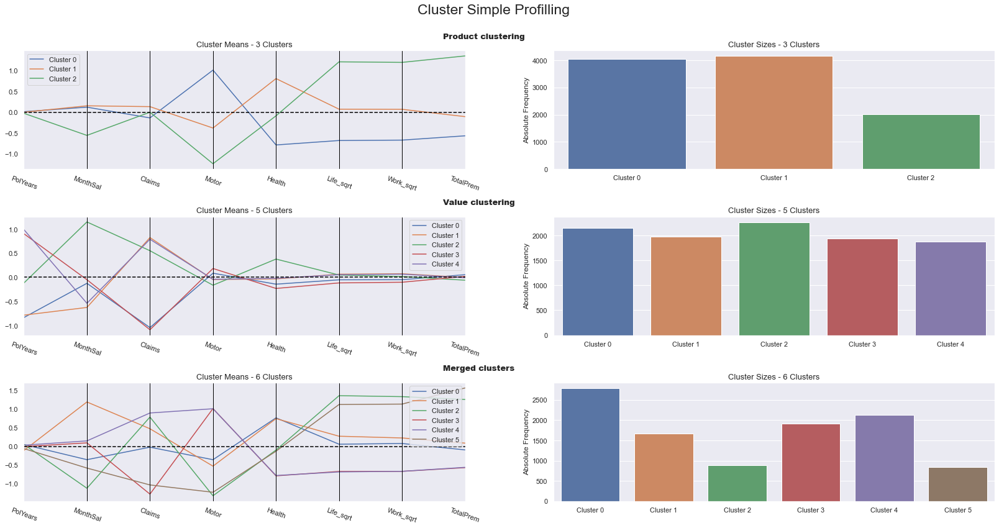

In [329]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df, 
    label_columns = ['product_labels', 'value_labels', 'merged_labels'], 
    figsize = (28, 13), 
    compar_titles = ["Product clustering", "Value clustering", "Merged clusters"]
)

* means of each variable 

In [514]:
#copy = copy.drop(columns = ['Children', 'CMV', 'EducDeg'])
#clustering profilling
copy['merged_labels'] = df_.apply(
    lambda row: cluster_mapper[
        (row['value_labels'], row['product_labels'])
    ], axis=1
)

# Overall level summary 
df_profile_overall = df_final.describe().T

# using mean; use appropriate summarization (median, count, etc.) for each feature
df_profile_overall['Overall Dataset'] = df_profile_overall[['mean']]
df_profile_overall = df_profile_overall[['Overall Dataset']]

# Cluster ID level summary
df_cluster_summary = copy.groupby('merged_labels').describe().T.reset_index()
df_cluster_summary = df_cluster_summary.rename(columns={'level_0':'column','level_1':'metric'})

# using mean; use appropriate summarization (median, count, etc.) for each feature
df_cluster_summary = df_cluster_summary[df_cluster_summary['metric'] == "mean"]
df_cluster_summary = df_cluster_summary.set_index('column')

# join into single summary dataset
df_profile = df_cluster_summary.join(df_profile_overall) # joins on Index

df_profile

,metric,0,1,2,3,4,5,Overall Dataset
column,,,,,,,,
MonthSal,mean,2151.782986,3672.550060,1398.924091,2594.658608,2646.827925,1930.597115,3.904076e-16
Claims,mean,0.672556,0.830408,0.930432,0.271047,0.965274,0.349615,-1.039112e-16
Motor,mean,248.602014,224.789970,115.542100,437.271596,436.560225,128.434394,-1.155961e-16
Health,mean,224.880293,223.350950,160.771695,109.507739,110.193216,158.528043,-8.381939e-17
TotalPrem,mean,735.744055,770.463995,994.336864,644.751036,646.407884,1053.434834,-3.454051e-16
PolYears,mean,30.307251,29.248499,30.332955,29.940345,30.187736,29.585337,1.023975e-16
Life_sqrt,mean,6.444955,7.079357,10.298535,4.282543,4.242049,9.597462,1.490715e-16
Work_sqrt,mean,6.889862,7.306775,10.414953,4.793864,4.796493,9.855044,-1.984027e-16
Household_sqrt,mean,15.449049,16.562399,23.247975,11.477138,11.598813,24.932040,NaN


## Cluster visualization using t-SNE

In [330]:
# This is step can be quite time consuming
two_dim = TSNE(random_state=42).fit_transform(df_[final_features])

C:\Users\carol\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\carol\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


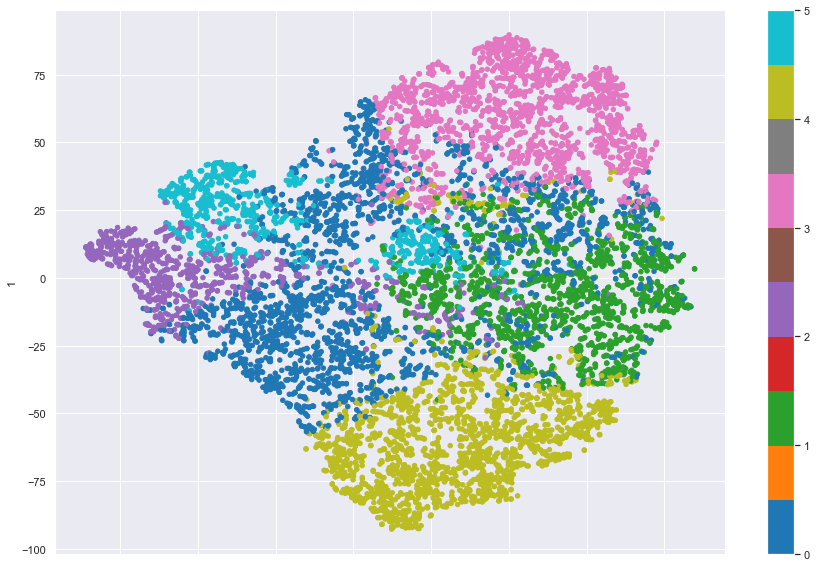

In [161]:
# t-SNE visualization
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=df_['merged_labels'], colormap='tab10', figsize=(15,10))
plt.show()

## Assess feature importance and reclassify outliers

### Using the R²
What proportion of each variables total SS is explained between clusters?

In [162]:
def get_ss_variables(df):
    """Get the SS for each variable
    """
    ss_vars = df.var() * (df.count() - 1)
    return ss_vars

def r2_variables(df, labels):
    """Get the R² for each variable
    """
    sst_vars = get_ss_variables(df)
    ssw_vars = np.sum(df.groupby(labels).apply(get_ss_variables))
    return 1 - ssw_vars/sst_vars

In [163]:
# We are essentially decomposing the R² into the R² for each variable
r2_variables(df_[final_features.to_list() + ['merged_labels']], 'merged_labels').drop('merged_labels')

PolYears     0.003427
MonthSal     0.410650
Claims       0.653737
Motor        0.762968
Health       0.498419
Life_sqrt    0.459583
Work_sqrt    0.447278
TotalPrem    0.468940
dtype: float64

### Using a Decision Tree

In [517]:
# Preparing the data
X = df_.drop(columns=['product_labels','value_labels','merged_labels'])
y = df_.merged_labels

# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Fitting the decision tree
dt = DecisionTreeClassifier(random_state=42, max_depth=3)
dt.fit(X_train, y_train)
print("It is estimated that in average, we are able to predict {0:.2f}% of the customers correctly".format(dt.score(X_test, y_test)*100))

It is estimated that in average, we are able to predict 80.58% of the customers correctly


In [165]:
# Assessing feature importance
pd.Series(dt.feature_importances_, index=X_train.columns)

PolYears     0.000000
MonthSal     0.162660
Claims       0.423482
Motor        0.327533
Health       0.000000
Life_sqrt    0.000000
Work_sqrt    0.000000
TotalPrem    0.086324
dtype: float64

# Deploy

In [18]:
#treatment of data

#read dataset from SAS7BDAT
with SAS7BDAT('a2z_insurance.sas7bdat', skip_header = False) as reader:
    df = reader.to_data_frame()


#give values to the different Education levels to find the empty values.
conditions = [
    (df['EducDeg'] == "1 - Basic"),
    (df['EducDeg'] == "2 - High School"),
    (df['EducDeg'] == "3 - BSc/MSc"),
    (df['EducDeg'] == "4 - PhD")
]

values = ['Basic', 'High_School', 'BSc/MSc', 'PhD']

df['EducDeg'] = np.select(conditions, values)

### Treat Missing Values

#Median
# Creating a copy to apply central tendency measures imputation
df_central = df.copy()

# count of missing values
df_central.isna().sum()

df_central.median(numeric_only=True)
# Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated

df_central.fillna(df_central.median(numeric_only=True), inplace=True)
df_central.isna().sum() 

#Knn
#using knn algorithm to fill missing values

df_neighbors = df.loc[:, df.columns != 'EducDeg']

# KNNImputer - only works for numerical varaibles
imputer = KNNImputer(n_neighbors=5)
df_neighbors = pd.DataFrame(imputer.fit_transform(df_neighbors), columns = df_neighbors.columns)

df_neighbors.isnull().sum()

df_tmv = df_neighbors

df_tmv.shape

## Outliers

### Remove Outliers - Manual filters

#MonthSal

df_tmv[(df_tmv['MonthSal'] > 5667.5)].shape
#2 valores

#CustMonVal 

q25 = df.quantile(.25)
q75 = df.quantile(.75)
iqr = (q75 - q25)

upper_lim = q75 + 1.5 * iqr
lower_lim = q25 - 1.5 * iqr

df_tmv.loc[(df_tmv['CustMonVal'] < lower_lim['CustMonVal']) | (df_tmv['CustMonVal'] > upper_lim['CustMonVal'])].sort_values(by='CustMonVal')

#vamos apagar os valores abaixo de -2082.83 e acima de 2054
#19 valores

df_tmv[(df_tmv['CustMonVal'] <= -2082.83) | (df_tmv['CustMonVal'] >= 2054.07)].sort_values(by='CustMonVal').shape


#ClaimsRate

df_tmv.loc[(df_tmv['ClaimsRate'] < lower_lim['ClaimsRate']) | (df_tmv['ClaimsRate'] > upper_lim['ClaimsRate'])].sort_values(by='ClaimsRate')

df_tmv[(df_tmv['ClaimsRate'] > 35.0)].shape
#4 registos

#PremMotor

df_tmv[(df_tmv['PremMotor'] > 734.865)].shape
#6 valores

#PremHousehold

df_tmv.loc[(df_tmv['PremHousehold'] < lower_lim['PremHousehold']) | (df_tmv['PremHousehold'] > upper_lim['PremHousehold'])].sort_values(by='PremHousehold')

df_tmv[(df_tmv['PremHousehold'] >= 2223.75)].shape
#4 registos

#PremHealth

df_tmv.loc[(df_tmv['PremHealth'] < lower_lim['PremHealth']) | (df_tmv['PremHealth'] > upper_lim['PremHealth'])].sort_values(by='PremHealth')

df_tmv[(df_tmv['PremHealth'] >= 1045.52)].shape
#4 registos

#PremLife

df_tmv.loc[(df_tmv['PremLife'] < lower_lim['PremLife']) | (df_tmv['PremLife'] > upper_lim['PremLife'])].sort_values(by='PremLife')

df_tmv[(df_tmv['PremLife'] >= 284.61)].shape
#19 registos

#PremWork

df_tmv.loc[(df_tmv['PremWork'] < lower_lim['PremWork']) | (df_tmv['PremWork'] > upper_lim['PremWork'])].sort_values(by='PremWork')

df_tmv[(df_tmv['PremWork'] > 298.50)].shape
#17 registos

#we only store the values in the defined limits 

filters1 = (
    (df_tmv['MonthSal']<=5667.5) 
    &
    ((df_tmv['CustMonVal'] > -2082.83) & (df_tmv['CustMonVal'] <= 2054.07))
    &
    (df_tmv['ClaimsRate']<=3.00)
    &
    (df_tmv['PremMotor']<=734.865)
    &
    (df_tmv['PremHousehold']< 2223.75)
    &
    (df_tmv['PremHealth']< 1045.52)
    &
    (df_tmv['PremLife']< 284.61)
    &
    (df_tmv['PremWork'] <= 298.50)
)

df_1 = df_tmv[filters1]

#adicionar a variável EducDeg ao df
EducDeg = df[['CustID','EducDeg']]
EducDeg

df = pd.merge(df_1, EducDeg, on="CustID")

#change the types of variables
df.CustID = df.CustID.astype('int32') 
df.FirstPolYear = df.FirstPolYear.astype('int32')
df.BirthYear = df.BirthYear.astype('int32') 
df.Children = df.Children.astype('int32') 

new_df = df.copy()
new_df = new_df.set_index('CustID')

## Feature Engineering #

### Variables Creation
#Age

### Variables Creation 
# Calculate 'Age'
new_df['Age'] = 2016 - new_df['BirthYear']

#Sum of all Premiums

#total premiums
new_df['TotalPremium'] = new_df.iloc[:,7:12].sum(axis=1)

#Total years as customer for each person

new_df['PolYears'] = 2016 - new_df['FirstPolYear']

#Skewness 

#The square root method is typically used when your data is rightly skewed. 
new_df['PremLife_sqrt'] = np.sqrt(new_df['PremLife'] + abs(new_df['PremLife'].min()))
new_df['PremWork_sqrt'] = np.sqrt(new_df['PremWork'] + abs(new_df['PremWork'].min()))
new_df['PremHousehold_sqrt'] = np.sqrt(new_df['PremHousehold'] + abs(new_df['PremHousehold'].min()))


### Reclassify Variables ##
#change name of the variables
new_df = new_df.rename(columns={'CustMonVal':'CMV', 
                                'ClaimsRate' : 'Claims',
                                'PremMotor':'Motor', 
                                'PremHousehold':'Household', 
                                'PremHealth':'Health',
                                'PremLife':'Life',
                                'PremWork':'Work',
                                'TotalPremium':'TotalPrem',
                                'PremLife_sqrt':'Life_sqrt',
                                'PremWork_sqrt':'Work_sqrt',
                                'PremHousehold_sqrt':'Household_sqrt'
                                
                                
                              })

## Incoherence Checking

#look for some incoherent values
#strange values

new_df.drop(new_df[new_df['FirstPolYear'] == 53784].index,inplace=True)

new_df.drop(new_df[new_df['BirthYear'] == 1028].index,inplace=True)

#Age vs Education

#check if the age make sense with the education level

new_df['EducDeg'].value_counts()

#Education
educ_conditions = [
    (new_df['EducDeg'] == 'Basic'),
    (new_df['EducDeg'] == 'High_School'),
    (new_df['EducDeg'] == 'BSc/MSc'),
    (new_df['EducDeg'] == 'PhD'),
]

educ_values = [10, 15, 18, 23]

new_df['Educ_num'] = np.select(educ_conditions, educ_values)

#replace to NA
new_df['BirthYear'] = new_df.apply(lambda x: None if x.FirstPolYear < x.BirthYear else x.BirthYear, axis=1)

#use knn
df_neighbors_incoherence = new_df.loc[:, new_df.columns != 'EducDeg']

# KNNImputer - only works for numerical varaibles
imputer = KNNImputer(n_neighbors=5)
df_neighbors_incoherence = pd.DataFrame(imputer.fit_transform(df_neighbors_incoherence), columns = df_neighbors_incoherence.columns)

df_neighbors_incoherence.isna().sum()

new_df = df_neighbors_incoherence

#after applying the KNN,there continues to be a lot of values with incoherences so we decided to drop the variable
new_df = new_df.drop(columns=['BirthYear', 'Age'])
new_df = new_df.reset_index()
new_df = new_df.rename(columns={'index':'CustID'})
new_df = pd.merge(new_df, EducDeg, on="CustID")
new_df = new_df.set_index('CustID')

In [19]:
metric_features = ['FirstPolYear','MonthSal','CMV',
                   'Claims','Motor','Household_sqrt',
                  'Health','Life_sqrt','Work_sqrt','TotalPrem','PolYears']

#we decided to drop the following variables because they has high correlations with other created variables.
new_df = new_df.drop(columns=['FirstPolYear', 'Household','Work','Life'])
#não apagar as outras correlacionadas para fazer segmentações

metric_features.remove('FirstPolYear')

### Relevancy
#drop variables that are not usefull for our study.
new_df = new_df.drop(columns=['GeoLivArea','Educ_num'])

## Data Normalization

copy = new_df.copy()

# standardization

#we chose the standardization type of data normalization

df_standard = new_df.copy()

scaler2 = StandardScaler()
scaled_feat2 = scaler2.fit_transform(df_standard[metric_features])
scaled_feat2

df_standard[metric_features] = scaled_feat2
df_standard.head()

# Checking mean and variance of standardized variables
df_standard[metric_features].describe().round(2)

new_df = df_standard.copy()

## One-hot encoding
non_metric_features = ['EducDeg', 'Children']
df_ohc = new_df.copy()

# Use OneHotEncoder to encode the categorical features. Get feature names and create a DataFrame 
# with the one-hot encoded categorical features (pass feature names)
ohc = OneHotEncoder(sparse=False, drop="first")
ohc_feat = ohc.fit_transform(df_ohc[non_metric_features])
ohc_feat_names = ohc.get_feature_names_out()
ohc_df = pd.DataFrame(ohc_feat, index=df_ohc.index, columns=ohc_feat_names) 
ohc_df

# Reassigning df to contain ohc variables
df_ohc = pd.concat([df_ohc.drop(columns=non_metric_features), ohc_df], axis=1)
df_ohc.head()

new_df = df_ohc.copy()

## Rename the one-hot-encoding new variables
rename_ohe_cols = {}

for i in non_metric_features:
    for j in new_df.columns[new_df.columns.str.startswith(i)].to_list() :
        rename_ohe_cols[j] = 'x_' + j

new_df.rename(columns=rename_ohe_cols, inplace=True)


new_df


# Clustering

pc_features = new_df.columns[new_df.columns.str.startswith('PC')]
non_metric_features = new_df.columns[new_df.columns.str.startswith('x')]
metric_features = new_df.columns[~new_df.columns.str.startswith('x') & ~new_df.columns.str.startswith('PC')]

## Create Segmentation
#Segmentation value
value_1 = new_df[['PolYears','MonthSal', 'CMV']]

value_2 = new_df[['PolYears','MonthSal', 'Claims']]

#Segmentation product 
products_1 = new_df[['Motor', 'Health', 'Life_sqrt', 'Work_sqrt', 'Household_sqrt']]

products_2 = new_df[['Motor', 'Health', 'Life_sqrt', 'Work_sqrt', 'TotalPrem']]


## Important functions
#define silhouette

def silhouette(df, labels):
    return silhouette_score(df, labels, metric='euclidean')

#define R^2

def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # Return the sum of squares of each df variable

def r2(df, labels):
    sst = get_ss(df)
    ssw = np.sum(df.groupby(labels).apply(get_ss))
    return 1 - ssw/sst   # Return the r2

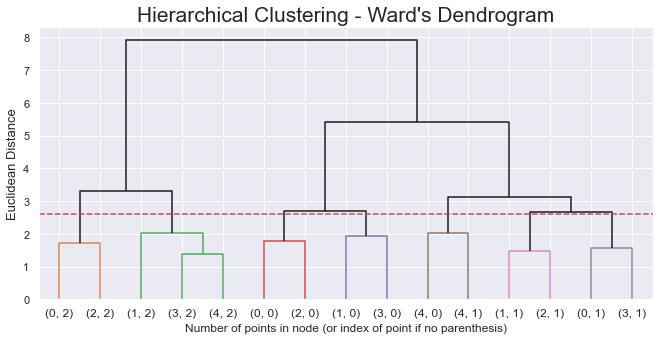

product_labels,0,1,2
value_labels,,,
2,805.0,NaN,1856.0
3,955.0,3013.0,NaN
4,NaN,1412.0,2188.0


In [20]:
#Clustering 
df_value = value_2

df_products = products_2

df_final = pd.concat([df_value, df_products], axis=1)
final_features = df_final.columns
df_final.head(3)

#VALUE 2
# Performing GMM clustering
gmm = GaussianMixture(n_components=5, covariance_type='full', n_init=10, init_params='kmeans', random_state=1)
gmm_labels = gmm.fit_predict(df_value)

#PRODUCT 2
# final cluster solution
number_clusters = 3
kmclust3 = KMeans(n_clusters=number_clusters, init='k-means++', n_init=15, random_state=1)
km_labels3 = kmclust3.fit_predict(df_products)

df_final['value_labels'] = gmm_labels
df_final['product_labels'] = km_labels3

# Count label frequencies (contigency table)
df_final.groupby(['value_labels', 'product_labels'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot('value_labels', 'product_labels', 0)


### Merging using Hierarchical clustering

# Centroids of the concatenated cluster labels
df_centroids = df_final.groupby(['value_labels', 'product_labels']).mean()
df_centroids

# Using Hierarchical clustering to merge the concatenated cluster centroids
hclust = AgglomerativeClustering(
    linkage='ward', 
    affinity='euclidean', 
    distance_threshold=0, 
    n_clusters=None
)
hclust_labels = hclust.fit_predict(df_centroids)

# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html#sphx-glr-auto-examples-cluster-plot-agglomerative-dendrogram-py

# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 2.6
dendrogram(linkage_matrix, truncate_mode='level', labels=df_centroids.index, p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'Euclidean Distance', fontsize=13)
plt.show()

# Re-running the Hierarchical clustering based on the correct number of clusters
hclust = AgglomerativeClustering(
    linkage='ward', 
    affinity='euclidean', 
    n_clusters=6
)
hclust_labels = hclust.fit_predict(df_centroids)
df_centroids['hclust_labels'] = hclust_labels

df_centroids  # centroid's cluster labels

# Mapper between concatenated clusters and hierarchical clusters
cluster_mapper = df_centroids['hclust_labels'].to_dict()

df_ = df_final.copy()

# Mapping the hierarchical clusters on the centroids to the observations
df_['merged_labels'] = df_.apply(
    lambda row: cluster_mapper[
        (row['value_labels'], row['product_labels'])
    ], axis=1
)

# Merged cluster centroids
df_.groupby('merged_labels').mean()

#Merge cluster contigency table
# Getting size of each final cluster
df_counts = df_.groupby('merged_labels')\
    .size()\
    .to_frame()

# Getting the product and behavior labels
df_counts = df_counts\
    .rename({v:k for k, v in cluster_mapper.items()})\
    .reset_index()

df_counts['value_labels'] = df_counts['merged_labels'].apply(lambda x: x[0])
df_counts['product_labels'] = df_counts['merged_labels'].apply(lambda x: x[1])
df_counts.pivot('value_labels', 'product_labels', 0)

